<a href="https://colab.research.google.com/github/jangjung-coding/project_airbnbReviewData_IEQ_analysis/blob/main/Analysis_of_Airbnb_reviews_for_indoor_environmental_quality_evaluation_in_the_United_States.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from ast import literal_eval

pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_columns', None)

In [ ]:
airbnb_df = pd.read_csv('./Desktop/airbnb_df.csv')
print(airbnb_df.shape)

(10548086, 30)


In [ ]:
# str 타입의 'date'열 형식 바꾸기
airbnb_df['date'] = pd.to_datetime(airbnb_df['date'], format='%Y-%m-%d')

In [ ]:
# IEQ Keyword List
thermal_keywords = [
    'ac', 'air conditioner', 'air conditioning', 'aircon', 'boiling', 'chilly', 'clammy', 'climate control',
    'cold', 'cool off', 'draft', 'draughty', 'drafty', 'freezing', 'frostbite', 'heat', 'humid', 'hvac',
    'muggy', 'scorching', 'steamy', 'sticky', 'sweat', 'sweltering', 'temperature', 'thermal comfort',
    'warm', 'warm up'
]

visual_keywords = [
    'artificial light', 'artificial lights', 'artificially lit', 'black out', 'blinding', 'bright', 'bright light',
    'brightness', 'dark', 'dazzle', 'dim', 'dusky', 'few window', 'flicker', 'flickering', 'fluorescent light', 'glare',
    'glary', 'glow', 'indoor light', 'lack of daylight', 'lamp', 'lighting', 'little daylight', 'natural light',
    'no daylight', 'no sun light', 'no sunlight', 'no window', 'poorly lit', 'screen reflections', 'shady',
    'small window', 'visual comfort', 'windowless', 'without light', 'without window'
]

acoustic_keywords = [
    'acoustic', 'acoustic comfort', 'beeping', 'blaring', 'creak', 'earsplitting', 'earpiece', 'earplug', 'echo',
    'heard', 'hear', 'loud', 'loud sound', 'noise', 'noisy', 'overhear', 'quiet', 'racket', 'rattling', 'roaring',
    'rowdy', 'silent', 'sound', 'sound pollution', 'soundproof', 'squeak', 'squeaky', 'vibration'
]


iaq_keywords = [
    'aerate', 'air flow', 'air quality', 'airpurifier', 'airless', 'airtight', 'allergy', 'asthma', 'breeze', 'dingy',
    'dry', 'dry air', 'dust', 'dusty', 'damp', 'feces', 'fresh air', 'hazardous chemicals', 'healthy indoor environment',
    'mold', 'mould', 'musty', 'odour', 'reek', 'rick', 'smell', 'smelly', 'smoke', 'stale', 'stale air', 'stale office',
    'stench', 'stink', 'stuffy', 'stunk', 'unhealthy indoor environment', 'unhealthy space', 'ventilation'
]

category_colors = {
    'Thermal': '#FC642D',
    'IAQ': '#00A699',
    'Visual': '#F4B400',
    'Acoustic': '#4285F4',
}

# 0️⃣ Listing Data와 Review Data 합치기

review.csv와 listin.csv를 불러와 최종 데이터 airbnb_df를 만듬

In [ ]:
zone_1_tokenized = pd.read_csv('/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/IEQ_related_reivew/zone_1_tokenized_sentiment.csv', converters={'comments_tokenized': literal_eval})
zone_2_tokenized = pd.read_csv('/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/IEQ_related_reivew/zone_2_tokenized_sentiment.csv', converters={'comments_tokenized': literal_eval})
zone_3_tokenized = pd.read_csv('/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/IEQ_related_reivew/zone_3_tokenized_sentiment.csv', converters={'comments_tokenized': literal_eval})
zone_4_tokenized = pd.read_csv('/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/IEQ_related_reivew/zone_4_tokenized_sentiment.csv', converters={'comments_tokenized': literal_eval})
zone_5_tokenized = pd.read_csv('/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/IEQ_related_reivew/zone_5_tokenized_sentiment.csv', converters={'comments_tokenized': literal_eval})
zone_6_tokenized = pd.read_csv('/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/IEQ_related_reivew/zone_6_tokenized_sentiment.csv', converters={'comments_tokenized': literal_eval})

In [ ]:
zone_1_tokenized['Zone'] = 1
zone_2_tokenized['Zone'] = 2
zone_3_tokenized['Zone'] = 3
zone_4_tokenized['Zone'] = 4
zone_5_tokenized['Zone'] = 5
zone_6_tokenized['Zone'] = 6

In [ ]:
review_df = pd.concat([zone_1_tokenized, zone_2_tokenized, zone_3_tokenized, zone_4_tokenized, zone_5_tokenized, zone_6_tokenized])
print(review_df.shape)
review_df.head()

In [ ]:
listing_df = pd.read_csv('/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/all_listing.csv')
print(listing_df.shape)
listing_df.head()

In [ ]:
airbnb_df = pd.merge(review_df, listing_df, left_on='listing_id', right_on='id', how='inner') # 숙소를 기준으로 교집합
airbnb_df.drop(columns=['id'], inplace=True)
airbnb_df.rename(columns={'listing_id': 'id'}, inplace=True)
print(airbnb_df.shape)
airbnb_df.head()

In [ ]:
airbnb_df.rename(columns={'Sentiment':'Sentiment_2'}, inplace=True)
airbnb_df['Sentiment_2'] = airbnb_df['Sentiment_2'].apply(lambda x: 1 if x=='POSITIVE' else 0 if x=='NEGATIVE' else 100)
airbnb_df.head()

In [ ]:
airbnb_df = airbnb_df[['Zone', 'City', 'id', 'date', 'comments', 'comments_tokenized',
        'Thermal', 'Visual', 'Acoustic', 'IAQ', 'Sentiment_2', 'Sentiment_0',
        'host_is_superhost', 'host_has_profile_pic', 'host_identity_verified',
        'latitude', 'longitude', 'property_type', 'room_type', 'accommodates',
        'price', 'number_of_reviews', 'number_of_reviews_ltm',
        'first_review', 'last_review',
        'review_scores_rating', 'review_scores_accuracy',
        'review_scores_cleanliness', 'review_scores_checkin',
        'review_scores_communication', 'review_scores_location',
        'review_scores_value']]
airbnb_df.head()

In [ ]:
airbnb_df.isnull().sum()

In [ ]:
airbnb_df.info()

In [ ]:
# airbnb_df.to_csv('/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/airbnb_df.csv', index=False)

# 1️⃣ 리뷰 데이터에서 IEQ 관련 리뷰 데이터는 얼마나 있나?

리뷰 데이터를 활용한 건물 환경 평가 방법의 가능성, 타당성 제시

## 1.1. IEQ 관련 리뷰수 / 전체 리뷰수

In [ ]:
ieq_df = airbnb_df[(airbnb_df['Thermal'] == 1) | (airbnb_df['Visual'] == 1) | (airbnb_df['Acoustic'] == 1) | (airbnb_df['IAQ'] == 1)]
ieq_df = ieq_df.reset_index(drop=True)
print(f'IEQ 관련 리뷰수 / 전처리 후 전체 리뷰수: {(round(ieq_df.shape[0]/airbnb_df.shape[0], 4))*100}%')

IEQ 관련 리뷰수 / 전처리 후 전체 리뷰수: 16.830000000000002%


In [ ]:
print(f'IEQ 관련 리뷰수 / 전처리 전 전체 리뷰수: {(round(ieq_df.shape[0]/11883475, 4))*100}%')

IEQ 관련 리뷰수 / 전처리 전 전체 리뷰수: 14.940000000000001%


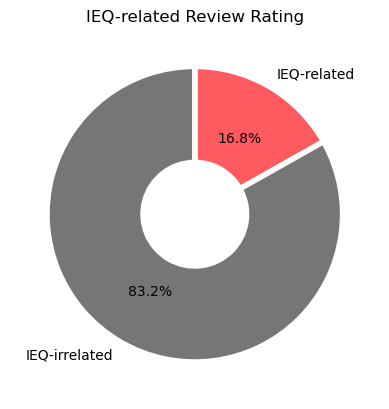

In [ ]:
ieq_ratio = round(ieq_df.shape[0]/airbnb_df.shape[0], 4)

labels = ['IEQ-related', 'IEQ-irrelated']
sizes = [ieq_ratio, 1 - ieq_ratio]
colors = ['#FF5A5F', '#767676']

wedgeprops = {'width': 0.65, 'edgecolor': 'w', 'linewidth': 4}
plt.pie(sizes, labels=labels, textprops={'fontsize': 10},autopct='%1.1f%%', colors=colors, startangle=90, counterclock=False, wedgeprops=wedgeprops)
plt.title('IEQ-related Review Rating')
plt.show()

## 1.2. 카테고리별 IEQ 관련 리뷰수 / 전체 IEQ 리뷰수

In [ ]:
thermal = ieq_df[(ieq_df['Thermal'] == 1) & (ieq_df['IAQ'] == 0) & (ieq_df['Visual'] == 0) & (ieq_df['Acoustic'] == 0)]
iaq = ieq_df[(ieq_df['IAQ'] == 1) & (ieq_df['Thermal'] == 0) & (ieq_df['Visual'] == 0) & (ieq_df['Acoustic'] == 0)]
visual = ieq_df[(ieq_df['Visual'] == 1) & (ieq_df['IAQ'] == 0) & (ieq_df['Thermal'] == 0) & (ieq_df['Acoustic'] == 0)]
acoustic = ieq_df[(ieq_df['Acoustic'] == 1) & (ieq_df['IAQ'] == 0) & (ieq_df['Visual'] == 0) & (ieq_df['Thermal'] == 0)]
print(f'Thermal 관련 리뷰수 / 전체 IEQ 리뷰수: {(round(thermal.shape[0]/ieq_df.shape[0], 4))*100}%')
print(f'IAQ 관련 리뷰수 / 전체 IEQ 리뷰수: {(round(iaq.shape[0]/ieq_df.shape[0], 4))*100}%')
print(f'Visual 관련 리뷰수 / 전체 IEQ 리뷰수: {(round(visual.shape[0]/ieq_df.shape[0], 4))*100}%')
print(f'Acoustic 관련 리뷰수 / 전체 IEQ 리뷰수: {(round(acoustic.shape[0]/ieq_df.shape[0], 4))*100}%')
duplication = (1-(round(thermal.shape[0]/ieq_df.shape[0], 4) + round(iaq.shape[0]/ieq_df.shape[0], 4) + round(visual.shape[0]/ieq_df.shape[0], 4) + round(acoustic.shape[0]/ieq_df.shape[0], 4)))
print(f'중복 리뷰수 / 전체 IEQ 리뷰수: {round(duplication*100, 2)}%')

Thermal 관련 리뷰수 / 전체 IEQ 리뷰수: 12.3%
IAQ 관련 리뷰수 / 전체 IEQ 리뷰수: 6.619999999999999%
Visual 관련 리뷰수 / 전체 IEQ 리뷰수: 4.279999999999999%
Acoustic 관련 리뷰수 / 전체 IEQ 리뷰수: 66.75%
중복 리뷰수 / 전체 IEQ 리뷰수: 10.05%


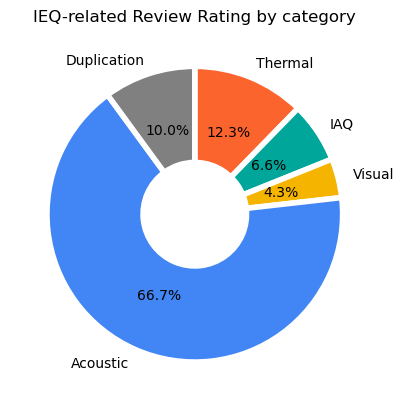

In [ ]:
labels = ['Thermal', 'IAQ', 'Visual', 'Acoustic', 'Duplication']
sizes = [thermal.shape[0]/ieq_df.shape[0], iaq.shape[0]/ieq_df.shape[0], visual.shape[0]/ieq_df.shape[0], acoustic.shape[0]/ieq_df.shape[0], duplication]
colors = ['#FC642D', '#00A699', '#F4B400', '#4285F4', 'gray']

wedgeprops = {'width': 0.65, 'edgecolor': 'w', 'linewidth': 4}
plt.pie(sizes, labels=labels, textprops={'fontsize': 10},autopct='%1.1f%%', colors=colors, startangle=90, counterclock=False, wedgeprops=wedgeprops)
plt.title('IEQ-related Review Rating by category')
plt.show()
plt.show()

/var/folders/mh/3g7gvddj7yd6gl5zy5wg9cgm0000gn/T/ipykernel_23131/630362591.py:3: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_yticklabels(['{:,}'.format(int(x)) for x in plt.gca().get_yticks()])


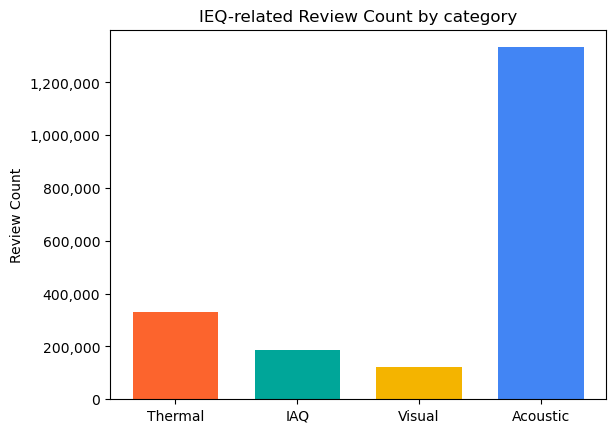

In [ ]:
bar_sizes = [thermal.shape[0], iaq.shape[0], visual.shape[0], acoustic.shape[0]]
plt.bar(labels, bar_sizes, color=colors, width=0.7)
plt.gca().set_yticklabels(['{:,}'.format(int(x)) for x in plt.gca().get_yticks()])
plt.ylabel('Review Count')
plt.title('IEQ-related Review Count by category')
plt.show()

In [ ]:
thermal_iaq = ieq_df[(ieq_df['Thermal'] == 1) & (ieq_df['IAQ'] == 1)]
thermal_visual = ieq_df[(ieq_df['Thermal'] == 1) & (ieq_df['Visual'] == 1)]
thermal_acoustic = ieq_df[(ieq_df['Thermal'] == 1) & (ieq_df['Acoustic'] == 1)]
iaq_visual = ieq_df[(ieq_df['IAQ'] == 1) & (ieq_df['Visual'] == 1)]
iaq_acoustic = ieq_df[(ieq_df['IAQ'] == 1) & (ieq_df['Acoustic'] == 1)]
visual_acoustic = ieq_df[(ieq_df['Visual'] == 1) & (ieq_df['Acoustic'] == 1)]
print(f'Thermal + IAQ 관련 리뷰수 / IEQ 관련 리뷰수: {(round(thermal_iaq.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(f'Thermal + Visual 관련 리뷰수 / IEQ 관련 리뷰수: {(round(thermal_visual.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(f'Thermal + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: {(round(thermal_acoustic.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(f'IAQ + Visual 관련 리뷰수 / IEQ 관련 리뷰수: {(round(iaq_visual.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(f'IAQ + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: {(round(iaq_acoustic.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(f'Visual + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: {(round(visual_acoustic.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')

Thermal + IAQ 관련 리뷰수 / IEQ 관련 리뷰수: 1.66%
Thermal + Visual 관련 리뷰수 / IEQ 관련 리뷰수: 0.72%
Thermal + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: 4.85%
IAQ + Visual 관련 리뷰수 / IEQ 관련 리뷰수: 0.42%
IAQ + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: 2.57%
Visual + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: 1.84%


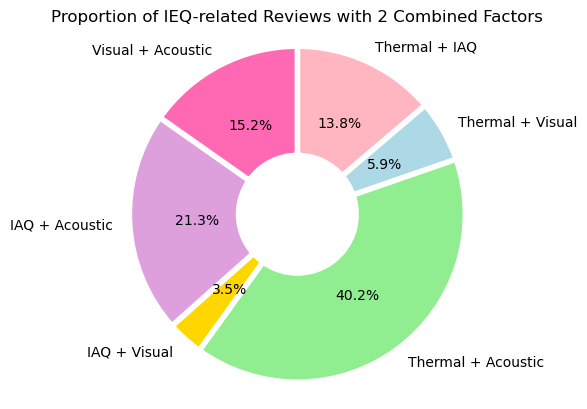

In [ ]:
labels = [
    'Thermal + IAQ',
    'Thermal + Visual',
    'Thermal + Acoustic',
    'IAQ + Visual',
    'IAQ + Acoustic',
    'Visual + Acoustic'
]
sizes = [
    (thermal_iaq.shape[0] / ieq_df.shape[0]) * 100,
    (thermal_visual.shape[0] / ieq_df.shape[0]) * 100,
    (thermal_acoustic.shape[0] / ieq_df.shape[0]) * 100,
    (iaq_visual.shape[0] / ieq_df.shape[0]) * 100,
    (iaq_acoustic.shape[0] / ieq_df.shape[0]) * 100,
    (visual_acoustic.shape[0] / ieq_df.shape[0]) * 100
]
colors = ['#FFB6C1', '#ADD8E6', '#90EE90', '#FFD700', '#DDA0DD', '#FF69B4']

fig, ax = plt.subplots()
plt.pie(sizes, labels=labels, textprops={'fontsize': 10},autopct='%1.1f%%', colors=colors, startangle=90, counterclock=False, wedgeprops=wedgeprops)

ax.axis('equal')

plt.title('Proportion of IEQ-related Reviews with 2 Combined Factors')
plt.show()

In [ ]:
thermal_iaq_visual = airbnb_df[(airbnb_df['Thermal'] == 1) & (airbnb_df['IAQ'] == 1) & (airbnb_df['Visual'] == 1)]
thermal_iaq_acoustic = airbnb_df[(airbnb_df['Thermal'] == 1) & (airbnb_df['IAQ'] == 1) & (airbnb_df['Acoustic'] == 1)]
thermal_visual_acoustic = airbnb_df[(airbnb_df['Thermal'] == 1) & (airbnb_df['Visual'] == 1) & (airbnb_df['Acoustic'] == 1)]
iaq_visual_acoustic = airbnb_df[(airbnb_df['IAQ'] == 1) & (airbnb_df['Visual'] == 1) & (airbnb_df['Acoustic'] == 1)]
print(f'Thermal + IAQ + Visual 관련 리뷰수 / IEQ 관련 리뷰수: {(round(thermal_iaq_visual.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(f'Thermal + IAQ + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: {(round(thermal_iaq_acoustic.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(f'Thermal + Visual + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: {(round(thermal_visual_acoustic.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(f'IAQ + Visual + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: {(round(iaq_visual_acoustic.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')

Thermal + IAQ + Visual 관련 리뷰수 / IEQ 관련 리뷰수: 0.11%
Thermal + IAQ + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: 0.55%
Thermal + Visual + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: 0.26%
IAQ + Visual + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: 0.15%


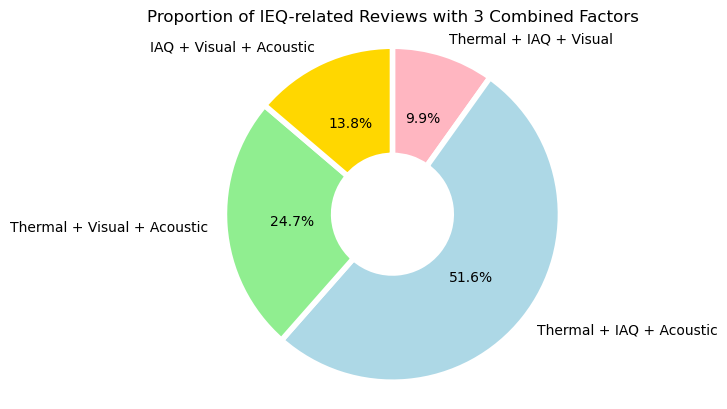

In [ ]:
labels = [
    'Thermal + IAQ + Visual',
    'Thermal + IAQ + Acoustic',
    'Thermal + Visual + Acoustic',
    'IAQ + Visual + Acoustic'
]
sizes = [
    (thermal_iaq_visual.shape[0] / ieq_df.shape[0]) * 100,
    (thermal_iaq_acoustic.shape[0] / ieq_df.shape[0]) * 100,
    (thermal_visual_acoustic.shape[0] / ieq_df.shape[0]) * 100,
    (iaq_visual_acoustic.shape[0] / ieq_df.shape[0]) * 100
]
colors = ['#FFB6C1', '#ADD8E6', '#90EE90', '#FFD700']

fig, ax = plt.subplots()
plt.pie(sizes, labels=labels, textprops={'fontsize': 10},autopct='%1.1f%%', colors=colors, startangle=90, counterclock=False, wedgeprops=wedgeprops)
ax.axis('equal')

plt.title('Proportion of IEQ-related Reviews with 3 Combined Factors')
plt.show()

In [ ]:
tiva = airbnb_df[(airbnb_df['Thermal'] == 1) & (airbnb_df['IAQ'] == 1) & (airbnb_df['Visual'] == 1) & (airbnb_df['Acoustic'] == 1)]
print(f'Thermal + IAQ + Visual + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: {(round(tiva.shape[0]/ieq_df.shape[0], 4))*100:.2f}%')
print(tiva.shape[0],'개')
print(f'예시 리뷰1: {tiva["comments"][1947]}',
      f'\n예시 리뷰2: {tiva["comments"][10547212]}',
      f'\n예시 리뷰3: {tiva["comments"][10528858]}')

Thermal + IAQ + Visual + Acoustic 관련 리뷰수 / IEQ 관련 리뷰수: 0.04%
779 개
예시 리뷰1: An honest review. We wish the best for Fatima’s family business. We’ve spent the last few years traveling the US and staying in many AirBnB’s and hotels so we understand the standard set forth by the industry. For the location/accommodations in Hollywood, we found this place lacking and overpriced. We would have left or addressed the issues with Fatima if anything could have been done during our stay. <br/>--The Good--<br/>  1. The fridge with water & ice in door work great!<br/>  2. A nice large backyard  (though might need bug repellent).<br/>  3. AC works very well.<br/>  4. No bugs in the house.<br/>  5. A nice sized dining table for 6.<br/>--The Meh--<br/>  1. Not as light and bright as pictures - many window blinds & curtains were not working well.<br/>  2. Fridge, closets, and cabinets had the family’s personal items.<br/>  3. Dishwasher stank and there was no detergent to use it.<br/>  4. We had to wash 

# 2️⃣ 공간은(건물 유형, 도시, 기후) IEQ에 무슨 영향이 있을까?

공간에 따른 IEQ 차이 및 원인 분석

## 2.1 기후별 IEQ 관련 리뷰수

In [ ]:
zone_IEQ = []
for zone in airbnb_df['Zone'].unique():
    zone_df = airbnb_df[airbnb_df['Zone'] == zone]
    thermal = len(zone_df[zone_df['Thermal'] == 1])
    visual = len(zone_df[zone_df['Visual'] == 1])
    acoustic = len(zone_df[zone_df['Acoustic'] == 1])
    iaq = len(zone_df[zone_df['IAQ'] == 1])
    total = thermal + visual + acoustic + iaq
    zone_IEQ.append({
        'Zone': zone,
        'Thermal': thermal,
        'Visual': visual,
        'Acoustic': acoustic,
        'IAQ': iaq,
        'total': total,
        'Thermal ratio': thermal/total,
        'Visual ratio': visual/total,
        'Acoustic ratio': acoustic/total,
        'IAQ ratio': iaq/total
    })
    zone_IEQ_df = pd.DataFrame(zone_IEQ)
print(zone_IEQ_df)

   Zone  Thermal  Visual  Acoustic    IAQ   total  Thermal ratio  \
0     1    75110   15268    178175  39654  308207       0.243700   
1     2    47310   14384    191177  25288  278159       0.170083   
2     3    89908   38058    431277  56652  615895       0.145979   
3     4    89125   40192    404739  47459  581515       0.153263   
4     5    22920    9770     98365  13979  145034       0.158032   
5     6     6608    2740     29283   3592   42223       0.156502   

   Visual ratio  Acoustic ratio  IAQ ratio  
0      0.049538        0.578102   0.128660  
1      0.051711        0.687294   0.090912  
2      0.061793        0.700244   0.091983  
3      0.069116        0.696008   0.081613  
4      0.067364        0.678220   0.096384  
5      0.064894        0.693532   0.085072  


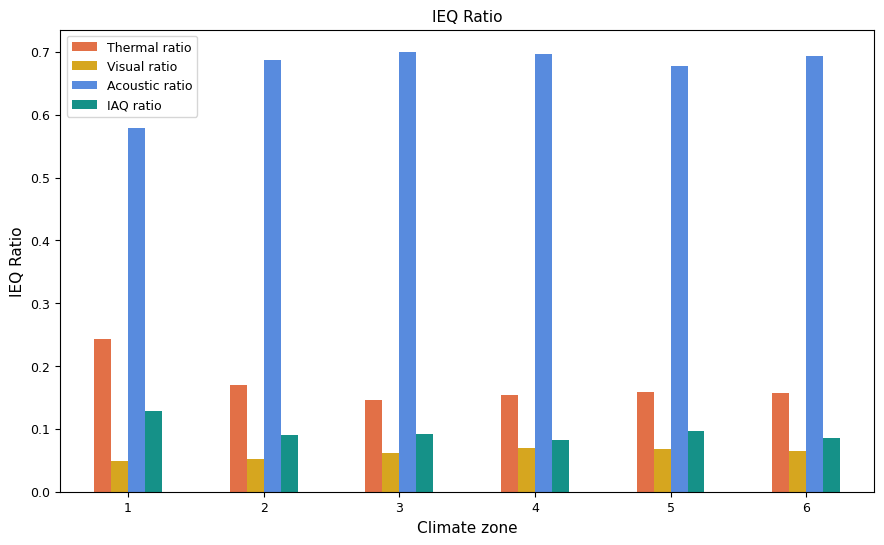

In [ ]:
# 데이터 melt
zone_IEQ_df_melted = zone_IEQ_df.melt(id_vars='Zone',
                                      value_vars=['Thermal ratio', 'Visual ratio', 'Acoustic ratio', 'IAQ ratio'],
                                      var_name='IEQ Type', value_name='Ratio')

# 색상 지정
color_map = {
    'Thermal ratio': '#FC642D',
    'Visual ratio': '#F4B400',
    'Acoustic ratio': '#4285F4',
    'IAQ ratio': '#00A699'
}

# 그래프 생성
plt.figure(figsize=(10.5,6))
sns.barplot(data=zone_IEQ_df_melted, x='Zone', y='Ratio', hue='IEQ Type', palette=color_map, width=0.5)

# 그래프 스타일 설정
plt.title('IEQ Ratio', fontsize=11)
plt.xlabel('Climate zone', fontsize=11)
plt.ylabel('IEQ Ratio', fontsize=11)
plt.xticks(fontsize=9)
plt.yticks(fontsize=9)

# 범례
plt.legend(fontsize=9, title_fontsize=16, loc='upper left')

# 그래프 보여주기
plt.show()

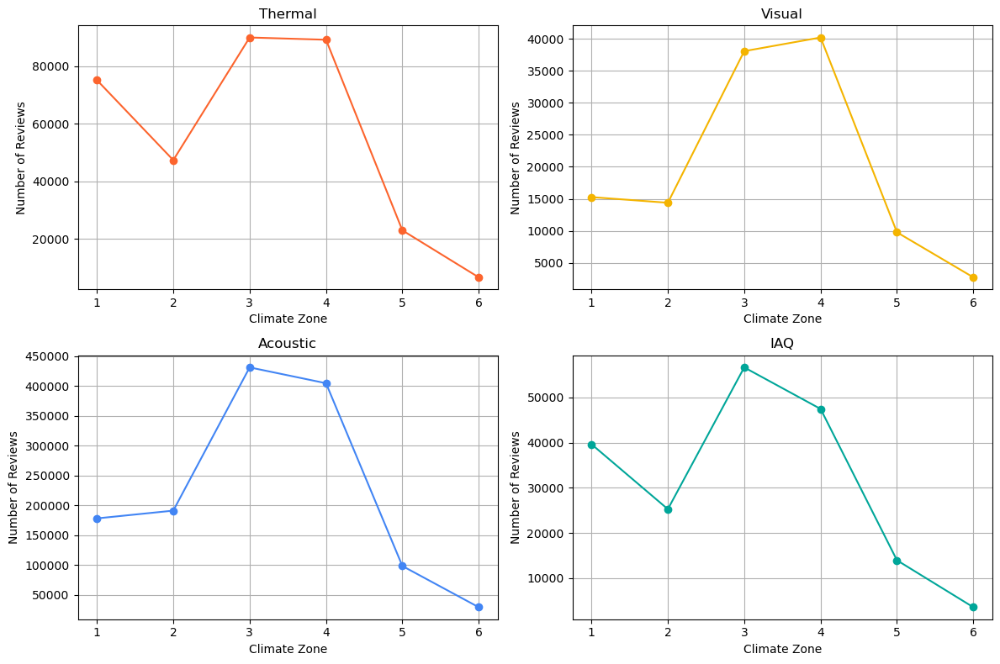

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Thermal
axes[0, 0].plot(zone_IEQ_df['Zone'], zone_IEQ_df['Thermal'], marker='o', color='#FC642D', label='Thermal')
axes[0, 0].set_title('Thermal')
axes[0, 0].set_xlabel('Climate Zone')
axes[0, 0].set_ylabel('Number of Reviews')
axes[0, 0].grid(True)

# Visual
axes[0, 1].plot(zone_IEQ_df['Zone'], zone_IEQ_df['Visual'], marker='o', color='#F4B400', label='Visual')
axes[0, 1].set_title('Visual')
axes[0, 1].set_xlabel('Climate Zone')
axes[0, 1].set_ylabel('Number of Reviews')
axes[0, 1].grid(True)

# Acoustic
axes[1, 0].plot(zone_IEQ_df['Zone'], zone_IEQ_df['Acoustic'], marker='o', color='#4285F4', label='Acoustic')
axes[1, 0].set_title('Acoustic')
axes[1, 0].set_xlabel('Climate Zone')
axes[1, 0].set_ylabel('Number of Reviews')
axes[1, 0].grid(True)

# IAQ
axes[1, 1].plot(zone_IEQ_df['Zone'], zone_IEQ_df['IAQ'], marker='o', color='#00A699', label='IAQ')
axes[1, 1].set_title('IAQ')
axes[1, 1].set_xlabel('Climate Zone')
axes[1, 1].set_ylabel('Number of Reviews')
axes[1, 1].grid(True)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

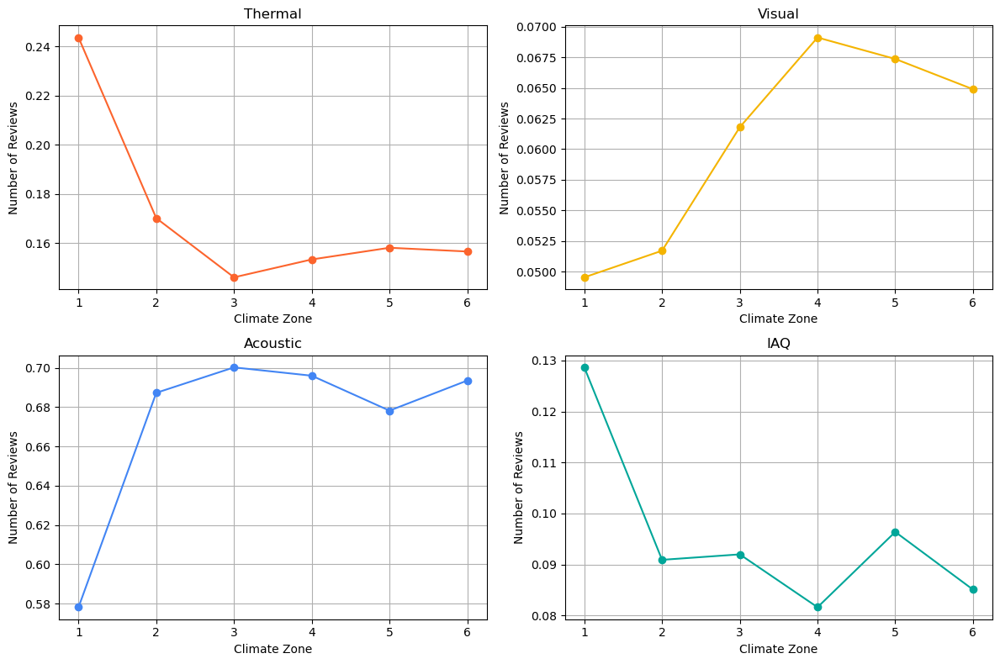

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Thermal
axes[0, 0].plot(zone_IEQ_df['Zone'], zone_IEQ_df['Thermal ratio'], marker='o', color='#FC642D', label='Thermal')
axes[0, 0].set_title('Thermal')
axes[0, 0].set_xlabel('Climate Zone')
axes[0, 0].set_ylabel('Number of Reviews')
axes[0, 0].grid(True)

# Visual
axes[0, 1].plot(zone_IEQ_df['Zone'], zone_IEQ_df['Visual ratio'], marker='o', color='#F4B400', label='Visual')
axes[0, 1].set_title('Visual')
axes[0, 1].set_xlabel('Climate Zone')
axes[0, 1].set_ylabel('Number of Reviews')
axes[0, 1].grid(True)

# Acoustic
axes[1, 0].plot(zone_IEQ_df['Zone'], zone_IEQ_df['Acoustic ratio'], marker='o', color='#4285F4', label='Acoustic')
axes[1, 0].set_title('Acoustic')
axes[1, 0].set_xlabel('Climate Zone')
axes[1, 0].set_ylabel('Number of Reviews')
axes[1, 0].grid(True)

# IAQ
axes[1, 1].plot(zone_IEQ_df['Zone'], zone_IEQ_df['IAQ ratio'], marker='o', color='#00A699', label='IAQ')
axes[1, 1].set_title('IAQ')
axes[1, 1].set_xlabel('Climate Zone')
axes[1, 1].set_ylabel('Number of Reviews')
axes[1, 1].grid(True)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

## 2.2 도시별 IEQ 관련 리뷰수



In [ ]:
city_IEQ_df = []
for city in airbnb_df['City'].unique():
    city_df = airbnb_df[airbnb_df['City'] == city]

    for zone in city_df['Zone'].unique():
        zone_df = city_df[city_df['Zone'] == zone]
        thermal = len(zone_df[zone_df['Thermal'] == 1])
        visual = len(zone_df[zone_df['Visual'] == 1])
        acoustic = len(zone_df[zone_df['Acoustic'] == 1])
        iaq = len(zone_df[zone_df['IAQ'] == 1])
        total = thermal + visual + acoustic + iaq

        city_IEQ_df.append({
            'City': city,
            'Zone': zone,
            'Thermal': thermal,
            'Visual': visual,
            'Acoustic': acoustic,
            'IAQ': iaq,
            'total': total,
            'Thermal ratio': thermal/total,
            'Visual ratio': visual/total,
            'Acoustic ratio': acoustic/total,
            'IAQ ratio': iaq/total
        })

city_IEQ_df = pd.DataFrame(city_IEQ_df)
print(city_IEQ_df)

                                    City  Zone  Thermal  Visual  Acoustic  \
0                Broward County, Florida     1    10734    3342     43815   
1                         Hawaii, Hawaii     1    64376   11926    134360   
2                      Fort Worth, Texas     2     1405     475      7067   
3                          Dallas, Texas     2     4117    1460     16402   
4               Clark County, NV, Nevada     2    13366    2643     52101   
5                          Austin, Texas     2    14970    5114     58452   
6                 New Orleans, Louisiana     2    13452    4692     57155   
7                Los Angeles, California     3    39795   15575    184947   
8                   Nashville, Tennessee     3     9947    4696     64112   
9                    Oakland, California     3     3003    2052     17010   
10                 San Diego, California     3    24427    9563     92276   
11          San Mateo County, California     3     3843    1859     24731   

C:\Users\Suhyun\AppData\Local\Temp\ipykernel_2572\3514582971.py:16: FutureWarning: The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  pivot_table = city_IEQ_df_zone.pivot_table(values=['Thermal', 'Visual', 'Acoustic', 'IAQ'], index='City', aggfunc=sum)
C:\Users\Suhyun\AppData\Local\Temp\ipykernel_2572\3514582971.py:16: FutureWarning: The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  pivot_table = city_IEQ_df_zone.pivot_table(values=['Thermal', 'Visual', 'Acoustic', 'IAQ'], index='City', aggfunc=sum)
C:\Users\Suhyun\AppData\Local\Temp\ipykernel_2572\3514582971.py:16: FutureWarning: The provided callable <built-in function sum> is currently using DataFr

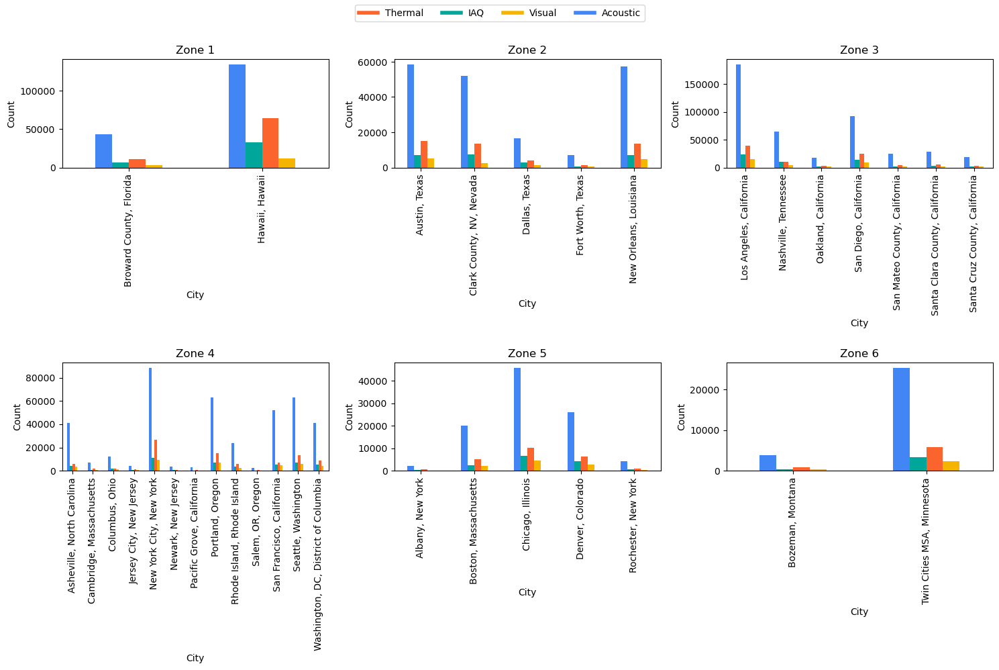

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(15, 10))  # Increase figsize height for better spacing

# Define colors for each category
colors = {
    'Thermal': '#FC642D',
    'IAQ': '#00A699',
    'Visual': '#F4B400',
    'Acoustic': '#4285F4'
}

for i, zone in enumerate(range(1, 7)):
    ax = axes[i // 3, i % 3]
    city_IEQ_df_zone = city_IEQ_df[city_IEQ_df['Zone'] == zone]

    # Create the pivot table and plot it without the legend
    pivot_table = city_IEQ_df_zone.pivot_table(values=['Thermal', 'Visual', 'Acoustic', 'IAQ'], index='City', aggfunc=sum)
    pivot_table.plot(kind='bar', ax=ax, color=[colors[col] for col in pivot_table.columns], legend=False)

    ax.set_title(f'Zone {zone}')
    ax.set_xlabel('City')
    ax.set_ylabel('Count')

# Create a custom legend
handles = [plt.Line2D([0], [0], color=color, lw=4) for color in colors.values()]
labels = colors.keys()
fig.legend(handles, labels, loc='upper center', ncol=len(colors))

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to make space for the legend
plt.subplots_adjust(hspace=1.8)  # Add space between rows

plt.show()

## 2.3 건물 유형별 따른 IEQ 리뷰수

In [ ]:
# room_type 종류 보기
airbnb_df['room_type'].value_counts()

room_type
Entire home/apt    8567002
Private room       1891087
Shared room          51830
Hotel room           38167
Name: count, dtype: int64

In [ ]:
ieq_total = airbnb_df['room_type'].count()
Entire_home_apt_count = len(airbnb_df[airbnb_df['room_type'] == 'Entire home/apt'])
Private_room_count = len(airbnb_df[airbnb_df['room_type'] == 'Private room'])
Shared_room_count = len(airbnb_df[airbnb_df['room_type'] == 'Shared room'])
Hotel_room_count = len(airbnb_df[airbnb_df['room_type'] == 'Hotel room'])
print(f'Entire home/apt / all room type: {(round(Entire_home_apt_count/ieq_total, 4))*100}%') # 81.22%
print(f'Private room / all room type: {(round(Private_room_count/ieq_total, 4))*100}%') # 17.93%
print(f'Shared room / all room type: {(round(Shared_room_count/ieq_total, 4))*100}%') # 0.49%
print(f'Hotel room / all room type: {(round(Hotel_room_count/ieq_total, 4))*100}%') # 0.36%

Entire home/apt / all room type: 81.22%
Private room / all room type: 17.93%
Shared room / all room type: 0.49%
Hotel room / all room type: 0.36%


In [ ]:
# airbnb_df = airbnb_df[airbnb_df['Sentiment_0'] <0]

In [ ]:
# Entire home/apt의 IEQ count
Entire_home_apt_Thermal = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Entire home/apt') & (airbnb_df['Thermal'] == 1)])
Entire_home_apt_Visual = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Entire home/apt') & (airbnb_df['Visual'] == 1)])
Entire_home_apt_Acoustic = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Entire home/apt') & (airbnb_df['Acoustic'] == 1)])
Entire_home_apt_IAQ = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Entire home/apt') & (airbnb_df['IAQ'] == 1)])

# Private room의 IEQ count
Private_room_Thermal = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Private room') & (airbnb_df['Thermal'] == 1)])
Private_room_Visual = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Private room') & (airbnb_df['Visual'] == 1)])
Private_room_Acoustic = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Private room') & (airbnb_df['Acoustic'] == 1)])
Private_room_IAQ = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Private room') & (airbnb_df['IAQ'] == 1)])

# Shared room의 IEQ count
Shared_room_Thermal = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Shared room') & (airbnb_df['Thermal'] == 1)])
Shared_room_Visual = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Shared room') & (airbnb_df['Visual'] == 1)])
Shared_room_Acoustic = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Shared room') & (airbnb_df['Acoustic'] == 1)])
Shared_room_IAQ = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Shared room') & (airbnb_df['IAQ'] == 1)])

# Hotel room의 IEQ count
Hotel_room_Thermal = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Hotel room') & (airbnb_df['Thermal'] == 1)])
Hotel_room_Visual = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Hotel room') & (airbnb_df['Visual'] == 1)])
Hotel_room_Acoustic = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Hotel room') & (airbnb_df['Acoustic'] == 1)])
Hotel_room_IAQ = len(airbnb_df.loc[(airbnb_df['room_type'] == 'Hotel room') & (airbnb_df['IAQ'] == 1)])

# room type 별 합
Entire_home_apt_total = Entire_home_apt_Thermal + Entire_home_apt_Visual + Entire_home_apt_Acoustic + Entire_home_apt_IAQ
Private_room_total = Private_room_Thermal + Private_room_Visual + Private_room_Acoustic + Private_room_IAQ
Shared_room_total = Shared_room_Thermal + Shared_room_Visual + Shared_room_Acoustic + Shared_room_IAQ
Hotel_room_total = Hotel_room_Thermal + Hotel_room_Visual + Hotel_room_Acoustic + Hotel_room_IAQ

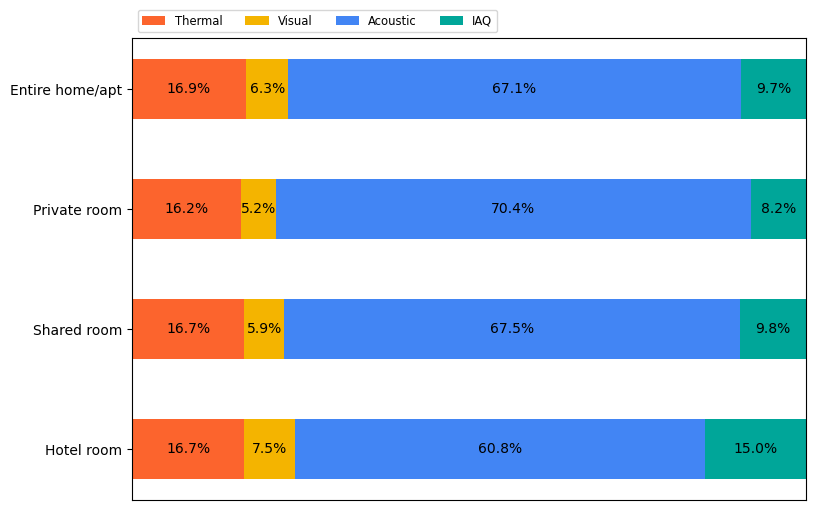

In [ ]:
import matplotlib.colors as mcolors

# Define the custom colors for the categories
category_colors = {
    'Thermal': '#FC642D',
    'Visual': '#F4B400',
    'Acoustic': '#4285F4',
    'IAQ': '#00A699'
}

IEQ_category = ['Thermal', 'Visual', 'Acoustic', 'IAQ']
room_type_IEQ = {
    'Entire home/apt': [Entire_home_apt_Thermal/Entire_home_apt_total, Entire_home_apt_Visual/Entire_home_apt_total, Entire_home_apt_Acoustic/Entire_home_apt_total, Entire_home_apt_IAQ/Entire_home_apt_total],
    'Private room': [Private_room_Thermal/Private_room_total, Private_room_Visual/Private_room_total, Private_room_Acoustic/Private_room_total, Private_room_IAQ/Private_room_total],
    'Shared room': [Shared_room_Thermal/Shared_room_total, Shared_room_Visual/Shared_room_total, Shared_room_Acoustic/Shared_room_total, Shared_room_IAQ/Shared_room_total],
    'Hotel room': [Hotel_room_Thermal/Hotel_room_total, Hotel_room_Visual/Hotel_room_total, Hotel_room_Acoustic/Hotel_room_total, Hotel_room_IAQ/Hotel_room_total]
}

def survey(results, category_names):
    labels = list(results.keys())
    data = np.array(list(results.values()))
    data_cum = data.cumsum(axis=1)

    fig, ax = plt.subplots(figsize=(8.7,6))
    ax.invert_yaxis()
    ax.xaxis.set_visible(False)
    ax.set_xlim(0, np.sum(data, axis=1).max())

    for i, colname in enumerate(category_names):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        color = category_colors[colname]
        rects = ax.barh(labels, widths, left=starts, height=0.5,
                        label=colname, color=color)

        r, g, b = mcolors.to_rgb(color)
        text_color = 'black' if r * g * b < 0.5 else 'darkgrey'
        ax.bar_label(rects, labels=[f'{w*100:.1f}%' for w in widths], label_type='center', color=text_color)
    ax.legend(ncols=len(category_names), bbox_to_anchor=(0, 1),
              loc='lower left', fontsize='small')
    return fig, ax

survey(room_type_IEQ, IEQ_category)
plt.show()

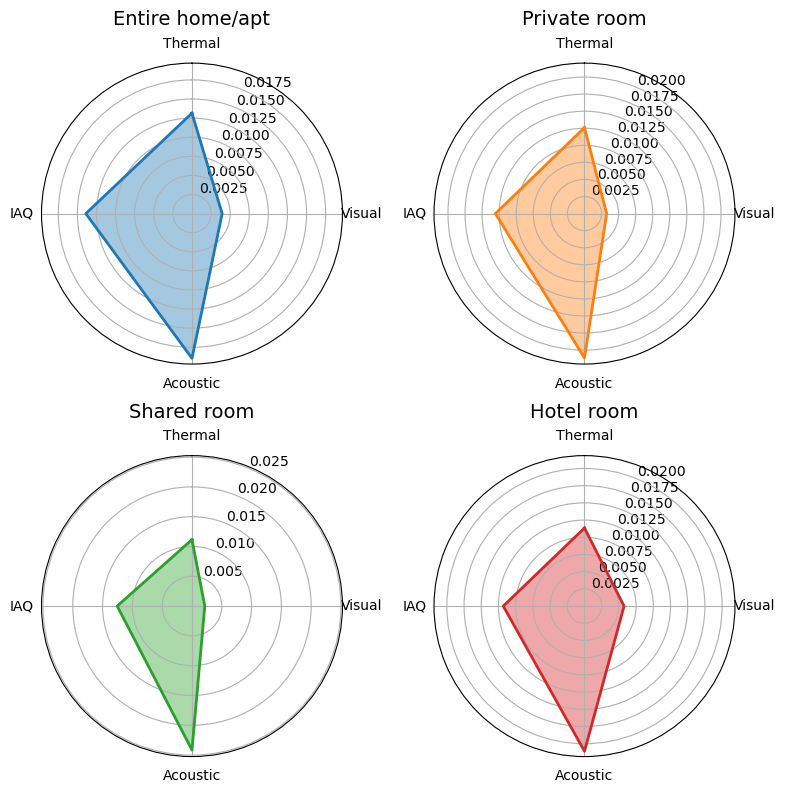

In [ ]:
from math import pi

# Define the custom colors for the categories
category_colors = {
    'Thermal': '#FC642D',
    'Visual': '#F4B400',
    'Acoustic': '#4285F4',
    'IAQ': '#00A699'
}

IEQ_category = ['Thermal', 'Visual', 'Acoustic', 'IAQ']
room_type_IEQ = {
    'Entire home/apt': [0.263, 0.079, 0.379, 0.278],
    'Private room': [0.252, 0.065, 0.423, 0.261],
    'Shared room': [0.223, 0.043, 0.483, 0.251],
    'Hotel room': [0.227, 0.115, 0.422, 0.236]
}

def radar_chart(results, category_names):
    labels = category_names
    num_vars = len(labels)

    fig, axs = plt.subplots(2, 2, figsize=(8,8), subplot_kw=dict(polar=True))
    axs = axs.flatten()

    # Define a list of colors to cycle through
    color_list = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']

    for ax, (room_type, ratios), color in zip(axs, results.items(), color_list):
        # Scale ratios uniformly by 0.05
        ratios = [ratio * 0.05 for ratio in ratios]

        angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
        angles += angles[:1]
        ratios += ratios[:1]

        ax.set_theta_offset(pi / 2)
        ax.set_theta_direction(-1)

        ax.set_thetagrids([i * 360 / num_vars for i in range(num_vars)], labels)

        # Plot radar chart with consistent line width and color
        ax.plot(angles, ratios, color=color, linewidth=2, linestyle='solid')
        ax.fill(angles, ratios, color=color, alpha=0.4)

        ax.set_title(room_type, size=14, color='black', y=1.1)  # Set title color to black

    # Adjust spacing between subplots
    plt.subplots_adjust(hspace=0.3, wspace=0.3)

    plt.tight_layout()
    plt.show()

radar_chart(room_type_IEQ, IEQ_category)

# 3️⃣ 시간은(계절, covid-19) IEQ에 무슨 영향이 있을까?

시간에 따른 IEQ 차이 및 원인 분석

## 3.1. 시간별 IEQ 차이
시간별 IEQ 리뷰 수를 그래프로 시각화하고 차이를 분석한다

### 3.1.1. 시간별 Thermal 리뷰 변화

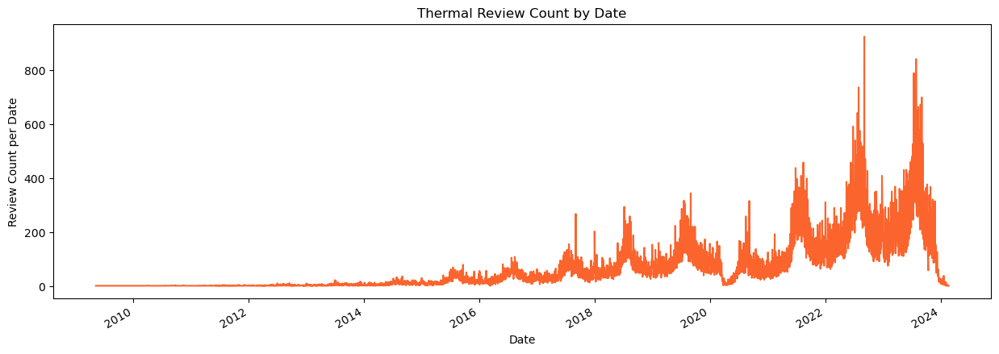

In [ ]:
date_thermal = airbnb_df[airbnb_df['Thermal'] == 1].groupby('date')['Thermal'].value_counts().unstack()
date_thermal.plot(figsize=(15, 5), title='Thermal Review Count by Date', color='#FC642D').get_legend().remove()
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.show()

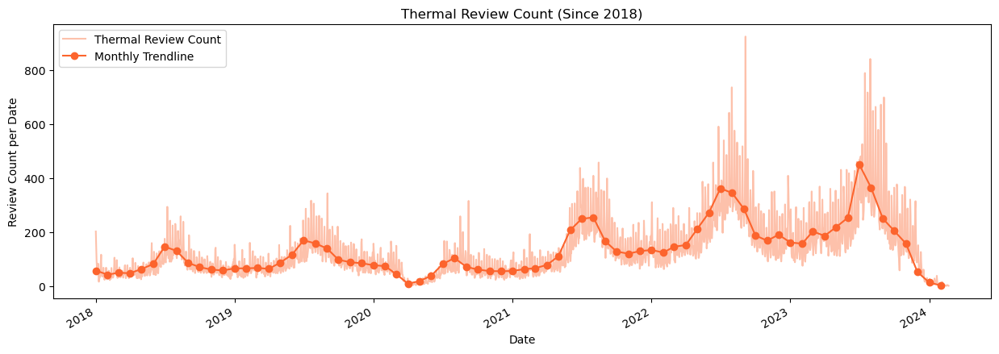

In [ ]:
# 2018년 이후 데이터만 보기
airbnb_df_2018 = airbnb_df[airbnb_df['date'] >= '2018-01-01']
date_thermal = airbnb_df_2018[airbnb_df_2018['Thermal'] == 1]
monthly_thermal_count = date_thermal.groupby(date_thermal['date'].dt.to_period('M')).size()
monthly_avg_thermal = monthly_thermal_count.groupby(monthly_thermal_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
date_thermal.groupby('date').size().plot(color='#FC642D', alpha = 0.4, label='Thermal Review Count')
monthly_avg_thermal.plot(color='#FC642D', marker='o', linestyle='-', label='Monthly Trendline')

plt.title('Thermal Review Count (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

<ipython-input-51-dbdb25bbbbb6>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  date_thermal = airbnb_df_2022[airbnb_df_2018['Thermal'] == 1]


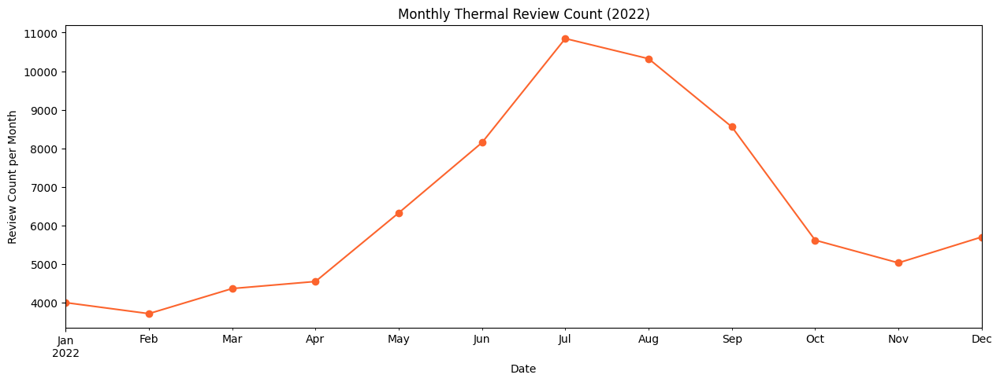

In [ ]:
# 2022년 데이터만 보기
airbnb_df_2022 = airbnb_df[airbnb_df['date'].dt.year == 2022]
date_thermal = airbnb_df_2022[airbnb_df_2018['Thermal'] == 1]
monthly_thermal_count = date_thermal.groupby(date_thermal['date'].dt.to_period('M')).size()
monthly_avg_thermal = monthly_thermal_count.groupby(monthly_thermal_count.index.to_timestamp()).mean()

plt.figure(figsize=(15, 5))
monthly_avg_thermal.plot(color='#FC642D', marker='o', linestyle='-', label='Monthly Average Thermal Review Count')

plt.title('Monthly Thermal Review Count (2022)')
plt.xlabel('Date')
plt.ylabel('Review Count per Month')
plt.show()

<ipython-input-52-bc4da41e4b9f>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  date_thermal = airbnb_df_2023[airbnb_df_2018['Thermal'] == 1]


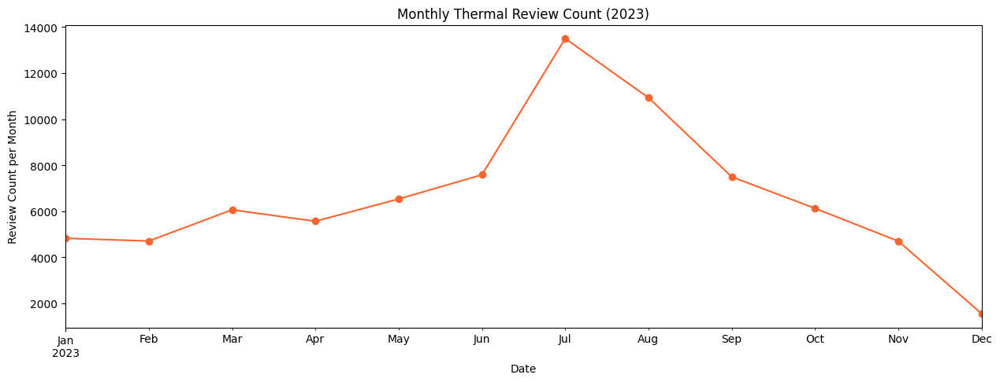

In [ ]:
# 2023년 데이터만 보기
airbnb_df_2023 = airbnb_df[airbnb_df['date'].dt.year == 2023]
date_thermal = airbnb_df_2023[airbnb_df_2018['Thermal'] == 1]
monthly_thermal_count = date_thermal.groupby(date_thermal['date'].dt.to_period('M')).size()
monthly_avg_thermal = monthly_thermal_count.groupby(monthly_thermal_count.index.to_timestamp()).mean()

plt.figure(figsize=(15, 5))
monthly_avg_thermal.plot(color='#FC642D', marker='o', linestyle='-', label='Monthly Average Thermal Review Count')

plt.title('Monthly Thermal Review Count (2023)')
plt.xlabel('Date')
plt.ylabel('Review Count per Month')
plt.show()

### 3.1.2. 시간별 IAQ 리뷰 변화

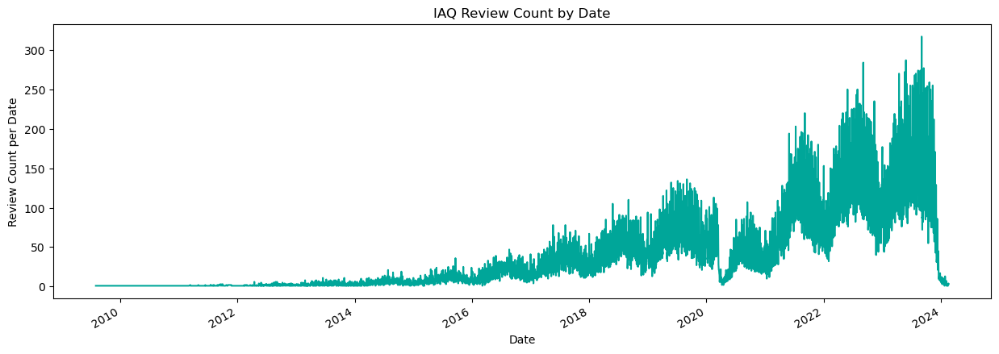

In [ ]:
date_IAQ = airbnb_df[airbnb_df['IAQ'] == 1].groupby('date')['IAQ'].value_counts().unstack()
date_IAQ.plot(figsize=(15, 5), title='IAQ Review Count by Date', color='#00A699').get_legend().remove()
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.show()

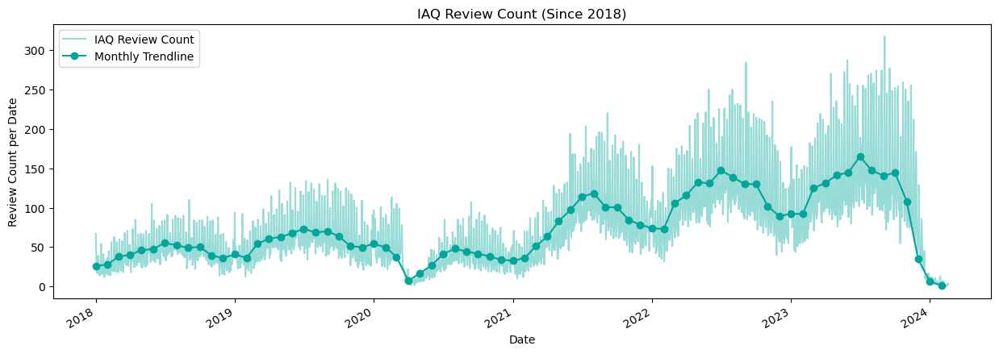

In [ ]:
# 2018년 이후 데이터만 보기
date_IAQ = airbnb_df_2018[airbnb_df_2018['IAQ'] == 1]
monthly_iaq_count = date_IAQ.groupby(date_IAQ['date'].dt.to_period('M')).size()
monthly_avg_iaq = monthly_iaq_count.groupby(monthly_iaq_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
date_IAQ.groupby('date').size().plot(color='#00A699', alpha = 0.4, label='IAQ Review Count')
monthly_avg_iaq.plot(color='#00A699', marker='o', linestyle='-', label='Monthly Trendline')

plt.title('IAQ Review Count (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

<ipython-input-55-552dc23abf94>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  date_IAQ = airbnb_df_2022[airbnb_df_2018['IAQ'] == 1]


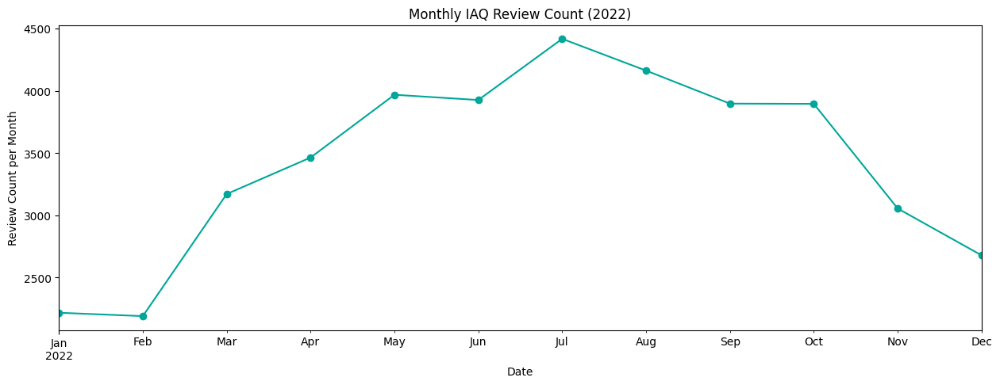

In [ ]:
# 2022년 데이터만 보기
airbnb_df_2022 = airbnb_df[airbnb_df['date'].dt.year == 2022]
date_IAQ = airbnb_df_2022[airbnb_df_2018['IAQ'] == 1]
monthly_iaq_count = date_IAQ.groupby(date_IAQ['date'].dt.to_period('M')).size()
monthly_avg_iaq = monthly_iaq_count.groupby(monthly_iaq_count.index.to_timestamp()).mean()

plt.figure(figsize=(15, 5))
monthly_avg_iaq.plot(color='#00A699', marker='o', linestyle='-', label='Monthly Average IAQ Review Count')

plt.title('Monthly IAQ Review Count (2022)')
plt.xlabel('Date')
plt.ylabel('Review Count per Month')
plt.show()

<ipython-input-56-b98ec6d352ec>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  date_IAQ = airbnb_df_2023[airbnb_df_2018['IAQ'] == 1]


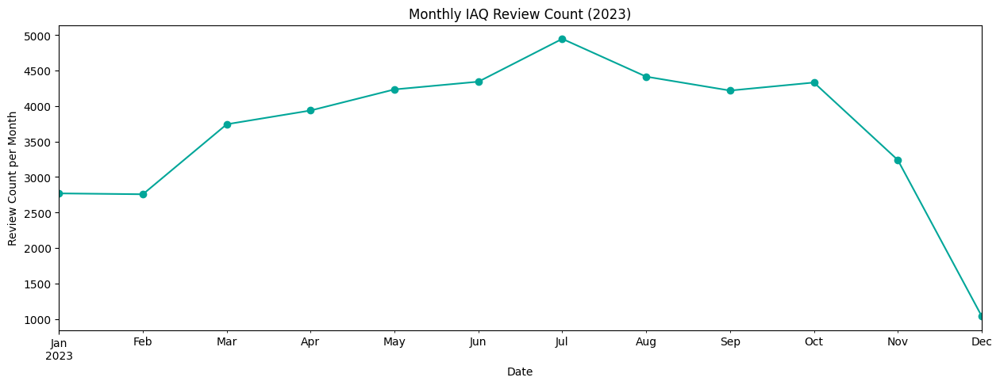

In [ ]:
# 2023년 데이터만 보기
airbnb_df_2023 = airbnb_df[airbnb_df['date'].dt.year == 2023]
date_IAQ = airbnb_df_2023[airbnb_df_2018['IAQ'] == 1]
monthly_iaq_count = date_IAQ.groupby(date_IAQ['date'].dt.to_period('M')).size()
monthly_avg_iaq = monthly_iaq_count.groupby(monthly_iaq_count.index.to_timestamp()).mean()

plt.figure(figsize=(15, 5))
monthly_avg_iaq.plot(color='#00A699', marker='o', linestyle='-', label='Monthly Average IAQ Review Count')

plt.title('Monthly IAQ Review Count (2023)')
plt.xlabel('Date')
plt.ylabel('Review Count per Month')
plt.show()

### 3.1.3. 시간별 Visual 리뷰 변화

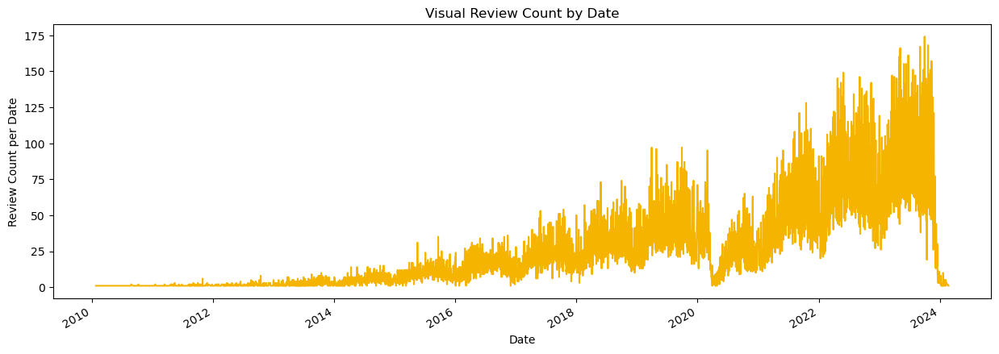

In [ ]:
date_Visual = airbnb_df[airbnb_df['Visual'] == 1].groupby('date')['Visual'].value_counts().unstack()
date_Visual.plot(figsize=(15, 5), title='Visual Review Count by Date', color='#F4B400').get_legend().remove()
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.show()

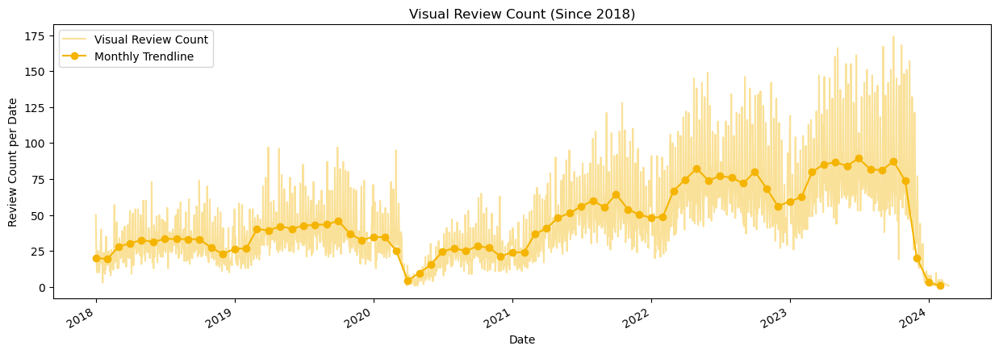

In [ ]:
# 2018년 이후 데이터만 보기
date_Visual = airbnb_df_2018[airbnb_df_2018['Visual'] == 1]
monthly_visual_count = date_Visual.groupby(date_Visual['date'].dt.to_period('M')).size()
monthly_avg_visual = monthly_visual_count.groupby(monthly_visual_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
date_Visual.groupby('date').size().plot(color='#F4B400', alpha = 0.4, label='Visual Review Count')
monthly_avg_visual.plot(color='#F4B400', marker='o', linestyle='-', label='Monthly Trendline')

plt.title('Visual Review Count (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

<ipython-input-59-f5ff6e1aaa5c>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  date_Visual = airbnb_df_2022[airbnb_df_2018['Visual'] == 1]


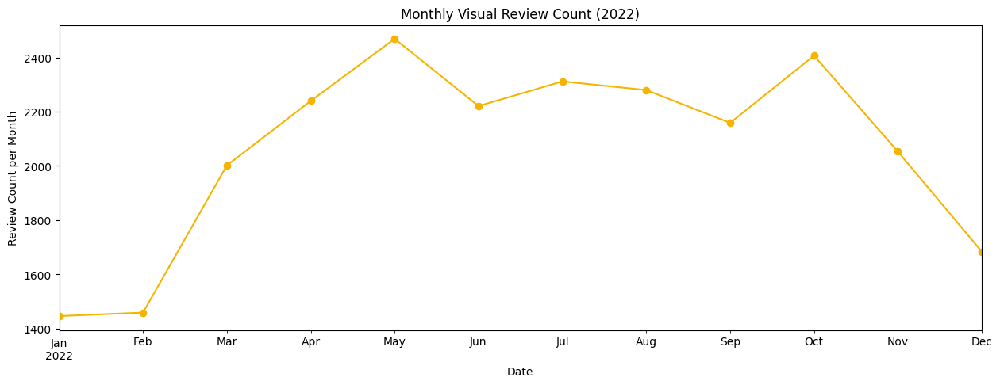

In [ ]:
# 2022년 데이터만 보기
airbnb_df_2022 = airbnb_df[airbnb_df['date'].dt.year == 2022]
date_Visual = airbnb_df_2022[airbnb_df_2018['Visual'] == 1]
monthly_visual_count = date_Visual.groupby(date_Visual['date'].dt.to_period('M')).size()
monthly_avg_visual = monthly_visual_count.groupby(monthly_visual_count.index.to_timestamp()).mean()

plt.figure(figsize=(15, 5))
monthly_avg_visual.plot(color='#F4B400', marker='o', linestyle='-', label='Monthly Average Visual Review Count')

plt.title('Monthly Visual Review Count (2022)')
plt.xlabel('Date')
plt.ylabel('Review Count per Month')
plt.show()

<ipython-input-60-0a6896acb063>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  date_Visual = airbnb_df_2023[airbnb_df_2018['Visual'] == 1]


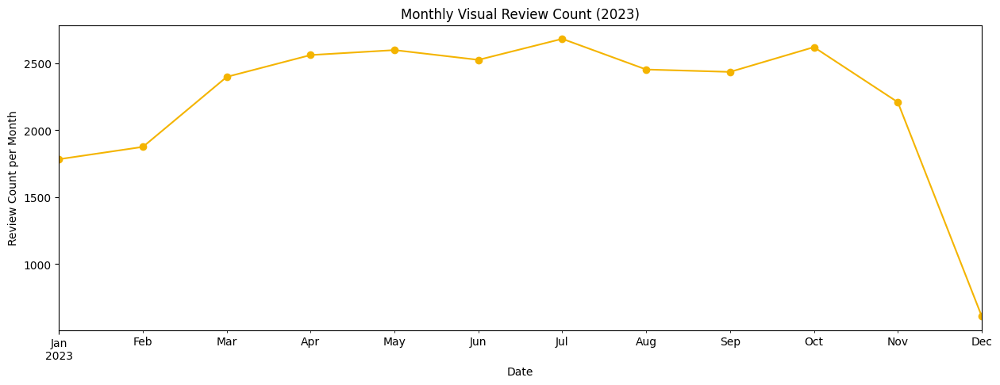

In [ ]:
# 2023년 데이터만 보기
airbnb_df_2023 = airbnb_df[airbnb_df['date'].dt.year == 2023]
date_Visual = airbnb_df_2023[airbnb_df_2018['Visual'] == 1]
monthly_visual_count = date_Visual.groupby(date_Visual['date'].dt.to_period('M')).size()
monthly_avg_visual = monthly_visual_count.groupby(monthly_visual_count.index.to_timestamp()).mean()

plt.figure(figsize=(15, 5))
monthly_avg_visual.plot(color='#F4B400', marker='o', linestyle='-', label='Monthly Average Visual Review Count')

plt.title('Monthly Visual Review Count (2023)')
plt.xlabel('Date')
plt.ylabel('Review Count per Month')
plt.show()

### 3.1.4. 시간별 Acoustic 리뷰 변화

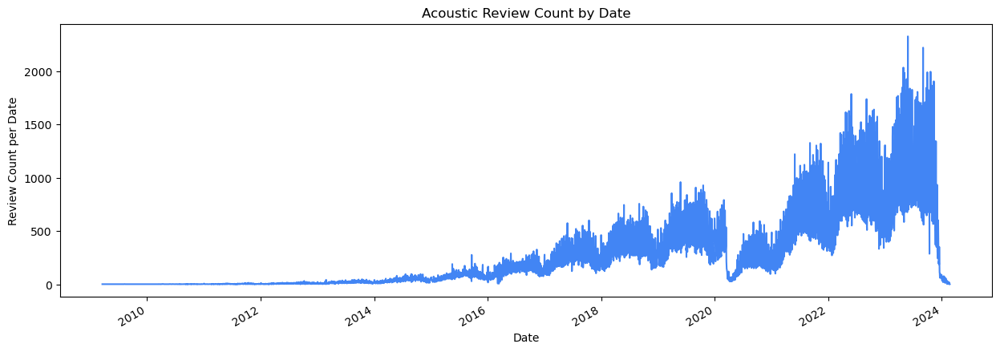

In [ ]:
date_Acoustic = airbnb_df[airbnb_df['Acoustic'] == 1].groupby('date')['Acoustic'].value_counts().unstack()
date_Acoustic.plot(figsize=(15, 5), title='Acoustic Review Count by Date', color='#4285F4').get_legend().remove()
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.show()

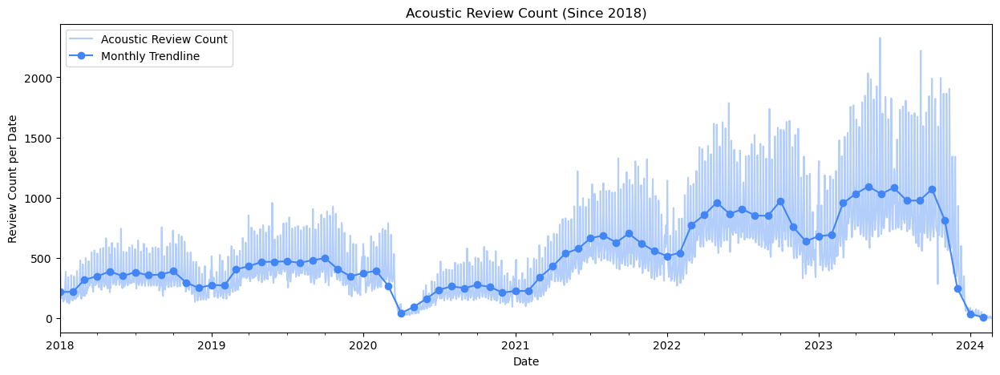

In [ ]:
# 2018년 이후 데이터만 보기
date_Acoustic = airbnb_df_2018[airbnb_df_2018['Acoustic'] == 1]
monthly_acoustic_count = date_Acoustic.groupby(date_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_acoustic = monthly_acoustic_count.groupby(monthly_acoustic_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
date_Acoustic.groupby('date').size().plot(color='#4285F4', alpha = 0.4, label='Acoustic Review Count')
monthly_avg_acoustic.plot(color='#4285F4', marker='o', linestyle='-', label='Monthly Trendline')

plt.title('Acoustic Review Count (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

<ipython-input-63-01711692c7f0>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  date_Acoustic = airbnb_df_2022[airbnb_df_2018['Acoustic'] == 1]


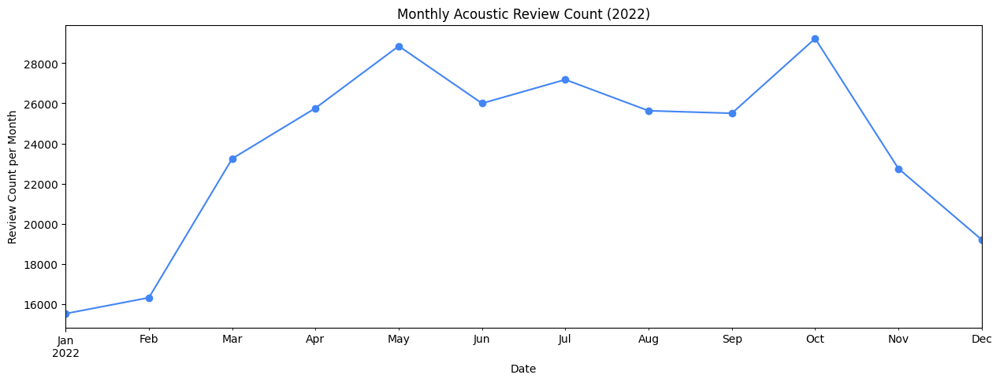

In [ ]:
# 2022년 데이터만 보기
airbnb_df_2022 = airbnb_df[airbnb_df['date'].dt.year == 2022]
date_Acoustic = airbnb_df_2022[airbnb_df_2018['Acoustic'] == 1]
monthly_acoustic_count = date_Acoustic.groupby(date_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_acoustic = monthly_acoustic_count.groupby(monthly_acoustic_count.index.to_timestamp()).mean()

plt.figure(figsize=(15, 5))
monthly_avg_acoustic.plot(color='#4285F4', marker='o', linestyle='-', label='Monthly Average Acoustic Review Count')

plt.title('Monthly Acoustic Review Count (2022)')
plt.xlabel('Date')
plt.ylabel('Review Count per Month')
plt.show()

<ipython-input-64-6e659589772f>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  date_Acoustic = airbnb_df_2023[airbnb_df_2018['Acoustic'] == 1]


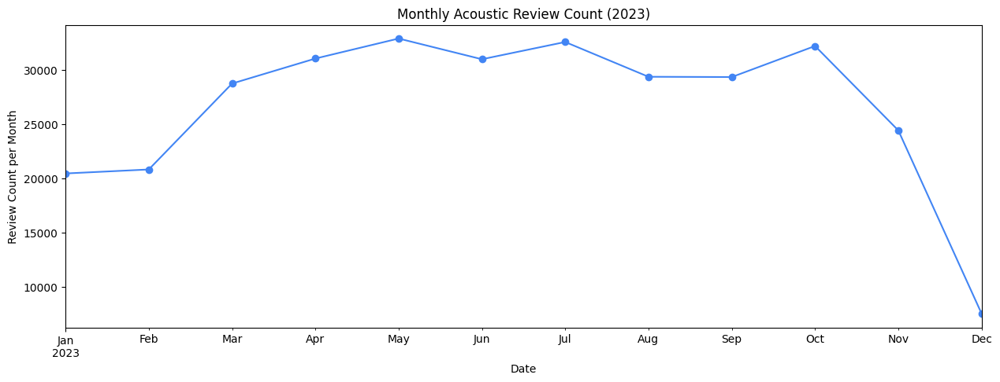

In [ ]:
# 2023년 데이터만 보기
airbnb_df_2023 = airbnb_df[airbnb_df['date'].dt.year == 2023]
date_Acoustic = airbnb_df_2023[airbnb_df_2018['Acoustic'] == 1]
monthly_acoustic_count = date_Acoustic.groupby(date_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_acoustic = monthly_acoustic_count.groupby(monthly_acoustic_count.index.to_timestamp()).mean()

plt.figure(figsize=(15, 5))
monthly_avg_acoustic.plot(color='#4285F4', marker='o', linestyle='-', label='Monthly Average Acoustic Review Count')

plt.title('Monthly Acoustic Review Count (2023)')
plt.xlabel('Date')
plt.ylabel('Review Count per Month')
plt.show()

### 3.1.5. 시간별 IEQ 리뷰 변화

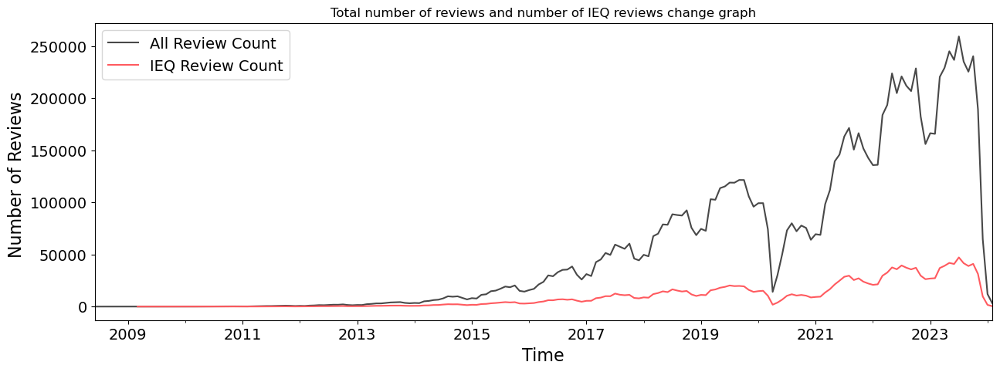

In [ ]:
# 전체 리뷰수, IEQ 리뷰수, 숙소 변화량 그래프
monthly_reviews = airbnb_df.groupby(airbnb_df['date'].dt.to_period('M')).size()
monthly_ieq_reviews = ieq_df.groupby(ieq_df['date'].dt.to_period('M')).size()
monthly_unique_listings = airbnb_df.groupby(airbnb_df['date'].dt.to_period('M'))['id'].nunique()

monthly_reviews.plot(figsize=(15, 5), title='All Review Count', color='#484848', label='All Review Count')
monthly_ieq_reviews.plot(figsize=(15, 5), title='IEQ_Review Count', color='#FF5A5F', label='IEQ Review Count')
# monthly_unique_listings.plot(figsize=(15, 5), title='Number of accommodations', color='#4682B4', style='--' ,label='Number of accommodations')

plt.title('Total number of reviews and number of IEQ reviews change graph')
plt.xlabel('Time', fontsize=16)
plt.ylabel('Number of Reviews ', fontsize=16)
plt.legend(fontsize = 14)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.show() # 숙소 수가 늘어나며 리뷰수도 증가하고 있고 IEQ 리뷰도 증가 하고 있다

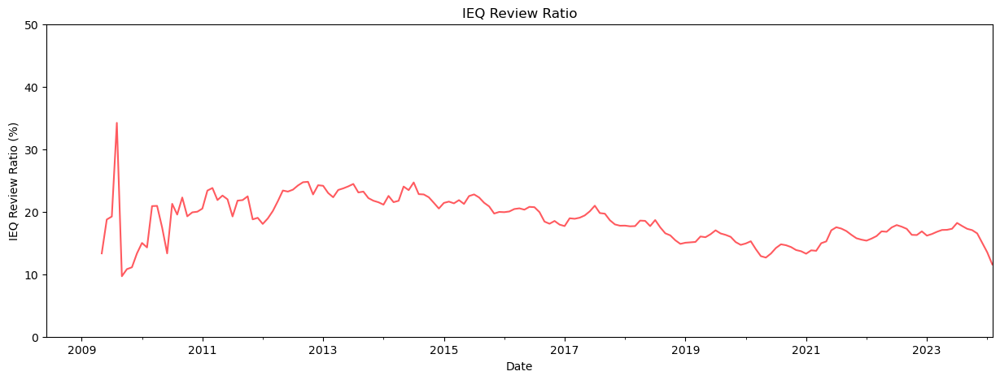

In [ ]:
# 전체 리뷰에 대한 IEQ리뷰 수의 비율 변화 -> 지속적으로 15~20% 유지하고 있음
ieq_reviews_per_day = ieq_df.groupby('date').size() / airbnb_df.groupby('date').size() * 100
monthly_ieq_ratio = (ieq_df.groupby(ieq_df['date'].dt.to_period('M')).size() / airbnb_df.groupby(airbnb_df['date'].dt.to_period('M')).size()) * 100

monthly_ieq_ratio.plot(figsize=(15, 5), title='IEQ Review Ratio by Month', color='#FF5A5F')

plt.ylim(0, 50)
plt.title('IEQ Review Ratio')
plt.xlabel('Date')
plt.ylabel('IEQ Review Ratio (%)')
plt.show() # IEQ관련 리뷰는 조금씩 감소하고 있다

In [ ]:
non_ieq_df = airbnb_df[(airbnb_df['Thermal'] == 0) & (airbnb_df['Visual'] == 0) & (airbnb_df['Acoustic'] == 0) & (airbnb_df['IAQ'] == 0)]
print(non_ieq_df.shape)

(8772824, 30)


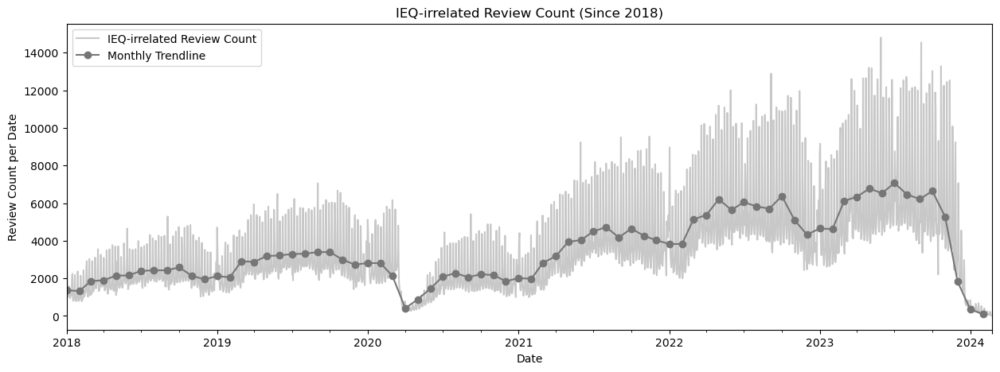

In [ ]:
non_ieq_df_2018 = non_ieq_df[non_ieq_df['date'] >= '2018-01-01']
non_ieq_df_2018_count = non_ieq_df_2018.groupby(non_ieq_df_2018['date'].dt.to_period('M')).size()
monthly_avg_non_ieq_df = non_ieq_df_2018_count.groupby(non_ieq_df_2018_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
non_ieq_df_2018.groupby('date').size().plot(color='#767676', alpha = 0.4, label='IEQ-irrelated Review Count')
monthly_avg_non_ieq_df.plot(color='#767676', marker='o', linestyle='-', label='Monthly Trendline')

plt.title('IEQ-irrelated Review Count (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

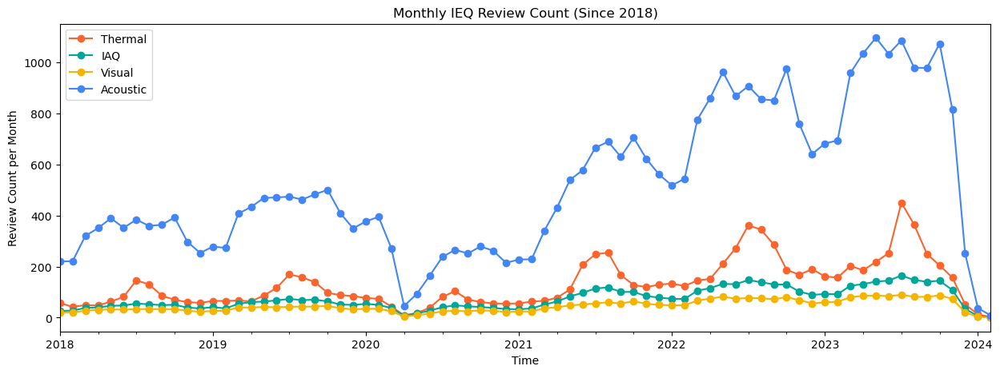

In [ ]:
plt.figure(figsize=(15, 5))
monthly_avg_thermal.plot(color='#FC642D', marker='o', linestyle='-', label='Thermal')
monthly_avg_iaq.plot(color='#00A699', marker='o', linestyle='-', label='IAQ')
monthly_avg_visual.plot(color='#F4B400', marker='o', linestyle='-', label='Visual')
monthly_avg_acoustic.plot(color='#4285F4', marker='o', linestyle='-', label='Acoustic')

plt.title('Monthly IEQ Review Count (Since 2018)')
plt.xlabel('Time')
plt.ylabel('Review Count per Month')
plt.legend()
plt.show()
# 두 가지 사실을 알 수 있음
# 1. IEQ 관련 리뷰 수는 꾸준히 증가
# 2. Thermal 관련 리뷰 수가 계절별 가장 눈에 띄는 주기성을 가짐(=계절에 영향을 가장 많이 받음)

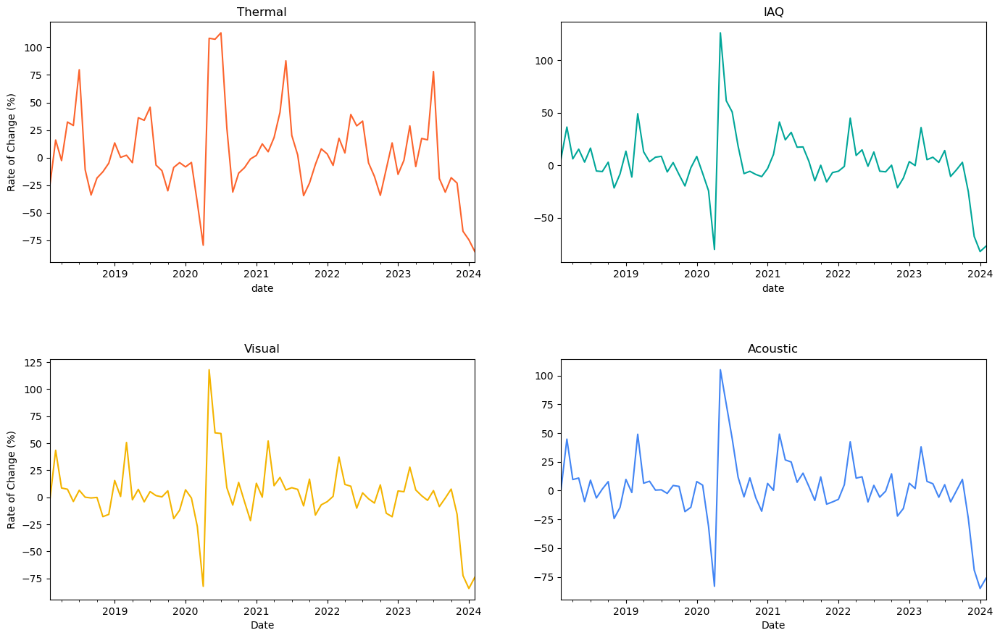

In [ ]:
# 변화율 시각화
thermal_growth_rate = (monthly_avg_thermal.pct_change(periods=1) * 100).dropna()
iaq_growth_rate = (monthly_avg_iaq.pct_change(periods=1) * 100).dropna()
visual_growth_rate = (monthly_avg_visual.pct_change(periods=1) * 100).dropna()
acoustic_growth_rate = (monthly_avg_acoustic.pct_change(periods=1) * 100).dropna()

fig, axes = plt.subplots(2, 2, figsize=(15, 10))
thermal_growth_rate.plot(ax=axes[0, 0], title="Thermal", color="#FC642D")
axes[0, 0].set_ylabel("Rate of Change (%)")

iaq_growth_rate.plot(ax=axes[0, 1], title="IAQ", color="#00A699")
visual_growth_rate.plot(ax=axes[1, 0], title="Visual", color="#F4B400")
axes[1, 0].set_xlabel("Date")
axes[1, 0].set_ylabel("Rate of Change (%)")

acoustic_growth_rate.plot(ax=axes[1, 1], title="Acoustic", color="#4285F4")
axes[1, 1].set_xlabel("Date")

plt.tight_layout(pad=5.0)
plt.show() # 전 월 대비 리뷰 변화율

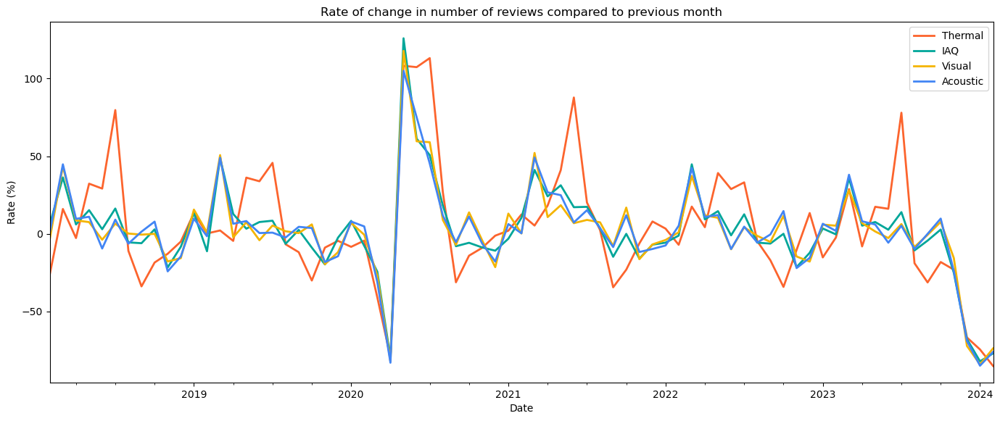

In [ ]:
fig, ax = plt.subplots(figsize=(15, 7))

thermal_growth_rate.plot(ax=ax, label="Thermal", color="#FC642D", linewidth=2,)
iaq_growth_rate.plot(ax=ax, label="IAQ", color="#00A699", linewidth=2,)
visual_growth_rate.plot(ax=ax, label="Visual", color="#F4B400", linewidth=2,)
acoustic_growth_rate.plot(ax=ax, label="Acoustic", color="#4285F4", linewidth=2,)

ax.set_title("Rate of change in number of reviews compared to previous month")
ax.set_ylabel("Rate (%)")
ax.set_xlabel("Date")
ax.legend()

plt.tight_layout(pad=5.0)
plt.show() # 7월(여름)에 Thermal 변화율이 큼. 나머지 요소들은 주로 3월에 변화율이 커짐

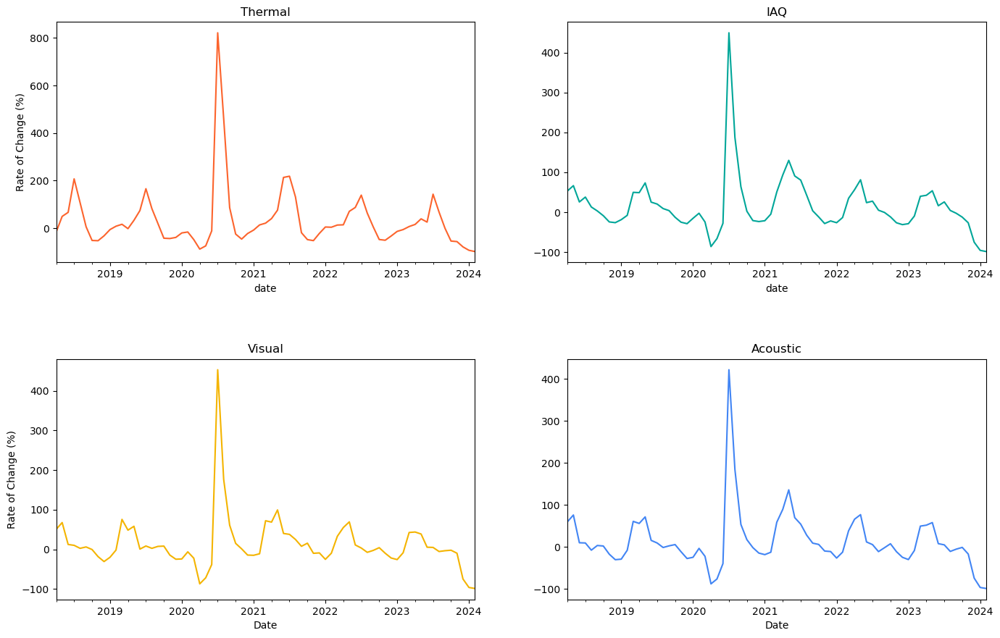

In [ ]:
thermal_growth_rate = (monthly_avg_thermal.pct_change(periods=3) * 100).dropna()
iaq_growth_rate = (monthly_avg_iaq.pct_change(periods=3) * 100).dropna()
visual_growth_rate = (monthly_avg_visual.pct_change(periods=3) * 100).dropna()
acoustic_growth_rate = (monthly_avg_acoustic.pct_change(periods=3) * 100).dropna()

fig, axes = plt.subplots(2, 2, figsize=(15, 10))
thermal_growth_rate.plot(ax=axes[0, 0], title="Thermal", color="#FC642D")
axes[0, 0].set_ylabel("Rate of Change (%)")

iaq_growth_rate.plot(ax=axes[0, 1], title="IAQ", color="#00A699")
visual_growth_rate.plot(ax=axes[1, 0], title="Visual", color="#F4B400")
axes[1, 0].set_xlabel("Date")
axes[1, 0].set_ylabel("Rate of Change (%)")

acoustic_growth_rate.plot(ax=axes[1, 1], title="Acoustic", color="#4285F4")
axes[1, 1].set_xlabel("Date")

plt.tight_layout(pad=5.0)
plt.show() # 전 월 대비 리뷰 변화율

In [ ]:
ieq_df_2018 = ieq_df[ieq_df['date'] >= '2018-01-01']

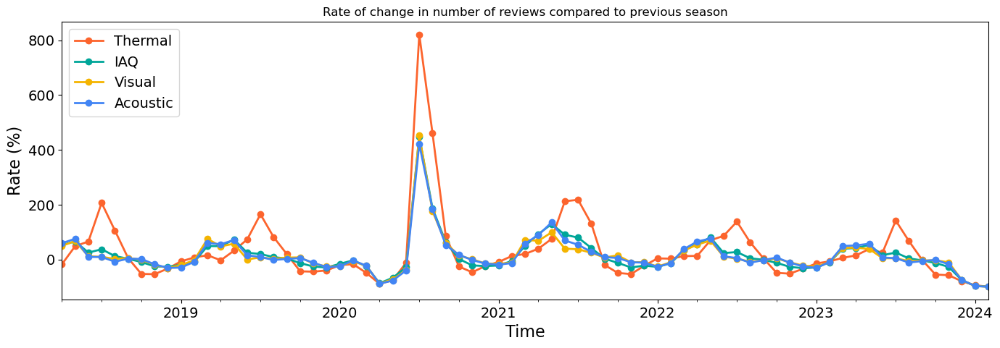

In [ ]:
monthly_reviews_2018 = ieq_df_2018.groupby(ieq_df_2018['date'].dt.to_period('M')).size()
monthly_reviews_growth_rate = (monthly_reviews_2018.pct_change(periods=3) * 100).dropna()

fig, ax = plt.subplots(figsize=(15, 6))

thermal_growth_rate.plot(ax=ax, label="Thermal", color="#FC642D", marker='o', linewidth=2)
iaq_growth_rate.plot(ax=ax, label="IAQ", color="#00A699", marker='o', linewidth=2,)
visual_growth_rate.plot(ax=ax, label="Visual", color="#F4B400", marker='o', linewidth=2,)
acoustic_growth_rate.plot(ax=ax, label="Acoustic", color="#4285F4", marker='o', linewidth=2,)
# monthly_reviews_growth_rate.plot(ax=ax, label="Review Count", color="black", linewidth=2, style='--')

ax.set_title("Rate of change in number of reviews compared to previous season")
ax.set_ylabel("Rate (%)", fontsize=16)
ax.set_xlabel("Time", fontsize = 16)
ax.legend(loc='upper left', fontsize = 14)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.tight_layout(pad=5.0)
plt.show()

## 3.2. 계절별 IEQ 리뷰 보기
계절별 IEQ 리뷰가 담고 있는 단어의 빈도수와 리뷰를 분석한다

### 3.2.1. 계절별 IEQ 리뷰 보기

In [ ]:
winter_ieq_df = ieq_df[(ieq_df['date'].dt.month == 12) | (ieq_df['date'].dt.month <= 2)]
winter_ieq_df['comments'].sample(2)

494215    Great location. Comfy bed. Warm shower. Ellie was very helpful in making sure we were comfortable and knew great local spots to check out. You really feel like you get to be part of the neighborhood and everyone is so welcoming. Thank you!
258098                                   Awesome place, and I would recommend for your Maui stay. The location is quiet and peaceful. The place is bigger than the pictures show. We will definitely look to stay here again when we return to Maui next.
Name: comments, dtype: object

In [ ]:
spring_ieq_df = ieq_df[(ieq_df['date'].dt.month >= 3) & (ieq_df['date'].dt.month <= 5)]
spring_ieq_df['comments'].sample(2)

1431338    This was a nice home in a perfect location.  We were able to access the bus line which was really close! We spent a lot of time exploring the city so we didn't really get to see the host as much. Quiet home and it felt similar to my grandmothers home. Christian was helpful when we first arrived and provided detail instructions on how to get to his home through the public transit.  We enjoyed our stay very much! 
1515736                                                                                                                                                                                                            This place is cute as can be. Very lively surroundings and no parking available so just be prepared. High noise levels outside.  Fabulous views and walkability.  Cactus restaurant and Starbucks nearby so you're set.
Name: comments, dtype: object

In [ ]:
summer_ieq_df = ieq_df[(ieq_df['date'].dt.month >= 6) & (ieq_df['date'].dt.month <= 8)]
summer_ieq_df['comments'].sample(2)

1693096                                                                                                                     This is a wonderful space. Quiet, private, and a fantastic location. Cool neighborhood with many restaurants & bars to explore. I highly recommend this space to everyone!
1540731    It was a little chilly when we arrived, but overall it was an excellent stay. We were satisfied with the space and everything was comfy! It’s a small house but the layout makes it seem like it’s bigger. Malcom is the perfect host, so thoughtful and Sweet. We will definitely be back!
Name: comments, dtype: object

In [ ]:
fall_ieq_df = ieq_df[(ieq_df['date'].dt.month >= 9) & (ieq_df['date'].dt.month <= 11)]
fall_ieq_df['comments'].sample(2)

1683924                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          Great location and easy access. The apartment is nice and comfortable. The host  was friendly, answered questions and requests right away (it got a chilly and we asked to raise the heating, which they did in no time)..
709954     This house is everything that it looks and sounds like here -- and so much more. Everything was in top-notch condition and extremely clean, both indoors and outside. The house and yard are beautifully laid out and furnished. It's spacious and clean, with high-quality furni

### 3.2.2. 계절별 어떤 IEQ 단어가 많이 나올까?
- Thermal 제외, IAQ, Visual, Acoustic 카테고리 모두 빈도수는 차이가 났지만 Top10 단어들은 거의 변화가 없었다
- Thermal 카테고리에서는 계절별 'ac(=air conditioner)'의 빈도수 차이가 가장 도드라졌고 'humid는 여름에 가장 많이 발겼됐다

In [ ]:
import re
import random
from collections import Counter

def count_ieq_keywords(df, category_keywords):
    ieq_keywords_counter = Counter()
    for review in df['comments'].str.lower():
        for keyword in category_keywords:
            # 단어 경계에 있는 경우만 검색
            regex_pattern = r'\b{}\b'.format(re.escape(keyword))
            if re.search(regex_pattern, review):
                ieq_keywords_counter[keyword] += 1
    return ieq_keywords_counter

def top_10_keywords(df, category_keywords):
    ieq_keywords_counter = count_ieq_keywords(df, category_keywords)
    return ieq_keywords_counter.most_common(10)

def print_ieq_category_keywords_frequency(df, category_keywords):
    for category, keywords in category_keywords.items():
        print(f"Top 10 IEQ Keywords for {category} Category:")
        top_keywords = top_10_keywords(df, keywords)
        for keyword, count in top_keywords:
            print(f"{keyword}: {count}")
        print()

def highlight_word_in_reviews(df, target_word, color_code, num_reviews=3):
    regex_pattern = r'\b{}\b'.format(re.escape(target_word))
    highlighted_reviews = []
    reviews_containing_word = df[df['comments'].str.contains(regex_pattern)]
    selected_reviews = random.sample(reviews_containing_word['comments'].tolist(), min(num_reviews, len(reviews_containing_word)))
    for review in selected_reviews:
        colored_review = re.sub(regex_pattern, f'{color_code}{target_word}\033[0m', review)
        highlighted_reviews.append(colored_review)
    return highlighted_reviews

def sum_ieq_category_counts(dataframes, category_keywords):
    ieq_category_counts = {'Thermal': 0, 'Visual': 0, 'Acoustic': 0, 'IAQ': 0}
    for df in dataframes:
        for category, keywords in category_keywords.items():
            for keyword in keywords:
                ieq_category_counts[category] += df['comments'].str.lower().str.count(r'\b{}\b'.format(keyword.lower())).sum()
    return ieq_category_counts

ieq_category_keywords = {
    'Thermal': thermal_keywords,
    'IAQ': iaq_keywords,
    'Visual': visual_keywords,
    'Acoustic': acoustic_keywords,
}

In [ ]:
# 겨울에 카테고리별 IEQ 단어 빈도수 TOP 10
print_ieq_category_keywords_frequency(winter_ieq_df, ieq_category_keywords)

Top 10 IEQ Keywords for Thermal Category:
cold: 19666
warm: 13541
heat: 8686
ac: 7857
temperature: 4633
chilly: 3586
freezing: 1775
air conditioning: 1247
air conditioner: 730
warm up: 664

Top 10 IEQ Keywords for IAQ Category:
breeze: 13269
smell: 5945
smoke: 2120
dust: 2028
rick: 1951
dry: 1775
mold: 1438
dusty: 1423
musty: 839
fresh air: 597

Top 10 IEQ Keywords for Visual Category:
bright: 10114
dark: 5602
lighting: 5044
natural light: 1769
lamp: 1170
shady: 400
dim: 322
glow: 186
black out: 178
no window: 114

Top 10 IEQ Keywords for Acoustic Category:
quiet: 171834
noise: 29363
hear: 20250
loud: 15171
noisy: 11293
sound: 8390
heard: 4928
squeaky: 1722
echo: 1023
silent: 523



In [ ]:
# 봄
print_ieq_category_keywords_frequency(spring_ieq_df, ieq_category_keywords)

Top 10 IEQ Keywords for Thermal Category:
ac: 16802
warm: 12174
cold: 11523
heat: 6772
temperature: 4845
air conditioning: 2924
chilly: 2551
air conditioner: 1328
sticky: 915
humid: 889

Top 10 IEQ Keywords for IAQ Category:
breeze: 18866
smell: 7918
dust: 2624
smoke: 2589
rick: 2453
dry: 2013
dusty: 1996
mold: 1854
musty: 1109
fresh air: 939

Top 10 IEQ Keywords for Visual Category:
bright: 15644
dark: 6602
lighting: 6028
natural light: 2876
lamp: 1488
shady: 645
dim: 324
black out: 260
glow: 194
no window: 160

Top 10 IEQ Keywords for Acoustic Category:
quiet: 246606
noise: 40152
hear: 26163
loud: 20843
noisy: 14972
sound: 10991
heard: 6705
squeaky: 2448
echo: 1243
silent: 655



In [ ]:
# 여름
print_ieq_category_keywords_frequency(summer_ieq_df, ieq_category_keywords)

Top 10 IEQ Keywords for Thermal Category:
ac: 54785
heat: 17572
warm: 16641
air conditioning: 10563
cold: 8088
temperature: 7641
air conditioner: 4196
humid: 2980
sticky: 1332
cool off: 979

Top 10 IEQ Keywords for IAQ Category:
breeze: 25333
smell: 9792
dust: 3244
smoke: 2986
rick: 2843
dry: 2442
mold: 2350
dusty: 2290
stuffy: 1956
musty: 1657

Top 10 IEQ Keywords for Visual Category:
bright: 16602
dark: 7569
lighting: 6552
natural light: 3017
lamp: 1755
shady: 1208
dim: 402
black out: 351
small window: 246
no window: 245

Top 10 IEQ Keywords for Acoustic Category:
quiet: 284535
noise: 41322
hear: 25855
loud: 22439
noisy: 15753
sound: 11178
heard: 7455
squeaky: 2746
echo: 1318
silent: 845



In [ ]:
# 가을
print_ieq_category_keywords_frequency(fall_ieq_df, ieq_category_keywords)

Top 10 IEQ Keywords for Thermal Category:
ac: 28077
warm: 14827
cold: 12109
heat: 9936
temperature: 5979
air conditioning: 4777
chilly: 2275
air conditioner: 2029
humid: 1601
sticky: 1048

Top 10 IEQ Keywords for IAQ Category:
breeze: 21451
smell: 9191
smoke: 3157
dust: 3149
rick: 2559
mold: 2302
dusty: 2282
dry: 2199
musty: 1505
stuffy: 1216

Top 10 IEQ Keywords for Visual Category:
bright: 15255
dark: 8874
lighting: 7188
natural light: 2836
lamp: 1778
shady: 706
dim: 462
black out: 327
no window: 201
glow: 174

Top 10 IEQ Keywords for Acoustic Category:
quiet: 276417
noise: 43537
hear: 27778
loud: 22677
noisy: 16409
sound: 11358
heard: 7169
squeaky: 2818
echo: 1306
silent: 790



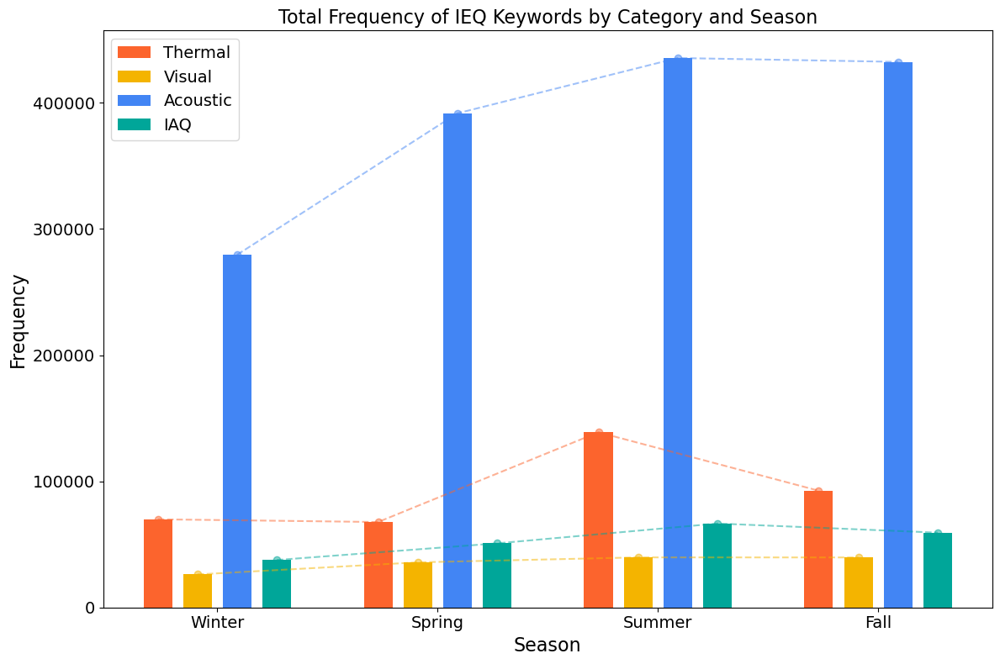

In [ ]:
# 계절별 IEQ 카테고리별 단어 빈도수
winter_counts = {'Thermal': 69881, 'Visual': 26176, 'Acoustic': 279583, 'IAQ': 37618}
spring_counts = {'Thermal': 67718, 'Visual': 35754, 'Acoustic': 391723, 'IAQ': 50814}
summer_counts = {'Thermal': 138869, 'Visual': 39693, 'Acoustic': 435544, 'IAQ': 66534}
fall_counts = {'Thermal': 92533, 'Visual': 39639, 'Acoustic': 432477, 'IAQ': 59299}

# 카테고리와 계절 정의
categories = list(winter_counts.keys())
seasons = ['Winter', 'Spring', 'Summer', 'Fall']
num_categories = len(categories)

# 막대 그래프 그리기
bar_width = 0.13
bar_spacing = 0.05
fig, ax = plt.subplots(figsize=(12, 8))

for i, category in enumerate(categories):
    winter_value = winter_counts[category]
    spring_value = spring_counts[category]
    summer_value = summer_counts[category]
    fall_value = fall_counts[category]

    x = np.arange(len(seasons)) + i * (bar_width + bar_spacing)
    ax.bar(x, [winter_value, spring_value, summer_value, fall_value],
           width=bar_width, label=category, color=category_colors[category])

    # 추세선 그리기
    trend_x = np.arange(len(seasons)) + i * (bar_width + bar_spacing) + bar_width / 2 - 0.065
    trend_y = [winter_value, spring_value, summer_value, fall_value]
    ax.plot(trend_x, trend_y, marker='o', linestyle='--', color=category_colors[category], alpha=0.5, zorder=3)

# 그래프 속성 설정
ax.set_xlabel('Season', fontsize=16)
ax.set_ylabel('Frequency', fontsize=16)
ax.set_title('Total Frequency of IEQ Keywords by Category and Season', fontsize=16)
ax.set_xticks(np.arange(len(seasons)) + (num_categories - 1) * (bar_width + bar_spacing) / 2)
ax.set_xticklabels(seasons)
ax.legend(fontsize=14)

plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.tight_layout()
plt.show()

In [ ]:
# 찾고 싶은 별점 데이터와 단어 설정
data = winter_ieq_df
target_word = 'cold'

# 강조된 리뷰 3개 출력
highlighted_reviews = highlight_word_in_reviews(data, target_word, '\033[41m')
for review in highlighted_reviews:
    print(review)

The space was good for the price it was just not the area I expected and the house was connected to another property so not a lot of privacy over all was clean just didn’t have things like toilet paper and paper towels trash bags but the owner did bring some. It was also very hot up stairs and cold down stairs.
Liliane has a nice little place in the heart of downtown Newport.  Not only was it in a good location but also pet-friendly which was very important since my girlfriend and I had our dog with us.  It was nice of Liliane to be accommodating of that.<br/>Our only unfortunate experiences involved not hearing from Liliane as we were on our way there, upon arrival, and during check-out.  I had messaged her as we were getting ready to head to Newport and then once we arrived.  She did not immediately answer.  We pulled into a parking lot across the street and waited a few minutes and then I tried calling her phone and there was no answer.  It was very cold outside and we wanted to be 

## 3.3. 일별 IEQ 차이
일별 IEQ 리뷰의 변화를 시각화하고 차이를 분석한다

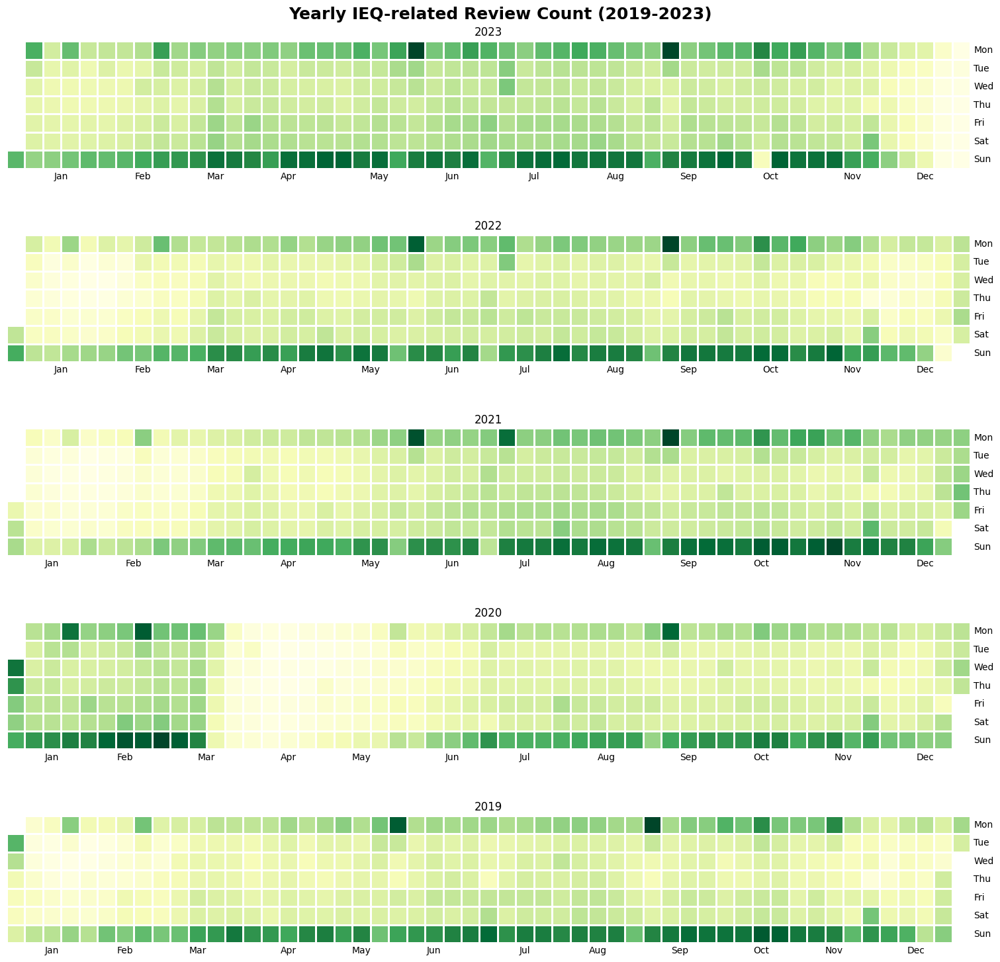

In [ ]:
!pip install calmap
import calmap

date_2023 = airbnb_df[airbnb_df['date'].dt.year == 2023]
date_2022 = airbnb_df[airbnb_df['date'].dt.year == 2022]
date_2021 = airbnb_df[airbnb_df['date'].dt.year == 2021]
date_2020 = airbnb_df[airbnb_df['date'].dt.year == 2020]
date_2019 = airbnb_df[airbnb_df['date'].dt.year == 2019]

data_23 = date_2023.groupby('date').size()
data_22 = date_2022.groupby('date').size()
data_21 = date_2021.groupby('date').size()
data_20 = date_2020.groupby('date').size()
data_19 = date_2019.groupby('date').size()

dates_23 = pd.date_range("2023-01-01", periods=365)
dates_22 = pd.date_range("2022-01-01", periods=365)
dates_21 = pd.date_range("2021-01-01", periods=365)
dates_20 = pd.date_range("2020-01-01", periods=366) # 2020년은 윤년
dates_19 = pd.date_range("2019-01-01", periods=365)

df_23 = pd.DataFrame({"date": dates_23, "value": data_23.reindex(dates_23, fill_value=0)})
df_22 = pd.DataFrame({"date": dates_22, "value": data_22.reindex(dates_22, fill_value=0)})
df_21 = pd.DataFrame({"date": dates_21, "value": data_21.reindex(dates_21, fill_value=0)})
df_20 = pd.DataFrame({"date": dates_20, "value": data_20.reindex(dates_20, fill_value=0)})
df_19 = pd.DataFrame({"date": dates_19, "value": data_19.reindex(dates_19, fill_value=0)})

df_23.set_index("date", inplace=True)
df_22.set_index("date", inplace=True)
df_21.set_index("date", inplace=True)
df_20.set_index("date", inplace=True)
df_19.set_index("date", inplace=True)

fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(15, 15))

calmap.yearplot(df_23['value'], year=2023, ax=axes[0], cmap='YlGn', fillcolor='white', linewidth=1)
calmap.yearplot(df_22['value'], year=2022, ax=axes[1], cmap='YlGn', fillcolor='white', linewidth=1)
calmap.yearplot(df_21['value'], year=2021, ax=axes[2], cmap='YlGn', fillcolor='white', linewidth=1)
calmap.yearplot(df_20['value'], year=2020, ax=axes[3], cmap='YlGn', fillcolor='white', linewidth=1)
calmap.yearplot(df_19['value'], year=2019, ax=axes[4], cmap='YlGn', fillcolor='white', linewidth=1)

axes[0].set_title('2023', fontsize=12)
axes[1].set_title('2022', fontsize=12)
axes[2].set_title('2021', fontsize=12)
axes[3].set_title('2020', fontsize=12)
axes[4].set_title('2019', fontsize=12)

fig.suptitle('Yearly IEQ-related Review Count (2019-2023)', fontsize=18, weight='bold')
fig.patch.set_facecolor('white')

plt.tight_layout(pad=0.3)
plt.show()
# 공휴일, 일요일에 리뷰수가 많음
# 5월 마지막 월요일 (5월 25~31일)인 '메모리얼 데이'
# 9월 첫째 월요일 (9월 1~7일)인 '노동절'

<ipython-input-92-699a913151a5>:4: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-92-699a913151a5>:6: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-92-699a913151a5>:8: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



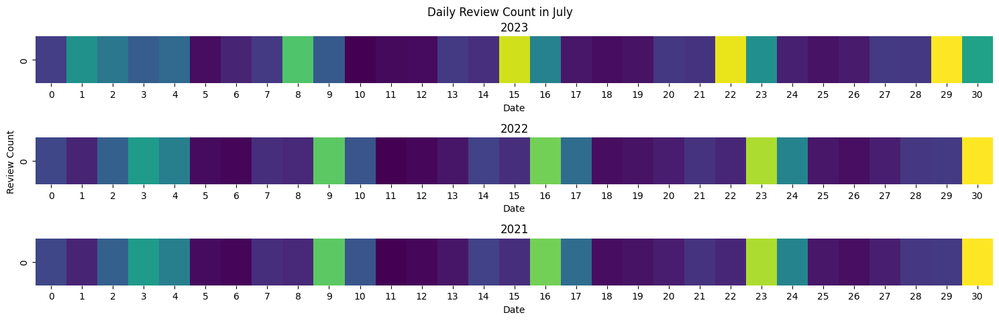

In [ ]:
cmap = 'viridis'
fig, axes = plt.subplots(3, 1, figsize=(15, 5))

date_2023_07 = airbnb_df[airbnb_df['date'].dt.year == 2023][airbnb_df['date'].dt.month == 7]
daily_review_count_2023 = date_2023_07.groupby('date')['id'].count()
date_2022_07 = airbnb_df[airbnb_df['date'].dt.year == 2022][airbnb_df['date'].dt.month == 7]
daily_review_count_2022 = date_2022_07.groupby('date')['id'].count()
date_2021_07 = airbnb_df[airbnb_df['date'].dt.year == 2021][airbnb_df['date'].dt.month == 7]
daily_review_count_2021 = date_2022_07.groupby('date')['id'].count()

sns.heatmap(daily_review_count_2023.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[0], cbar=False)
sns.heatmap(daily_review_count_2022.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[1], cbar=False)
sns.heatmap(daily_review_count_2021.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[2], cbar=False)

axes[0].set_title('2023')
axes[1].set_title('2022')
axes[2].set_title('2021')
axes[0].set(xlabel='Date')
axes[1].set(xlabel='Date', ylabel='Review Count')
axes[2].set(xlabel='Date')

fig.suptitle('Daily Review Count in July', x=0.5, y=0.95)
plt.tight_layout()
plt.show()

<ipython-input-93-79c33aaf459d>:4: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-93-79c33aaf459d>:6: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-93-79c33aaf459d>:8: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



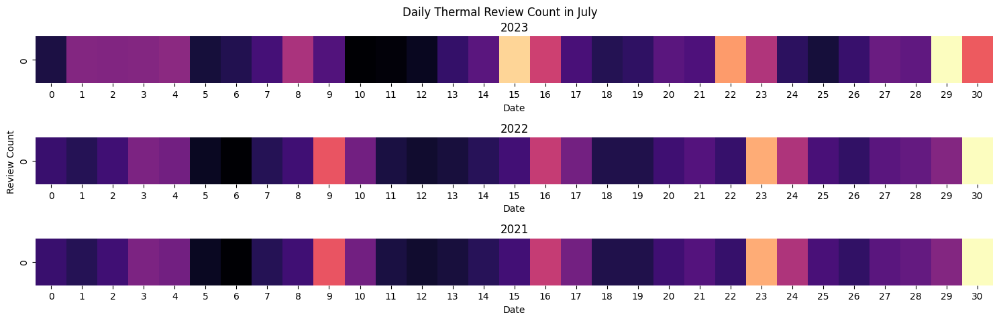

In [ ]:
cmap = 'magma'
fig, axes = plt.subplots(3, 1, figsize=(15, 5))

date_2023_07 = date_thermal[date_thermal['date'].dt.year == 2023][date_thermal['date'].dt.month == 7]
daily_review_count_2023 = date_2023_07.groupby('date')['id'].count()
date_2022_07 = date_thermal[date_thermal['date'].dt.year == 2022][date_thermal['date'].dt.month == 7]
daily_review_count_2022 = date_2022_07.groupby('date')['id'].count()
date_2021_07 = date_thermal[date_thermal['date'].dt.year == 2021][date_thermal['date'].dt.month == 7]
daily_review_count_2021 = date_2022_07.groupby('date')['id'].count()

sns.heatmap(daily_review_count_2023.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[0], cbar=False)
sns.heatmap(daily_review_count_2022.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[1], cbar=False)
sns.heatmap(daily_review_count_2021.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[2], cbar=False)

axes[0].set_title('2023')
axes[1].set_title('2022')
axes[2].set_title('2021')
axes[0].set(xlabel='Date')
axes[1].set(xlabel='Date', ylabel='Review Count')
axes[2].set(xlabel='Date')

fig.suptitle('Daily Thermal Review Count in July', x=0.5, y=0.95)
plt.tight_layout()
plt.show()

<ipython-input-94-e0e5c6c0babe>:4: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-94-e0e5c6c0babe>:6: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-94-e0e5c6c0babe>:8: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



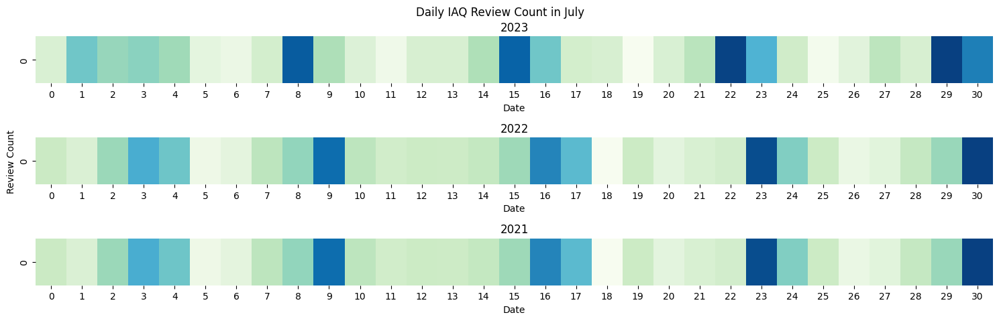

In [ ]:
cmap = 'GnBu'
fig, axes = plt.subplots(3, 1, figsize=(15, 5))

date_2023_07 = date_IAQ[date_IAQ['date'].dt.year == 2023][date_IAQ['date'].dt.month == 7]
daily_review_count_2023 = date_2023_07.groupby('date')['id'].count()
date_2022_07 = date_IAQ[date_IAQ['date'].dt.year == 2022][date_IAQ['date'].dt.month == 7]
daily_review_count_2022 = date_2022_07.groupby('date')['id'].count()
date_2021_07 = date_IAQ[date_IAQ['date'].dt.year == 2021][date_IAQ['date'].dt.month == 7]
daily_review_count_2021 = date_2022_07.groupby('date')['id'].count()

sns.heatmap(daily_review_count_2023.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[0], cbar=False)
sns.heatmap(daily_review_count_2022.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[1], cbar=False)
sns.heatmap(daily_review_count_2021.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[2], cbar=False)

axes[0].set_title('2023')
axes[1].set_title('2022')
axes[2].set_title('2021')
axes[0].set(xlabel='Date')
axes[1].set(xlabel='Date', ylabel='Review Count')
axes[2].set(xlabel='Date')

fig.suptitle('Daily IAQ Review Count in July', x=0.5, y=0.95)
plt.tight_layout()
plt.show()

<ipython-input-95-d4d480199a27>:4: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-95-d4d480199a27>:6: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-95-d4d480199a27>:8: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



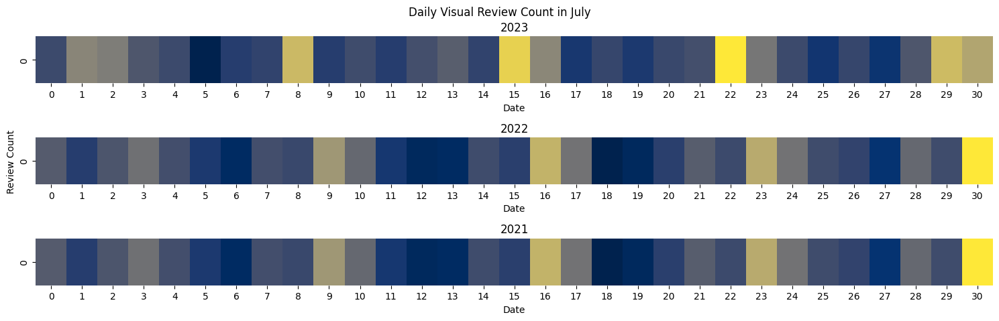

In [ ]:
cmap = 'cividis'
fig, axes = plt.subplots(3, 1, figsize=(15, 5))

date_2023_07 = date_Visual[date_Visual['date'].dt.year == 2023][date_Visual['date'].dt.month == 7]
daily_review_count_2023 = date_2023_07.groupby('date')['id'].count()
date_2022_07 = date_Visual[date_Visual['date'].dt.year == 2022][date_Visual['date'].dt.month == 7]
daily_review_count_2022 = date_2022_07.groupby('date')['id'].count()
date_2021_07 = date_Visual[date_Visual['date'].dt.year == 2021][date_Visual['date'].dt.month == 7]
daily_review_count_2021 = date_2022_07.groupby('date')['id'].count()

sns.heatmap(daily_review_count_2023.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[0], cbar=False)
sns.heatmap(daily_review_count_2022.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[1], cbar=False)
sns.heatmap(daily_review_count_2021.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[2], cbar=False)

axes[0].set_title('2023')
axes[1].set_title('2022')
axes[2].set_title('2021')
axes[0].set(xlabel='Date')
axes[1].set(xlabel='Date', ylabel='Review Count')
axes[2].set(xlabel='Date')

fig.suptitle('Daily Visual Review Count in July', x=0.5, y=0.95)
plt.tight_layout()
plt.show()

<ipython-input-96-d0848ebf6d9e>:4: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-96-d0848ebf6d9e>:6: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

<ipython-input-96-d0848ebf6d9e>:8: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



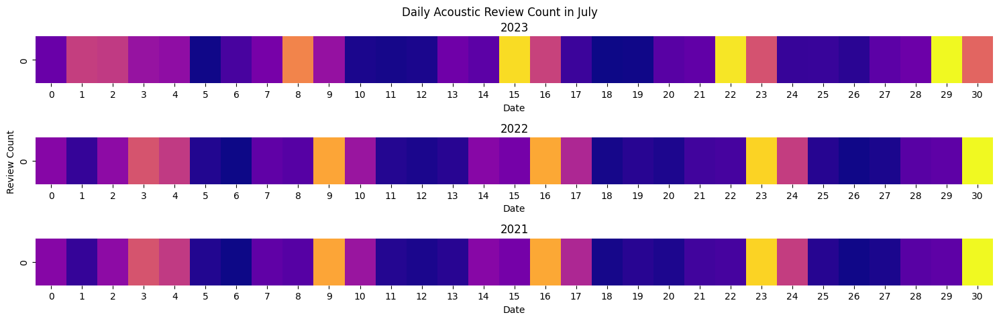

In [ ]:
cmap = 'plasma'
fig, axes = plt.subplots(3, 1, figsize=(15, 5))

date_2023_07 = date_Acoustic[date_Acoustic['date'].dt.year == 2023][date_Acoustic['date'].dt.month == 7]
daily_review_count_2023 = date_2023_07.groupby('date')['id'].count()
date_2022_07 = date_Acoustic[date_Acoustic['date'].dt.year == 2022][date_Acoustic['date'].dt.month == 7]
daily_review_count_2022 = date_2022_07.groupby('date')['id'].count()
date_2021_07 = date_Acoustic[date_Acoustic['date'].dt.year == 2021][date_Acoustic['date'].dt.month == 7]
daily_review_count_2021 = date_2022_07.groupby('date')['id'].count()

sns.heatmap(daily_review_count_2023.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[0], cbar=False)
sns.heatmap(daily_review_count_2022.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[1], cbar=False)
sns.heatmap(daily_review_count_2021.to_numpy().reshape(1, -1), cmap=cmap, ax=axes[2], cbar=False)

axes[0].set_title('2023')
axes[1].set_title('2022')
axes[2].set_title('2021')
axes[0].set(xlabel='Date')
axes[1].set(xlabel='Date', ylabel='Review Count')
axes[2].set(xlabel='Date')

fig.suptitle('Daily Acoustic Review Count in July', x=0.5, y=0.95)
plt.tight_layout()
plt.show()

## 3.4. 코로나 시기 IEQ 살펴보기

### 3.2.1. 코로나 전후로 리뷰수 변화

In [ ]:
# 코로나 시기(2020~2021)
airbnb_df_covid = airbnb_df[(airbnb_df['date'].dt.year == 2020) | (airbnb_df['date'].dt.year == 2021)]
# 코로나 전 시기(2018~2019)
airbnb_df_1819 = airbnb_df[(airbnb_df['date'].dt.year == 2018) | (airbnb_df['date'].dt.year == 2019)]

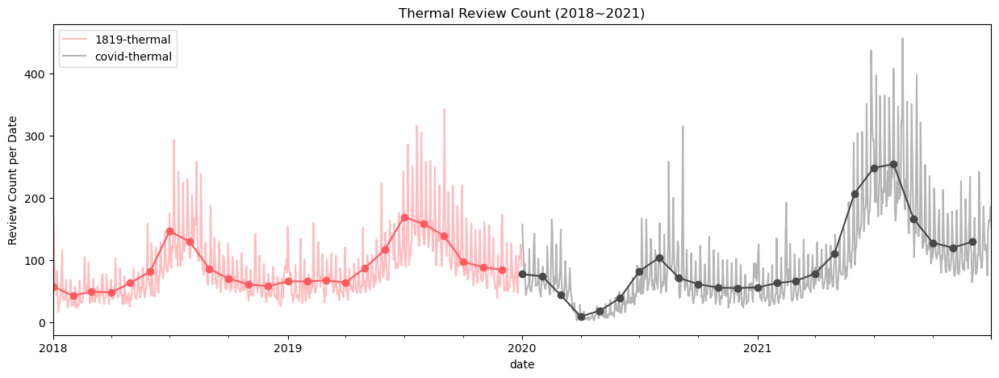

In [ ]:
year_1819_thermal = airbnb_df_1819[airbnb_df_1819['Thermal'] == 1]
year_1819_thermal_count = year_1819_thermal.groupby(year_1819_thermal['date'].dt.to_period('M')).size()
monthly_avg_year_1819_thermal_count = year_1819_thermal_count.groupby(year_1819_thermal_count.index.to_timestamp()).mean() / 30
covid_thermal = airbnb_df_covid[airbnb_df_covid['Thermal'] == 1]
covid_thermal_count = covid_thermal.groupby(covid_thermal['date'].dt.to_period('M')).size()
monthly_avg_covid_thermal_count = covid_thermal_count.groupby(covid_thermal_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
year_1819_thermal.groupby('date').size().plot(color='#FF5A5F', alpha = 0.4, label='1819-thermal')
monthly_avg_year_1819_thermal_count.plot(color='#FF5A5F', marker='o', linestyle='-')
covid_thermal.groupby('date').size().plot(color='#484848', alpha = 0.4, label='covid-thermal')
monthly_avg_covid_thermal_count.plot(color='#484848', marker='o', linestyle='-')

plt.title('Thermal Review Count (2018~2021)')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

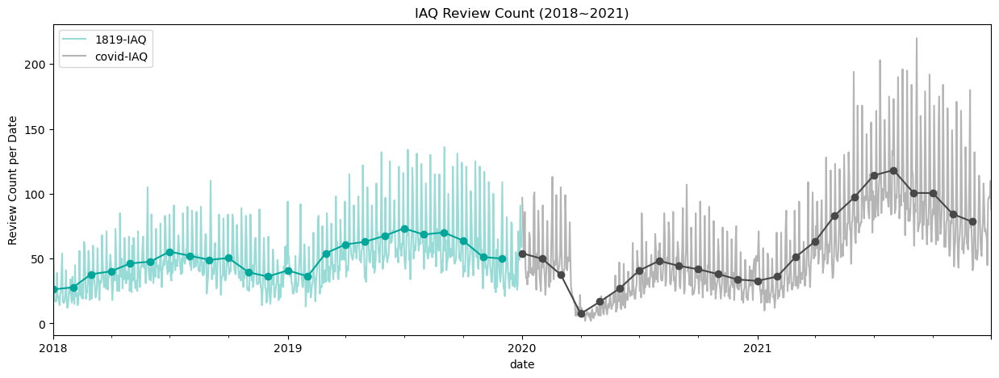

In [ ]:
year_1819_IAQ = airbnb_df_1819[airbnb_df_1819['IAQ'] == 1]
year_1819_IAQ_count = year_1819_IAQ.groupby(year_1819_IAQ['date'].dt.to_period('M')).size()
monthly_avg_year_1819_IAQ_count = year_1819_IAQ_count.groupby(year_1819_IAQ_count.index.to_timestamp()).mean() / 30
covid_IAQ = airbnb_df_covid[airbnb_df_covid['IAQ'] == 1]
covid_IAQ_count = covid_IAQ.groupby(covid_IAQ['date'].dt.to_period('M')).size()
monthly_avg_covid_IAQ_count = covid_IAQ_count.groupby(covid_IAQ_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
year_1819_IAQ.groupby('date').size().plot(color='#00A699', alpha = 0.4, label='1819-IAQ')
monthly_avg_year_1819_IAQ_count.plot(color='#00A699', marker='o', linestyle='-')
covid_IAQ.groupby('date').size().plot(color='#484848', alpha = 0.4, label='covid-IAQ')
monthly_avg_covid_IAQ_count.plot(color='#484848', marker='o', linestyle='-')

plt.title('IAQ Review Count (2018~2021)')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

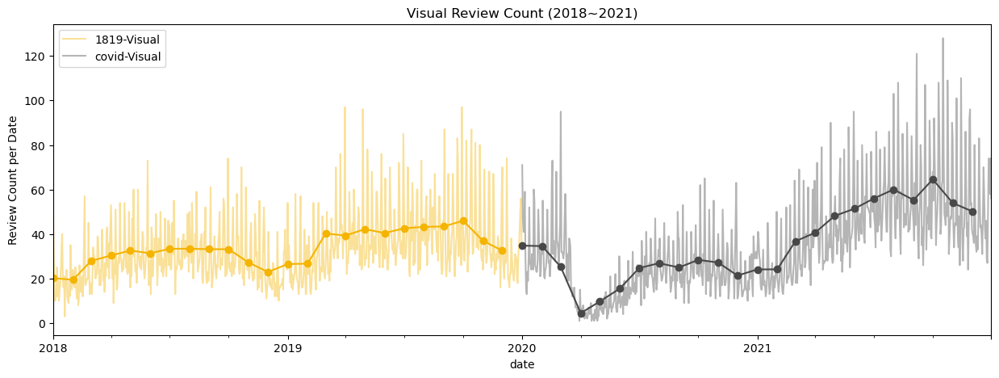

In [ ]:
year_1819_Visual = airbnb_df_1819[airbnb_df_1819['Visual'] == 1]
year_1819_Visual_count = year_1819_Visual.groupby(year_1819_Visual['date'].dt.to_period('M')).size()
monthly_avg_year_1819_Visual_count = year_1819_Visual_count.groupby(year_1819_Visual_count.index.to_timestamp()).mean() / 30
covid_Visual = airbnb_df_covid[airbnb_df_covid['Visual'] == 1]
covid_Visual_count = covid_Visual.groupby(covid_Visual['date'].dt.to_period('M')).size()
monthly_avg_covid_Visual_count = covid_Visual_count.groupby(covid_Visual_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
year_1819_Visual.groupby('date').size().plot(color='#F4B400', alpha = 0.4, label='1819-Visual')
monthly_avg_year_1819_Visual_count.plot(color='#F4B400', marker='o', linestyle='-')
covid_Visual.groupby('date').size().plot(color='#484848', alpha = 0.4, label='covid-Visual')
monthly_avg_covid_Visual_count.plot(color='#484848', marker='o', linestyle='-')

plt.title('Visual Review Count (2018~2021)')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

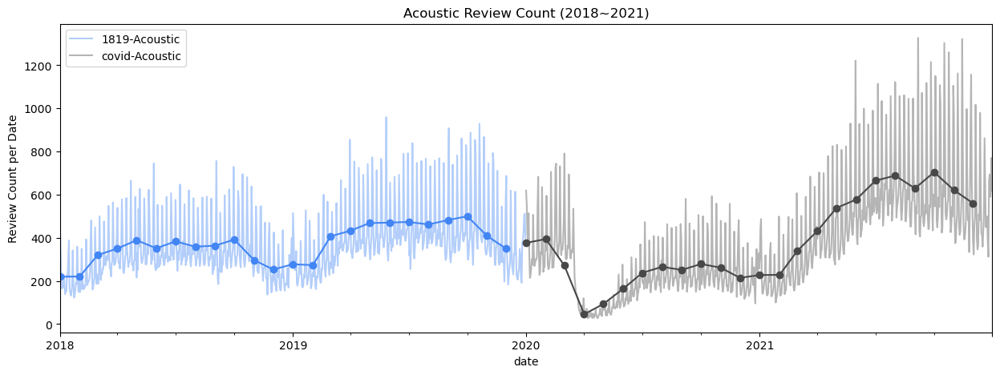

In [ ]:
year_1819_Acoustic = airbnb_df_1819[airbnb_df_1819['Acoustic'] == 1]
year_1819_Acoustic_count = year_1819_Acoustic.groupby(year_1819_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_year_1819_Acoustic_count = year_1819_Acoustic_count.groupby(year_1819_Acoustic_count.index.to_timestamp()).mean() / 30
covid_Acoustic = airbnb_df_covid[airbnb_df_covid['Acoustic'] == 1]
covid_Acoustic_count = covid_Acoustic.groupby(covid_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_covid_Acoustic_count = covid_Acoustic_count.groupby(covid_Acoustic_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
year_1819_Acoustic.groupby('date').size().plot(color='#4285F4', alpha = 0.4, label='1819-Acoustic')
monthly_avg_year_1819_Acoustic_count.plot(color='#4285F4', marker='o', linestyle='-')
covid_Acoustic.groupby('date').size().plot(color='#484848', alpha = 0.4, label='covid-Acoustic')
monthly_avg_covid_Acoustic_count.plot(color='#484848', marker='o', linestyle='-')

plt.title('Acoustic Review Count (2018~2021)')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


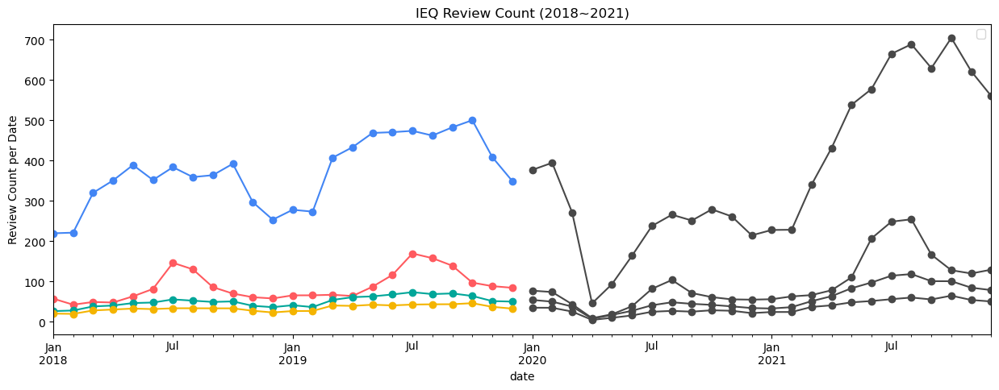

In [ ]:
plt.figure(figsize=(15, 5))
monthly_avg_year_1819_thermal_count.plot(color='#FF5A5F', marker='o', linestyle='-')
monthly_avg_covid_thermal_count.plot(color='#484848', marker='o', linestyle='-')
monthly_avg_year_1819_IAQ_count.plot(color='#00A699', marker='o', linestyle='-')
monthly_avg_covid_IAQ_count.plot(color='#484848', marker='o', linestyle='-')
monthly_avg_year_1819_Visual_count.plot(color='#F4B400', marker='o', linestyle='-')
monthly_avg_covid_Visual_count.plot(color='#484848', marker='o', linestyle='-')
monthly_avg_year_1819_Acoustic_count.plot(color='#4285F4', marker='o', linestyle='-')
monthly_avg_covid_Acoustic_count.plot(color='#484848', marker='o', linestyle='-')

plt.title('IEQ Review Count (2018~2021)')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

### 3.2.2. 코로나 시기 리뷰 보기

In [ ]:
airbnb_df_covid['comments'].tail(10)

10523530                                                                                                                      Cute 1 bedroom with almost a loft-type feel -- open, yet cozy.  Very clean and welcoming!  Communication was great regarding snowy conditions and check-in.  Charming residential neighborhood to walk through with lots of restaurant options nearby for warm food delivery.  Easily one of our favorite places to stay, we'll be on look out for Hygge House next time we're in town!
10523531                                                                                                                                                                                                                                                                                                                                                                                                                                                                       Nice and cozy place. Recommend to s

In [ ]:
!pip install pyLDAvis

In [ ]:
from gensim import corpora, models
from gensim.models import LdaModel
import pyLDAvis.gensim

In [ ]:
# 코로나 시기 tf-idf로 토픽 모델링
tokenized_reviews = [review for review in airbnb_df_covid['comments_tokenized']]
covid_dictionary = corpora.Dictionary(tokenized_reviews)
corpus = [covid_dictionary.doc2bow(review) for review in tokenized_reviews]

In [ ]:
tfidf_model = models.TfidfModel(corpus)
corpus_covid_tfidf = tfidf_model[corpus]
%time covid_tfidf_model = LdaModel(corpus=corpus_covid_tfidf, id2word=covid_dictionary, num_topics=10, passes=10, random_state=42)

In [ ]:
pyLDAvis.enable_notebook()
vis_tfidf_covid = pyLDAvis.gensim.prepare(covid_tfidf_model, corpus_covid_tfidf, covid_dictionary, sort_topics=True)
pyLDAvis.display(vis_tfidf_covid)

In [ ]:
# pyLDAvis.save_html(vis_tfidf_covid, '/content/drive/Othercomputers/내 노트북/Inside Airbnb/GoogleDrive/USA_all_cities/vis_tfidf_covid.html')
# pyLDAvis.save_html(vis_tfidf_covid, '/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/vis_tfidf_covid.html')

In [ ]:
airbnb_df_covid_neg = airbnb_df_covid[airbnb_df_covid['Sentiment'] == 'NEGATIVE']
airbnb_df_covid_pos = airbnb_df_covid[airbnb_df_covid['Sentiment'] == 'POSITIVE']

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# 코로나 시기 tf-idf로 토픽 모델링(부정적인 리뷰들)
tokenized_reviews_neg = [review for review in airbnb_df_covid_neg['comments_tokenized']]
covid_dictionary_neg = corpora.Dictionary(tokenized_reviews_neg)
corpus_neg = [covid_dictionary_neg.doc2bow(review) for review in tokenized_reviews_neg]
tfidf_model = models.TfidfModel(corpus_neg)
corpus_covid_tfidf_neg = tfidf_model[corpus_neg]
%time covid_tfidf_model_neg = LdaModel(corpus=corpus_covid_tfidf_neg, id2word=covid_dictionary_neg, num_topics=10, passes=10, random_state=42)
pyLDAvis.enable_notebook()
vis_tfidf_covid_neg = pyLDAvis.gensim.prepare(covid_tfidf_model_neg, corpus_covid_tfidf_neg, covid_dictionary_neg, sort_topics=True)
pyLDAvis.display(vis_tfidf_covid_neg)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


CPU times: user 4min 26s, sys: 950 ms, total: 4min 27s
Wall time: 4min 27s


In [ ]:
# 코로나 시기 tf-idf로 토픽 모델링(긍정적인 리뷰들)
tokenized_reviews_pos = [review for review in airbnb_df_covid_pos['comments_tokenized']]
covid_dictionary_pos = corpora.Dictionary(tokenized_reviews_pos)
corpus_pos = [covid_dictionary_pos.doc2bow(review) for review in tokenized_reviews_pos]
tfidf_model = models.TfidfModel(corpus_pos)
corpus_covid_tfidf_pos = tfidf_model[corpus_pos]
%time covid_tfidf_model_pos = LdaModel(corpus=corpus_covid_tfidf_pos, id2word=covid_dictionary_pos, num_topics=10, passes=10, random_state=42)
pyLDAvis.enable_notebook()
vis_tfidf_covid_pos = pyLDAvis.gensim.prepare(covid_tfidf_model_pos, corpus_covid_tfidf_pos, covid_dictionary_pos, sort_topics=True)
pyLDAvis.display(vis_tfidf_covid_pos)

In [ ]:
# pyLDAvis.save_html(vis_tfidf_covid_neg, '/content/drive/Othercomputers/내 노트북/Inside Airbnb/GoogleDrive/USA_all_cities/vis_tfidf_covid_neg.html')
# pyLDAvis.save_html(vis_tfidf_covid_pos, '/content/drive/Othercomputers/내 노트북/Inside Airbnb/GoogleDrive/USA_all_cities/vis_tfidf_covid_pos.html')
# pyLDAvis.save_html(vis_tfidf_covid_neg, '/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/vis_tfidf_covid_neg.html')
# pyLDAvis.save_html(vis_tfidf_covid_pos, '/content/drive/Othercomputers/내 MacBook Air/GoogleDrive/USA_all_cities/vis_tfidf_covid_pos.html')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


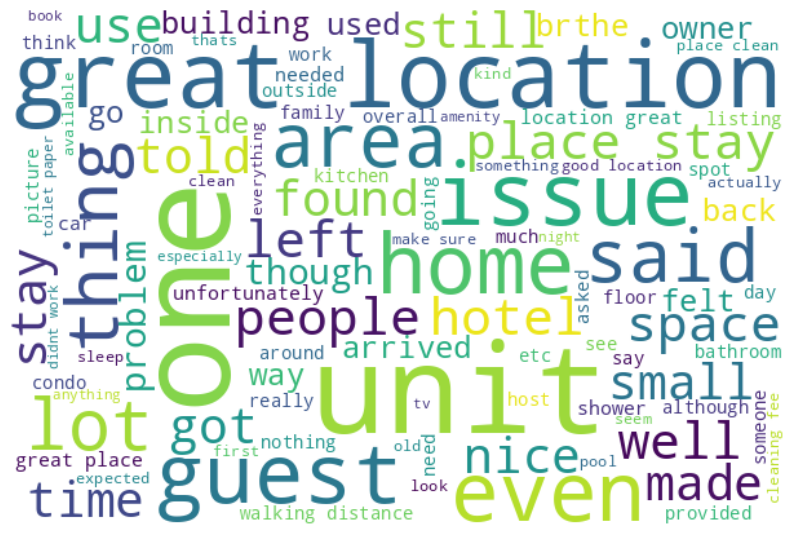

In [ ]:
# 코로나 시기 부정적인 리뷰들에 대한 워드클라우드
from wordcloud import WordCloud

tokenized_reviews_neg = [review for review in airbnb_df_covid_neg['comments_tokenized']]
text_neg = " ".join(word for review in tokenized_reviews_neg for word in review)
wordcloud_neg = WordCloud(width=600,
                          height=400,
                          background_color='white',
                          max_font_size=100,
                          max_words=100,
                          contour_width=3,
                          contour_color='steelblue').generate(text_neg)

plt.figure(figsize=(10, 8))
plt.imshow(wordcloud_neg, interpolation='bilinear')
plt.axis('off')
plt.show()

In [ ]:
from collections import Counter

word_counts = Counter()
for review in airbnb_df_covid_neg['comments_tokenized']:
    for word in review:
        word_counts[word] += 1

most_frequent_words_neg = word_counts.most_common(10)
print("Most Frequent Words with negative review in Covid-19:")
for word, count in most_frequent_words_neg:
    print(f"{word}: {count}")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Most Frequent Words with negative review in Covid-19:
place: 51831
stay: 42754
great: 32506
would: 30954
location: 30889
clean: 24853
one: 21878
night: 21877
bed: 21413
nice: 20896


In [ ]:
for review in airbnb_df_covid_pos['comments_tokenized']:
    for word in review:
        word_counts[word] += 1

most_frequent_words_pos = word_counts.most_common(10)

print("Most Frequent Words with positive review in Covid-19:")
for word, count in most_frequent_words_pos:
    print(f"{word}: {count}")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Most Frequent Words with positive review in Covid-19:
great: 1450617
place: 1319157
stay: 1197471
location: 819300
clean: 709727
would: 528417
nice: 446255
everything: 443240
perfect: 390961
recommend: 379382


In [ ]:
# place를 담고 있는 리뷰
airbnb_df[airbnb_df['comments_tokenized'].apply(lambda x: 'place' in x)]['comments'].head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0    It was the first trip to Miami for most of us in my group of 6 and we couldn't have gotten a more spacious and convenient place to stay! It had fully equipped kitchen and laundry room. The place was close to the beach, a decent distance from Miami downtown and also to other restaurants and stores. And not to mention Hard Rock casino within 10 mins distance, if you are feeling lucky ;)  We also had a nice welcome wine waiting for us :) \r<br/>\r<br/>The house was very spacious, with 3 big rooms and a nice lawn. The owners were very receptive to any issues we had. Overall, a great place to stay and nice owners!\r<br/>\r<br/>I would highly recommend this place for everyone to stay.
4                                                                                                                                                                                                                                                                                                                  

In [ ]:
# stay를 담고 있는 리뷰
airbnb_df[airbnb_df['comments_tokenized'].apply(lambda x: 'stay' in x)]['comments'].head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0    It was the first trip to Miami for most of us in my group of 6 and we couldn't have gotten a more spacious and convenient place to stay! It had fully equipped kitchen and laundry room. The place was close to the beach, a decent distance from Miami downtown and also to other restaurants and stores. And not to mention Hard Rock casino within 10 mins distance, if you are feeling lucky ;)  We also had a nice welcome wine waiting for us :) \r<br/>\r<br/>The house was very spacious, with 3 big rooms and a nice lawn. The owners were very receptive to any issues we had. Overall, a great place to stay and nice owners!\r<br/>\r<br/>I would highly recommend this place for everyone to stay.
1                                                                                                                                                                                                                                                                                                                  

In [ ]:
# great를 담고 있는 리뷰
airbnb_df[airbnb_df['comments_tokenized'].apply(lambda x: 'great' in x)]['comments'].head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0     It was the first trip to Miami for most of us in my group of 6 and we couldn't have gotten a more spacious and convenient place to stay! It had fully equipped kitchen and laundry room. The place was close to the beach, a decent distance from Miami downtown and also to other restaurants and stores. And not to mention Hard Rock casino within 10 mins distance, if you are feeling lucky ;)  We also had a nice welcome wine waiting for us :) \r<br/>\r<br/>The house was very spacious, with 3 big rooms and a nice lawn. The owners were very receptive to any issues we had. Overall, a great place to stay and nice owners!\r<br/>\r<br/>I would highly recommend this place for everyone to stay.
3                                                                                                                                                                                                                                                             Janice is an fine host. She was very prompt on commu

In [ ]:
# nice를 담고 있는 리뷰
airbnb_df[airbnb_df['comments_tokenized'].apply(lambda x: 'nice' in x)]['comments'].head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0     It was the first trip to Miami for most of us in my group of 6 and we couldn't have gotten a more spacious and convenient place to stay! It had fully equipped kitchen and laundry room. The place was close to the beach, a decent distance from Miami downtown and also to other restaurants and stores. And not to mention Hard Rock casino within 10 mins distance, if you are feeling lucky ;)  We also had a nice welcome wine waiting for us :) \r<br/>\r<br/>The house was very spacious, with 3 big rooms and a nice lawn. The owners were very receptive to any issues we had. Overall, a great place to stay and nice owners!\r<br/>\r<br/>I would highly recommend this place for everyone to stay.
3                                                                                                                                                                                                                                                             Janice is an fine host. She was very prompt on commu

# 4️⃣ 공간별 차이가 시간에 따라 어떻게 달라질까?
공간과 시간을 혼합한 심층 분석

## 4.1. 숙소 유형별 시간에 따른 IEQ 차이

In [ ]:
entire_room_df = airbnb_df[airbnb_df['room_type'] == 'Entire home/apt']
private_room_df = airbnb_df[airbnb_df['room_type'] == 'Private room']
hotel_room_df = airbnb_df[airbnb_df['room_type'] == 'Hotel room']
shared_room_df = airbnb_df[airbnb_df['room_type'] == 'Shared room']

### 4.1.1. 2018년부터 선그래프로 IEQ 리뷰수 변화 보기

In [ ]:
airbnb_df['room_type'].unique()

array(['Entire home/apt', 'Private room', 'Hotel room', 'Shared room'],
      dtype=object)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


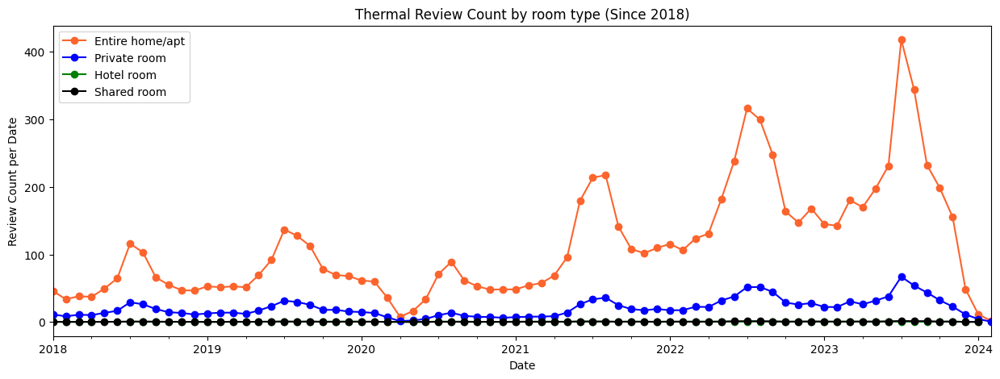

In [ ]:
# 숙소 유형별 Thermal 관련 리뷰수
entire_room_df_2018 = entire_room_df[entire_room_df['date'] >= '2018-01-01']
date_thermal = entire_room_df_2018[entire_room_df_2018['Thermal'] == 1]
monthly_thermal_count = date_thermal.groupby(date_thermal['date'].dt.to_period('M')).size()
monthly_avg_thermal_1 = monthly_thermal_count.groupby(monthly_thermal_count.index.to_timestamp()).mean() / 30

private_room_df_2018 = private_room_df[private_room_df['date'] >= '2018-01-01']
date_thermal = private_room_df_2018[private_room_df_2018['Thermal'] == 1]
monthly_thermal_count = date_thermal.groupby(date_thermal['date'].dt.to_period('M')).size()
monthly_avg_thermal_2 = monthly_thermal_count.groupby(monthly_thermal_count.index.to_timestamp()).mean() / 30

hotel_room_df_2018 = hotel_room_df[hotel_room_df['date'] >= '2018-01-01']
date_thermal = hotel_room_df_2018[hotel_room_df_2018['Thermal'] == 1]
monthly_thermal_count = date_thermal.groupby(date_thermal['date'].dt.to_period('M')).size()
monthly_avg_thermal_3 = monthly_thermal_count.groupby(monthly_thermal_count.index.to_timestamp()).mean() / 30

shared_room_df_2018 = shared_room_df[shared_room_df['date'] >= '2018-01-01']
date_thermal = shared_room_df_2018[shared_room_df_2018['Thermal'] == 1]
monthly_thermal_count = date_thermal.groupby(date_thermal['date'].dt.to_period('M')).size()
monthly_avg_thermal_4 = monthly_thermal_count.groupby(monthly_thermal_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
monthly_avg_thermal_1.plot(color='#FC642D', marker='o', linestyle='-', label='Entire home/apt')
monthly_avg_thermal_2.plot(color='blue', marker='o', linestyle='-', label='Private room')
monthly_avg_thermal_3.plot(color='green', marker='o', linestyle='-', label='Hotel room')
monthly_avg_thermal_4.plot(color='black', marker='o', linestyle='-', label='Shared room')

plt.title('Thermal Review Count by room type (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


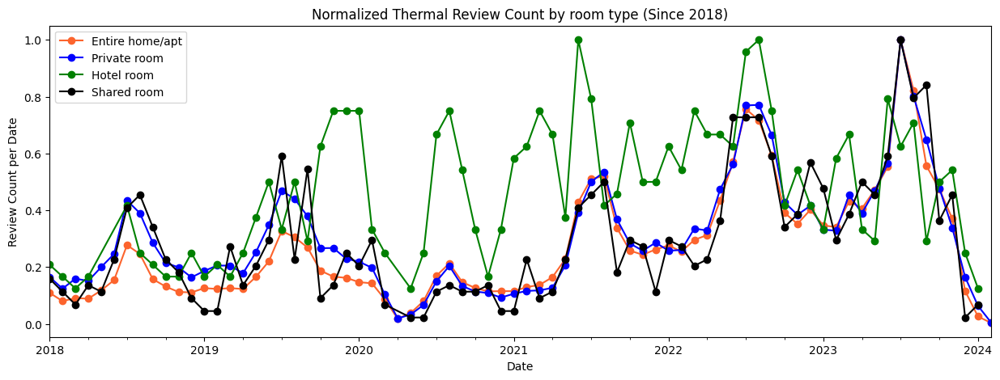

In [ ]:
# 정규화를 시켜 숙소 유형별 시간에 따른 변화 비교- -> 유독 Hotel만 추세선이 다름.. Why?
norm_monthly_avg_thermal_1 = monthly_avg_thermal_1 / monthly_avg_thermal_1.max()
norm_monthly_avg_thermal_2 = monthly_avg_thermal_2 / monthly_avg_thermal_2.max()
norm_monthly_avg_thermal_3 = monthly_avg_thermal_3 / monthly_avg_thermal_3.max()
norm_monthly_avg_thermal_4 = monthly_avg_thermal_4 / monthly_avg_thermal_4.max()

plt.figure(figsize=(15, 5))
norm_monthly_avg_thermal_1.plot(color='#FC642D', marker='o', linestyle='-', label='Entire home/apt')
norm_monthly_avg_thermal_2.plot(color='blue', marker='o', linestyle='-', label='Private room')
norm_monthly_avg_thermal_3.plot(color='green', marker='o', linestyle='-', label='Hotel room')
norm_monthly_avg_thermal_4.plot(color='black', marker='o', linestyle='-', label='Shared room')

plt.title('Normalized Thermal Review Count by room type (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show() # Thermal 관련 리뷰에서 Hotel만 추세선이 다름

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


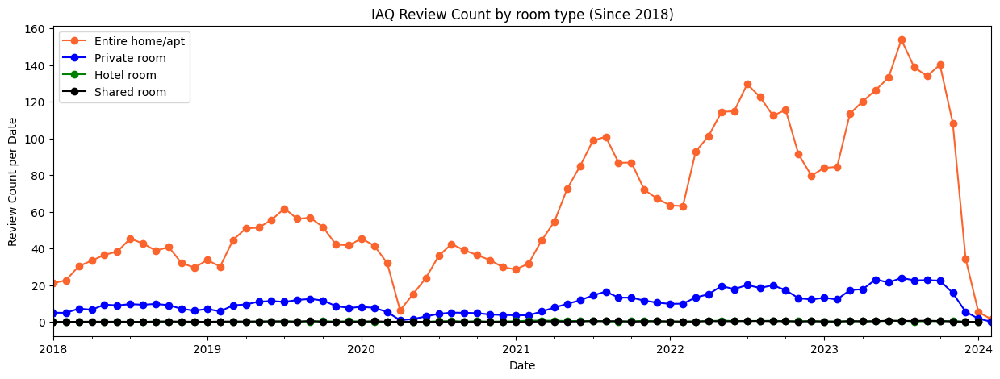

In [ ]:
date_IAQ = entire_room_df_2018[entire_room_df_2018['IAQ'] == 1]
monthly_IAQ_count = date_IAQ.groupby(date_IAQ['date'].dt.to_period('M')).size()
monthly_avg_IAQ_1 = monthly_IAQ_count.groupby(monthly_IAQ_count.index.to_timestamp()).mean() / 30

date_IAQ = private_room_df_2018[private_room_df_2018['IAQ'] == 1]
monthly_IAQ_count = date_IAQ.groupby(date_IAQ['date'].dt.to_period('M')).size()
monthly_avg_IAQ_2 = monthly_IAQ_count.groupby(monthly_IAQ_count.index.to_timestamp()).mean() / 30

date_IAQ = hotel_room_df_2018[hotel_room_df_2018['IAQ'] == 1]
monthly_IAQ_count = date_IAQ.groupby(date_IAQ['date'].dt.to_period('M')).size()
monthly_avg_IAQ_3 = monthly_IAQ_count.groupby(monthly_IAQ_count.index.to_timestamp()).mean() / 30

date_IAQ = shared_room_df_2018[shared_room_df_2018['IAQ'] == 1]
monthly_IAQ_count = date_IAQ.groupby(date_IAQ['date'].dt.to_period('M')).size()
monthly_avg_IAQ_4 = monthly_IAQ_count.groupby(monthly_IAQ_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
monthly_avg_IAQ_1.plot(color='#FC642D', marker='o', linestyle='-', label='Entire home/apt')
monthly_avg_IAQ_2.plot(color='blue', marker='o', linestyle='-', label='Private room')
monthly_avg_IAQ_3.plot(color='green', marker='o', linestyle='-', label='Hotel room')
monthly_avg_IAQ_4.plot(color='black', marker='o', linestyle='-', label='Shared room')

plt.title('IAQ Review Count by room type (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


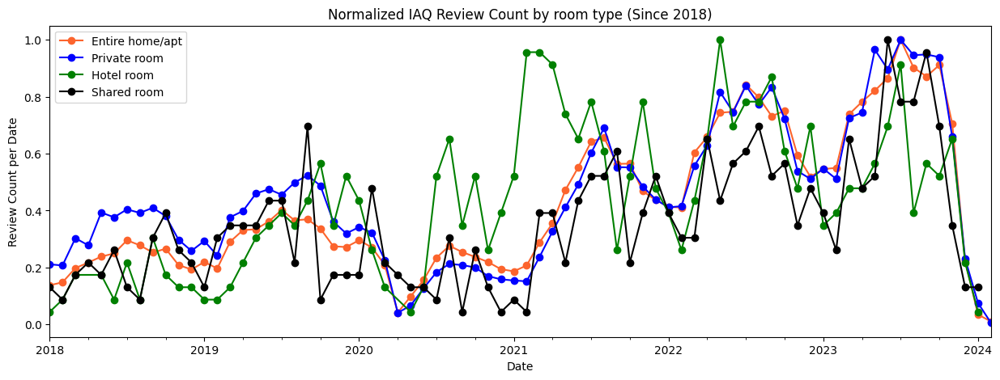

In [ ]:
norm_monthly_avg_IAQ_1 = monthly_avg_IAQ_1 / monthly_avg_IAQ_1.max()
norm_monthly_avg_IAQ_2 = monthly_avg_IAQ_2 / monthly_avg_IAQ_2.max()
norm_monthly_avg_IAQ_3 = monthly_avg_IAQ_3 / monthly_avg_IAQ_3.max()
norm_monthly_avg_IAQ_4 = monthly_avg_IAQ_4 / monthly_avg_IAQ_4.max()

plt.figure(figsize=(15, 5))
norm_monthly_avg_IAQ_1.plot(color='#FC642D', marker='o', linestyle='-', label='Entire home/apt')
norm_monthly_avg_IAQ_2.plot(color='blue', marker='o', linestyle='-', label='Private room')
norm_monthly_avg_IAQ_3.plot(color='green', marker='o', linestyle='-', label='Hotel room')
norm_monthly_avg_IAQ_4.plot(color='black', marker='o', linestyle='-', label='Shared room')

plt.title('Normalized IAQ Review Count by room type (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


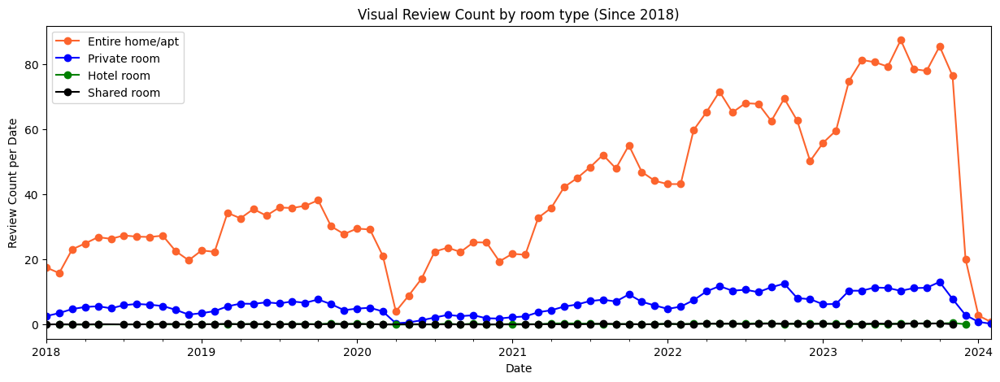

In [ ]:
date_Visual = entire_room_df_2018[entire_room_df_2018['Visual'] == 1]
monthly_Visual_count = date_Visual.groupby(date_Visual['date'].dt.to_period('M')).size()
monthly_avg_Visual_1 = monthly_Visual_count.groupby(monthly_Visual_count.index.to_timestamp()).mean() / 30

date_Visual = private_room_df_2018[private_room_df_2018['Visual'] == 1]
monthly_Visual_count = date_Visual.groupby(date_Visual['date'].dt.to_period('M')).size()
monthly_avg_Visual_2 = monthly_Visual_count.groupby(monthly_Visual_count.index.to_timestamp()).mean() / 30

date_Visual = hotel_room_df_2018[hotel_room_df_2018['Visual'] == 1]
monthly_Visual_count = date_Visual.groupby(date_Visual['date'].dt.to_period('M')).size()
monthly_avg_Visual_3 = monthly_Visual_count.groupby(monthly_Visual_count.index.to_timestamp()).mean() / 30

date_Visual = shared_room_df_2018[shared_room_df_2018['Visual'] == 1]
monthly_Visual_count = date_Visual.groupby(date_Visual['date'].dt.to_period('M')).size()
monthly_avg_Visual_4 = monthly_Visual_count.groupby(monthly_Visual_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
monthly_avg_Visual_1.plot(color='#FC642D', marker='o', linestyle='-', label='Entire home/apt')
monthly_avg_Visual_2.plot(color='blue', marker='o', linestyle='-', label='Private room')
monthly_avg_Visual_3.plot(color='green', marker='o', linestyle='-', label='Hotel room')
monthly_avg_Visual_4.plot(color='black', marker='o', linestyle='-', label='Shared room')

plt.title('Visual Review Count by room type (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


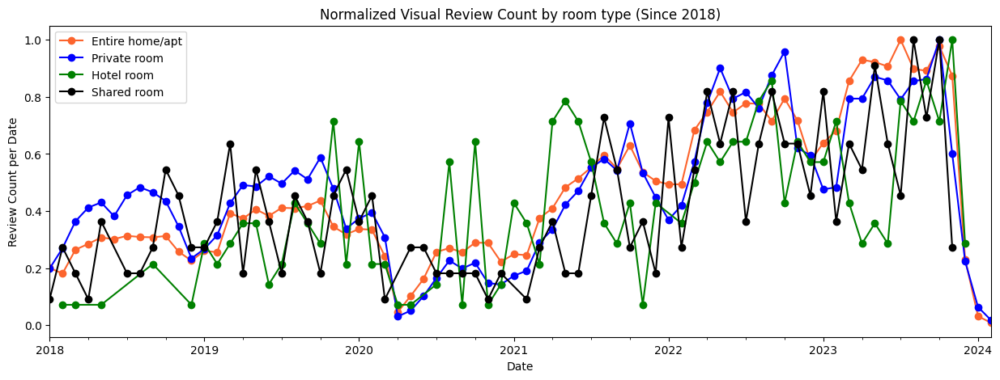

In [ ]:
norm_monthly_avg_Visual_1 = monthly_avg_Visual_1 / monthly_avg_Visual_1.max()
norm_monthly_avg_Visual_2 = monthly_avg_Visual_2 / monthly_avg_Visual_2.max()
norm_monthly_avg_Visual_3 = monthly_avg_Visual_3 / monthly_avg_Visual_3.max()
norm_monthly_avg_Visual_4 = monthly_avg_Visual_4 / monthly_avg_Visual_4.max()

plt.figure(figsize=(15, 5))
norm_monthly_avg_Visual_1.plot(color='#FC642D', marker='o', linestyle='-', label='Entire home/apt')
norm_monthly_avg_Visual_2.plot(color='blue', marker='o', linestyle='-', label='Private room')
norm_monthly_avg_Visual_3.plot(color='green', marker='o', linestyle='-', label='Hotel room')
norm_monthly_avg_Visual_4.plot(color='black', marker='o', linestyle='-', label='Shared room')

plt.title('Normalized Visual Review Count by room type (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


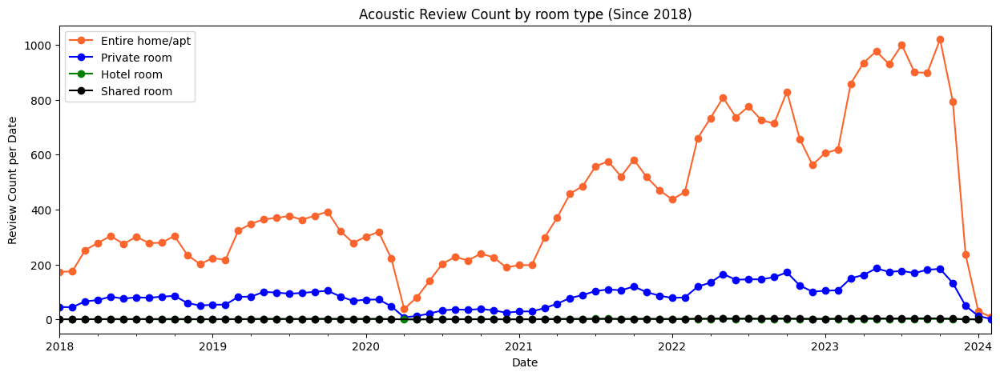

In [ ]:
date_Acoustic = entire_room_df_2018[entire_room_df_2018['Acoustic'] == 1]
monthly_Acoustic_count = date_Acoustic.groupby(date_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_Acoustic_1 = monthly_Acoustic_count.groupby(monthly_Acoustic_count.index.to_timestamp()).mean() / 30

date_Acoustic = private_room_df_2018[private_room_df_2018['Acoustic'] == 1]
monthly_Acoustic_count = date_Acoustic.groupby(date_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_Acoustic_2 = monthly_Acoustic_count.groupby(monthly_Acoustic_count.index.to_timestamp()).mean() / 30

date_Acoustic = hotel_room_df_2018[hotel_room_df_2018['Acoustic'] == 1]
monthly_Acoustic_count = date_Acoustic.groupby(date_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_Acoustic_3 = monthly_Acoustic_count.groupby(monthly_Acoustic_count.index.to_timestamp()).mean() / 30

date_Acoustic = shared_room_df_2018[shared_room_df_2018['Acoustic'] == 1]
monthly_Acoustic_count = date_Acoustic.groupby(date_Acoustic['date'].dt.to_period('M')).size()
monthly_avg_Acoustic_4 = monthly_Acoustic_count.groupby(monthly_Acoustic_count.index.to_timestamp()).mean() / 30

plt.figure(figsize=(15, 5))
monthly_avg_Acoustic_1.plot(color='#FC642D', marker='o', linestyle='-', label='Entire home/apt')
monthly_avg_Acoustic_2.plot(color='blue', marker='o', linestyle='-', label='Private room')
monthly_avg_Acoustic_3.plot(color='green', marker='o', linestyle='-', label='Hotel room')
monthly_avg_Acoustic_4.plot(color='black', marker='o', linestyle='-', label='Shared room')

plt.title('Acoustic Review Count by room type (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


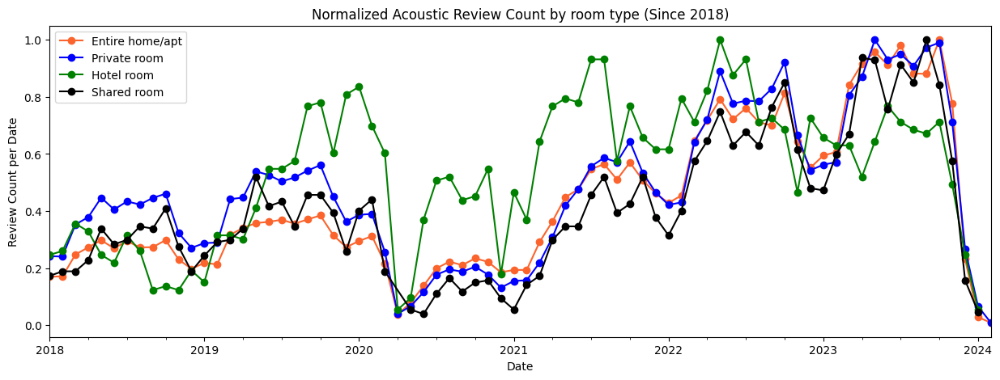

In [ ]:
norm_monthly_avg_Acoustic_1 = monthly_avg_Acoustic_1 / monthly_avg_Acoustic_1.max()
norm_monthly_avg_Acoustic_2 = monthly_avg_Acoustic_2 / monthly_avg_Acoustic_2.max()
norm_monthly_avg_Acoustic_3 = monthly_avg_Acoustic_3 / monthly_avg_Acoustic_3.max()
norm_monthly_avg_Acoustic_4 = monthly_avg_Acoustic_4 / monthly_avg_Acoustic_4.max()

plt.figure(figsize=(15, 5))
norm_monthly_avg_Acoustic_1.plot(color='#FC642D', marker='o', linestyle='-', label='Entire home/apt')
norm_monthly_avg_Acoustic_2.plot(color='blue', marker='o', linestyle='-', label='Private room')
norm_monthly_avg_Acoustic_3.plot(color='green', marker='o', linestyle='-', label='Hotel room')
norm_monthly_avg_Acoustic_4.plot(color='black', marker='o', linestyle='-', label='Shared room')

plt.title('Normalized Acoustic Review Count by room type (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

### 4.1.2. 계절로 구간화해서 IEQ 리뷰수 차이 보기

In [ ]:
winter_entire_room_df = entire_room_df[(entire_room_df['date'].dt.month == 12) | (entire_room_df['date'].dt.month <= 2)]
spring_entire_room_df = entire_room_df[(entire_room_df['date'].dt.month >= 3) & (entire_room_df['date'].dt.month <= 5)]
summer_entire_room_df = entire_room_df[(entire_room_df['date'].dt.month >= 6) & (entire_room_df['date'].dt.month <= 8)]
fall_entire_room_df = entire_room_df[(entire_room_df['date'].dt.month >= 9) & (entire_room_df['date'].dt.month <= 11)]

winter_private_room_df = private_room_df[(private_room_df['date'].dt.month == 12) | (private_room_df['date'].dt.month <= 2)]
spring_private_room_df = private_room_df[(private_room_df['date'].dt.month >= 3) & (private_room_df['date'].dt.month <= 5)]
summer_private_room_df = private_room_df[(private_room_df['date'].dt.month >= 6) & (private_room_df['date'].dt.month <= 8)]
fall_private_room_df = private_room_df[(private_room_df['date'].dt.month >= 9) & (private_room_df['date'].dt.month <= 11)]

winter_hotel_room_df = hotel_room_df[(hotel_room_df['date'].dt.month == 12) | (hotel_room_df['date'].dt.month <= 2)]
spring_hotel_room_df = hotel_room_df[(hotel_room_df['date'].dt.month >= 3) & (hotel_room_df['date'].dt.month <= 5)]
summer_hotel_room_df = hotel_room_df[(hotel_room_df['date'].dt.month >= 6) & (hotel_room_df['date'].dt.month <= 8)]
fall_hotel_room_df = hotel_room_df[(hotel_room_df['date'].dt.month >= 9) & (hotel_room_df['date'].dt.month <= 11)]

winter_shared_room_df = shared_room_df[(shared_room_df['date'].dt.month == 12) | (shared_room_df['date'].dt.month <= 2)]
spring_shared_room_df = shared_room_df[(shared_room_df['date'].dt.month >= 3) & (shared_room_df['date'].dt.month <= 5)]
summer_shared_room_df = shared_room_df[(shared_room_df['date'].dt.month >= 6) & (shared_room_df['date'].dt.month <= 8)]
fall_shared_room_df = shared_room_df[(shared_room_df['date'].dt.month >= 9) & (shared_room_df['date'].dt.month <= 11)]

In [ ]:
# 공간별 계절에 따른 리뷰수
winter_reviews = [winter_entire_room_df.shape[0], winter_private_room_df.shape[0], winter_hotel_room_df.shape[0], winter_shared_room_df.shape[0]]
spring_reviews = [spring_entire_room_df.shape[0], spring_private_room_df.shape[0], spring_hotel_room_df.shape[0], spring_shared_room_df.shape[0]]
summer_reviews = [summer_entire_room_df.shape[0], summer_private_room_df.shape[0], summer_hotel_room_df.shape[0], summer_shared_room_df.shape[0]]
fall_reviews = [fall_entire_room_df.shape[0], fall_private_room_df.shape[0], fall_hotel_room_df.shape[0], fall_shared_room_df.shape[0]]

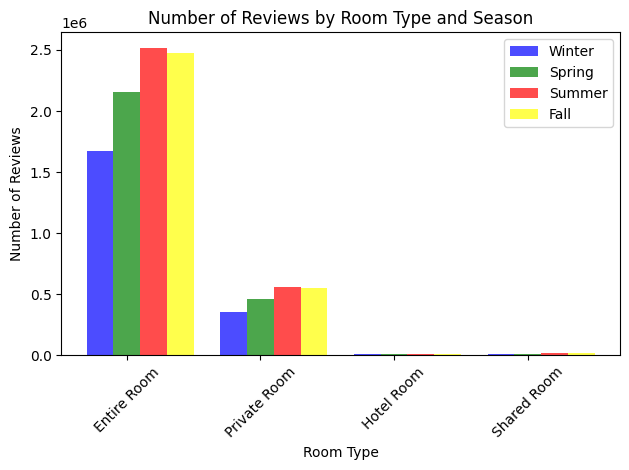

In [ ]:
labels = ['Entire Room', 'Private Room', 'Hotel Room', 'Shared Room']
x = range(len(labels))  # x축 좌표

fig, ax = plt.subplots()

bar_width = 0.2  # 바의 너비
opacity = 0.7  # 바의 투명도

rects1 = ax.bar(x, winter_reviews, bar_width, alpha=opacity, label='Winter', color='blue')
rects2 = ax.bar([p + bar_width for p in x], spring_reviews, bar_width, alpha=opacity, label='Spring' , color='green')
rects3 = ax.bar([p + bar_width*2 for p in x], summer_reviews, bar_width, alpha=opacity, label='Summer' , color='red')
rects4 = ax.bar([p + bar_width*3 for p in x], fall_reviews, bar_width, alpha=opacity, label='Fall', color='yellow')

ax.set_xlabel('Room Type')
ax.set_ylabel('Number of Reviews')
ax.set_title('Number of Reviews by Room Type and Season')
ax.set_xticks([p + bar_width for p in x])
ax.set_xticklabels(labels)
ax.legend()

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

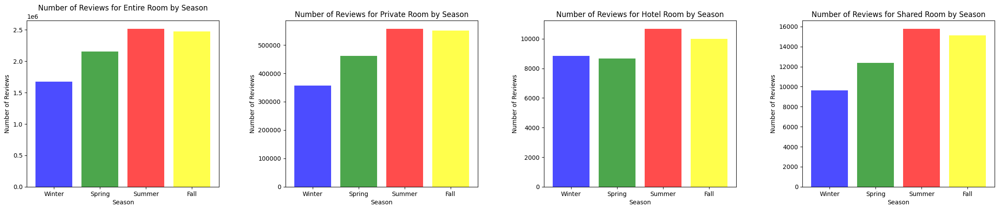

In [ ]:
room_types = ['Entire Room', 'Private Room', 'Hotel Room', 'Shared Room']
season_reviews = {
    'Winter': winter_reviews,
    'Spring': spring_reviews,
    'Summer': summer_reviews,
    'Fall': fall_reviews
}

fig, axs = plt.subplots(1, 4, figsize=(24, 6))

for i, ax in enumerate(axs.flatten()):
    room_type = room_types[i]
    reviews = [season_reviews['Winter'][i], season_reviews['Spring'][i], season_reviews['Summer'][i], season_reviews['Fall'][i]]
    seasons = list(season_reviews.keys())

    ax.bar(seasons, reviews, color=['b', 'g', 'r', 'yellow'], alpha=0.7)
    ax.set_xlabel('Season')
    ax.set_ylabel('Number of Reviews')
    ax.set_title(f'Number of Reviews for {room_type} by Season')

plt.tight_layout(pad=5.0)
plt.show() # 호텔만 겨울과 봄 사이 리뷰수 차이가 거의 나타나지 않음

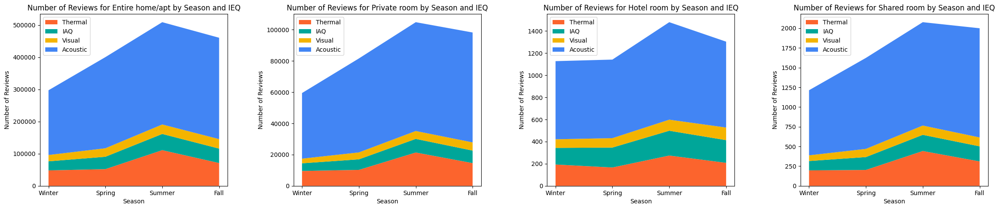

In [ ]:
def calculate_ieq_counts(df):
    thermal_count = df[df['Thermal'] == 1].shape[0]
    iaq_count = df[df['IAQ'] == 1].shape[0]
    visual_count = df[df['Visual'] == 1].shape[0]
    acoustic_count = df[df['Acoustic'] == 1].shape[0]
    return [thermal_count, iaq_count, visual_count, acoustic_count]

def plot_stackplot(ax, seasons, ieq_counts, title):
    ieq_categories = list(zip(*ieq_counts))
    ax.stackplot(seasons, ieq_categories, labels=['Thermal', 'IAQ', 'Visual', 'Acoustic'], colors=['#FC642D', '#00A699', '#F4B400', '#4285F4'])

    ax.set_xlabel('Season')
    ax.set_ylabel('Number of Reviews')
    ax.set_title(title)
    ax.legend(loc='upper left')

dfs = {
    "Entire home/apt": [winter_entire_room_df, spring_entire_room_df, summer_entire_room_df, fall_entire_room_df],
    "Private room": [winter_private_room_df, spring_private_room_df, summer_private_room_df, fall_private_room_df],
    "Hotel room": [winter_hotel_room_df, spring_hotel_room_df, summer_hotel_room_df, fall_hotel_room_df],
    "Shared room": [winter_shared_room_df, spring_shared_room_df, summer_shared_room_df, fall_shared_room_df],
}

seasons = ['Winter', 'Spring', 'Summer', 'Fall']

fig, axs = plt.subplots(1, 4, figsize=(24, 6))

for i, (room_type, season_dfs) in enumerate(dfs.items()):
    ieq_counts = [calculate_ieq_counts(df) for df in season_dfs]
    plot_stackplot(axs[i], seasons, ieq_counts, f'Number of Reviews for {room_type} by Season and IEQ')

plt.tight_layout(pad=5.0)
plt.show()

In [ ]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

def calculate_ieq_counts(df):
    thermal_count = df[df['Thermal'] == 1].shape[0]
    iaq_count = df[df['IAQ'] == 1].shape[0]
    visual_count = df[df['Visual'] == 1].shape[0]
    acoustic_count = df[df['Acoustic'] == 1].shape[0]
    return [thermal_count, iaq_count, visual_count, acoustic_count]

dfs = {
    "Entire home/apt": [winter_entire_room_df, spring_entire_room_df, summer_entire_room_df, fall_entire_room_df],
    "Private room": [winter_private_room_df, spring_private_room_df, summer_private_room_df, fall_private_room_df],
    "Hotel room": [winter_hotel_room_df, spring_hotel_room_df, summer_hotel_room_df, fall_hotel_room_df],
    "Shared room": [winter_shared_room_df, spring_shared_room_df, summer_shared_room_df, fall_shared_room_df],
}

seasons = ['Winter', 'Spring', 'Summer', 'Fall']

colors = {
    'Thermal': '#FC642D',
    'IAQ': '#00A699',
    'Visual': '#F4B400',
    'Acoustic': '#4285F4'
}

fig = make_subplots(rows=1, cols=4, subplot_titles=list(dfs.keys()))

In [ ]:
for i, (room_type, season_dfs) in enumerate(dfs.items(), start=1):
    ieq_counts = [calculate_ieq_counts(df) for df in season_dfs]
    thermal_counts, iaq_counts, visual_counts, acoustic_counts = zip(*ieq_counts)

    showlegend = i == 1
    fig.add_trace(go.Scatter(x=seasons, y=thermal_counts, mode='lines', name='Thermal', stackgroup='one', line=dict(color=colors['Thermal']), showlegend=showlegend), row=1, col=i)
    fig.add_trace(go.Scatter(x=seasons, y=iaq_counts, mode='lines', name='IAQ', stackgroup='one', line=dict(color=colors['IAQ']), showlegend=showlegend), row=1, col=i)
    fig.add_trace(go.Scatter(x=seasons, y=visual_counts, mode='lines', name='Visual', stackgroup='one', line=dict(color=colors['Visual']), showlegend=showlegend), row=1, col=i)
    fig.add_trace(go.Scatter(x=seasons, y=acoustic_counts, mode='lines', name='Acoustic', stackgroup='one', line=dict(color=colors['Acoustic']), showlegend=showlegend), row=1, col=i)

fig.update_layout(
    title="Number of Reviews by Season and IEQ for Different Room Types",
    xaxis_title="Season",
    yaxis_title="Number of Reviews",
    hovermode='x unified',
    showlegend=True
)

for i in range(1, 5):
    fig.update_xaxes(title_text="Season", row=1, col=i)

fig.update_yaxes(title_text="Number of Reviews", row=1, col=1)
fig.show()

In [ ]:
for i, (room_type, season_dfs) in enumerate(dfs.items(), start=1):
    ieq_counts = [calculate_ieq_counts(df) for df in season_dfs]
    thermal_counts, iaq_counts, visual_counts, acoustic_counts = zip(*ieq_counts)

    showlegend = i == 1
    fig.add_trace(go.Scatter(x=seasons, y=thermal_counts, mode='lines', name='Thermal', stackgroup='one', line=dict(color=colors['Thermal']), showlegend=showlegend), row=1, col=i)
    fig.add_trace(go.Scatter(x=seasons, y=iaq_counts, mode='lines', name='IAQ', stackgroup='one', line=dict(color=colors['IAQ']), showlegend=showlegend), row=1, col=i)
    fig.add_trace(go.Scatter(x=seasons, y=visual_counts, mode='lines', name='Visual', stackgroup='one', line=dict(color=colors['Visual']), showlegend=showlegend), row=1, col=i)
    fig.add_trace(go.Scatter(x=seasons, y=acoustic_counts, mode='lines', name='Acoustic', stackgroup='one', line=dict(color=colors['Acoustic']), showlegend=showlegend), row=1, col=i)

fig.update_layout(
    title="Number of Reviews by Season and IEQ for Different Room Types",
    xaxis_title="Season",
    yaxis_title="Number of Reviews",
    hovermode='x unified',
    showlegend=True
)

for i in range(1, 5):
    fig.update_xaxes(title_text="Season", row=1, col=i)

fig.update_yaxes(title_text="Number of Reviews", row=1, col=1)
fig.show()

In [ ]:
# # 겨울 Entire home/apt의 IEQ count
# winter_entire_room_Thermal = winter_entire_room_df[winter_entire_room_df['Thermal'] == 1].shape[0]
# winter_entire_room_IAQ = winter_entire_room_df[winter_entire_room_df['IAQ'] == 1].shape[0]
# winter_entire_room_Visual = winter_entire_room_df[winter_entire_room_df['Visual'] == 1].shape[0]
# winter_entire_room_Acoustic = winter_entire_room_df[winter_entire_room_df['Acoustic'] == 1].shape[0]

# # 봄 Entire home/apt의 IEQ count
# spring_entire_room_Thermal = spring_entire_room_df[spring_entire_room_df['Thermal'] == 1].shape[0]
# spring_entire_room_IAQ = spring_entire_room_df[spring_entire_room_df['IAQ'] == 1].shape[0]
# spring_entire_room_Visual = spring_entire_room_df[spring_entire_room_df['Visual'] == 1].shape[0]
# spring_entire_room_Acoustic = spring_entire_room_df[spring_entire_room_df['Acoustic'] == 1].shape[0]

# # 여름 Entire home/apt의 IEQ count
# summer_entire_room_Thermal = summer_entire_room_df[summer_entire_room_df['Thermal'] == 1].shape[0]
# summer_entire_room_IAQ = summer_entire_room_df[summer_entire_room_df['IAQ'] == 1].shape[0]
# summer_entire_room_Visual = summer_entire_room_df[summer_entire_room_df['Visual'] == 1].shape[0]
# summer_entire_room_Acoustic = summer_entire_room_df[summer_entire_room_df['Acoustic'] == 1].shape[0]

# # 가을 Entire home/apt의 IEQ count
# fall_entire_room_Thermal = fall_entire_room_df[fall_entire_room_df['Thermal'] == 1].shape[0]
# fall_entire_room_IAQ = fall_entire_room_df[fall_entire_room_df['IAQ'] == 1].shape[0]
# fall_entire_room_Visual = fall_entire_room_df[fall_entire_room_df['Visual'] == 1].shape[0]
# fall_entire_room_Acoustic = fall_entire_room_df[fall_entire_room_df['Acoustic'] == 1].shape[0]

In [ ]:
# def calculate_ieq_counts(df):
#     thermal_count = df[df['Thermal'] == 1].shape[0]
#     iaq_count = df[df['IAQ'] == 1].shape[0]
#     visual_count = df[df['Visual'] == 1].shape[0]
#     acoustic_count = df[df['Acoustic'] == 1].shape[0]
#     return [thermal_count, iaq_count, visual_count, acoustic_count]

# def plot_stackplot(seasons, ieq_counts, title):
#     ieq_categories = list(zip(*ieq_counts))
#     fig, ax = plt.subplots(figsize=(10, 6))
#     ax.stackplot(seasons, ieq_categories, labels=['Thermal', 'IAQ', 'Visual', 'Acoustic'], colors=['#FC642D', '#00A699', '#F4B400', '#4285F4'])

#     ax.set_xlabel('Season')
#     ax.set_ylabel('Number of Reviews')
#     ax.set_title(title)
#     ax.legend(loc='upper left')

#     plt.tight_layout()
#     plt.show()

# # 데이터프레임 리스트 및 타이틀
# dfs = {
#     "Entire home/apt": [winter_entire_room_df, spring_entire_room_df, summer_entire_room_df, fall_entire_room_df],
#     "Shared room": [winter_shared_room_df, spring_shared_room_df, summer_shared_room_df, fall_shared_room_df],
#     "Hotel room": [winter_hotel_room_df, spring_hotel_room_df, summer_hotel_room_df, fall_hotel_room_df],
#     "Private room": [winter_private_room_df, spring_private_room_df, summer_private_room_df, fall_private_room_df]
# }

# seasons = ['Winter', 'Spring', 'Summer', 'Fall']

# # 각 공간에 대해 시각화
# for room_type, season_dfs in dfs.items():
#     ieq_counts = [calculate_ieq_counts(df) for df in season_dfs]
#     plot_stackplot(seasons, ieq_counts, f'Number of Reviews for {room_type} by Season and IEQ')

## 4.2. 도시별 시간에 따른 IEQ 차이

In [ ]:
airbnb_df['City'].unique() # 34개의 도시가 있음

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


array(['Broward County, Florida', 'Hawaii, Hawaii', 'Fort Worth, Texas',
       'Dallas, Texas', 'Clark County, NV, Nevada', 'Austin, Texas',
       'New Orleans, Louisiana', 'Los Angeles, California',
       'Nashville, Tennessee', 'Oakland, California',
       'San Diego, California', 'San Mateo County, California',
       'Santa Clara County, California', 'Santa Cruz County, California',
       'Jersey City, New Jersey', 'Cambridge, Massachusetts',
       'Asheville, North Carolina', 'Columbus, Ohio',
       'New York City, New York', 'Newark, New Jersey',
       'Pacific Grove, California', 'Portland, Oregon',
       'Rhode Island, Rhode Island', 'Salem, OR, Oregon',
       'San Francisco, California', 'Seattle, Washington',
       'Washington, DC, District of Columbia', 'Boston, Massachusetts',
       'Chicago, Illinois', 'Denver, Colorado', 'Rochester, New York',
       'Albany, New York', 'Bozeman, Montana',
       'Twin Cities MSA, Minnesota'], dtype=object)

In [ ]:
browardCounty_Florida_df = airbnb_df[airbnb_df['City'] == 'Broward County, Florida']
hawaii_hawaii_df = airbnb_df[airbnb_df['City'] == 'Hawaii, Hawaii']
fortWorth_Texas_df = airbnb_df[airbnb_df['City'] == 'Fort Worth, Texas']
losAngelesCounty_California_df = airbnb_df[airbnb_df['City'] == 'Los Angeles County, California']

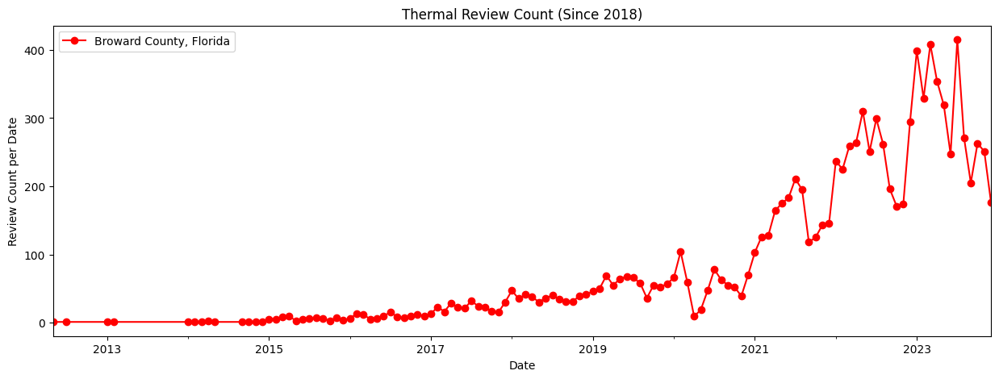

In [ ]:
date_thermal = browardCounty_Florida_df[browardCounty_Florida_df['Thermal'] == 1]
monthly_thermal_count_1 = date_thermal.groupby(date_thermal['date'].dt.to_period('M')).size()

plt.figure(figsize=(15, 5))
monthly_thermal_count_1.plot(color='red', marker='o', linestyle='-', label='Broward County, Florida')

plt.title('Thermal Review Count (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

In [ ]:
norm_monthly_thermal_count_1 = monthly_thermal_count_1 / monthly_thermal_count_1.max()

plt.figure(figsize=(15, 5))
norm_monthly_avg_thermal_1.plot(color='red', marker='o', linestyle='-', label='Broward County, Florida')

plt.title('Normalized Thermal Review Count (Since 2018)')
plt.xlabel('Date')
plt.ylabel('Review Count per Date')
plt.legend()
plt.show()

## 4.3. 기후별 시간에 따른  IEQ 차이

In [ ]:
zone_1_df = airbnb_df[airbnb_df['Zone'] == 1]
zone_2_df = airbnb_df[airbnb_df['Zone'] == 2]
zone_3_df = airbnb_df[airbnb_df['Zone'] == 3]
zone_4_df = airbnb_df[airbnb_df['Zone'] == 4]
zone_5_df = airbnb_df[airbnb_df['Zone'] == 5]
zone_6_df = airbnb_df[airbnb_df['Zone'] == 6]

In [ ]:
import plotly.graph_objs as go
labels = ['Zone 1', 'Zone 2', 'Zone 3', 'Zone 4', 'Zone 5', 'Zone 6']
sizes = [zone_1_df.shape[0], zone_2_df.shape[0], zone_3_df.shape[0], zone_4_df.shape[0], zone_5_df.shape[0], zone_6_df.shape[0]]
colors = ['salmon', 'orange', 'lightgreen', 'lightseagreen', 'skyblue', 'cornflowerblue']

trace = go.Bar(
    x=labels,
    y=sizes,
    marker=dict(color=colors)
)

layout = go.Layout(
    title='Number of Reviews by Zone',
    xaxis=dict(title='Zone'),
    yaxis=dict(title='Number of Reviews'),
    width=1200,  # 그래프 너비
    height=400,  # 그래프 높이
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()

In [ ]:
!pip install folium geopandas

In [ ]:
import folium
import geopandas as gpd

url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data/us-states.json'
states = gpd.read_file(url)

zone_mapping = {
    'Zone 1': ['Florida', 'Hawaii'],
    'Zone 2': ['Alabama', 'Arizona', 'Arkansas', 'California', 'Georgia', 'Louisiana', 'Mississippi', 'New Mexico', 'Oklahoma', 'South Carolina', 'Texas'],
    'Zone 3': ['Tennessee', 'North Carolina', 'South Carolina', 'California', 'Nevada', 'Texas', 'Arkansas', 'Mississippi', 'Louisiana', 'Georgia', 'Alabama'],
    'Zone 4': ['Washington, DC', 'Delaware', 'Kentucky', 'Maryland', 'Missouri', 'North Carolina', 'Tennessee', 'Virginia', 'West Virginia', 'New Jersey', 'Pennsylvania', 'Oregon'],
    'Zone 5': ['Colorado', 'Illinois', 'Indiana', 'Iowa', 'Kansas', 'Kentucky', 'Missouri', 'Nebraska', 'Nevada', 'Ohio', 'Pennsylvania', 'Utah', 'Virginia', 'West Virginia', 'Oregon'],
    'Zone 6': ['Idaho', 'Maine', 'Michigan', 'Minnesota', 'Montana', 'New Hampshire', 'New York', 'North Dakota', 'South Dakota', 'Vermont', 'Wisconsin'],
    # 'Zone 7': ['Alaska', 'Minnesota', 'North Dakota', 'Montana', 'Wisconsin'],
    # 'Zone 8': ['Alaska']
}

states['zone'] = states['name'].apply(
    lambda x: next((zone for zone, states in zone_mapping.items() if x in states), 'Unknown'))

colors = ['salmon', 'orange', 'lightgreen', 'lightseagreen', 'skyblue', 'cornflowerblue']
zone_colors = {
    'Zone 1': 'salmon',
    'Zone 2': 'orange',
    'Zone 3': 'lightgreen',
    'Zone 4': 'lightseagreen',
    'Zone 5': 'skyblue',
    'Zone 6': 'cornflowerblue',
    'Unknown': 'lightgrey'
}

m = folium.Map(location=[37.8, -96], zoom_start=4)

folium.GeoJson(
    states,
    style_function=lambda feature: {
        'fillColor': zone_colors[feature['properties']['zone']],
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.6,
    }
).add_to(m)

folium.LayerControl().add_to(m)
m

# 5️⃣ IEQ는 소비자 만족도(별점, 감정)와 가격에 얼마나 영향을 미칠까?

건물 환경 평가, 가치에 있어 IEQ의 중요도

In [ ]:
total_room_num = airbnb_df['id'].nunique()
dup_room_num = non_ieq_df['id'].nunique() + ieq_df['id'].nunique() - airbnb_df['id'].nunique()
print(f'{total_room_num}개의 전체 숙소 중 {dup_room_num}개가 IEQ 리뷰와 IEQ-irrelated리뷰를 모두 가지고 있다({round(dup_room_num/total_room_num * 100, 4)}%).')

181266개의 전체 숙소 중 140012개가 IEQ 리뷰와 IEQ-irrelated리뷰를 모두 가지고 있다(77.2412%).


## 5.0. 감정분석

두 개의 모델을 사용해 리뷰들의 감정을 숫자로 표시. 100은 매우 긴 열로 모델이 처리하지 못한 리뷰임

### 5.0.1. 감정분석 V1 [Binary Classification]

V1 모델을 통한 'Sentiment_2'는 이진분류로 1은 긍정, 0은 부정을 나타냄

---

**SST-2에서 Fine-tuned된 DistilBERT-base-uncased**

개발 세트에서 91.3의 정확도에 도달(Bert bert-base-uncased 버전은 92.7의 정확도에 도달)

모델 출처:

https://huggingface.co/distilbert/distilbert-base-uncased-finetuned-sst-2-english?text=Which+is+the+percentage+of+IEQ+complaints+in+online+job+reviews+compared+to+other+types+of+complaints+referring+to+the+working+environment%3F

In [ ]:
# DistilBERT를 이용한 감정 분석
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification

tokenizer = DistilBertTokenizer.from_pretrained("distilbert-base-uncased-finetuned-sst-2-english")
model = DistilBertForSequenceClassification.from_pretrained("distilbert-base-uncased-finetuned-sst-2-english")

def predict_sentiment(data):
    data['Sentiment_2'] = 0
    for i in tqdm(range(len(data))):
        inputs = tokenizer(data['comments'][i], return_tensors="pt")
        with torch.no_grad():
            if inputs['input_ids'][0].size()[0] > 512:
                continue
            else:
                logits = model(**inputs).logits
        predicted_class_id = logits.argmax().item()
        data.loc[i, 'Sentiment_2'] = model.config.id2label[predicted_class_id]
    return

In [ ]:
airbnb_df['Sentiment_2'].value_counts()

Sentiment_2
1      10120069
0        415997
100       12020
Name: count, dtype: int64

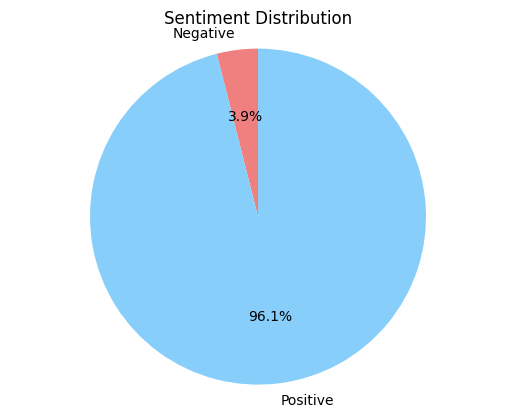

In [ ]:
labels = 'Negative', 'Positive'
sizes = [airbnb_df['Sentiment_2'].value_counts()[0], airbnb_df['Sentiment_2'].value_counts()[1]]
colors = ['lightcoral', 'lightskyblue']

fig, ax = plt.subplots()
ax.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=colors)
ax.axis('equal')
plt.title('Sentiment Distribution')
plt.show()

In [ ]:
ieq_df['Sentiment_2'].value_counts()

Sentiment_2
1      1610969
0       156262
100       8031
Name: count, dtype: int64

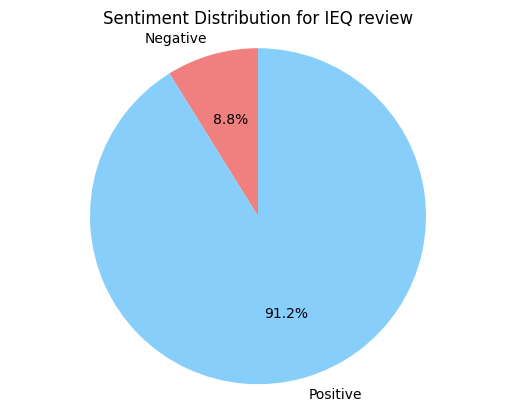

In [ ]:
labels = 'Negative', 'Positive'
sizes = [ieq_df['Sentiment_2'].value_counts()[0], ieq_df['Sentiment_2'].value_counts()[1]]
colors = ['lightcoral', 'lightskyblue']

fig, ax = plt.subplots()
ax.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=colors)
ax.axis('equal')
plt.title('Sentiment Distribution for IEQ review')
plt.show()

### 5.0.2. 감정분석 V2 [Scoring]

V2 모델을 통한 'Sentiment_0'은 -1(부정)에서 1(긍정)까지의 연속적인 값으로, 소수점 네째 자리까지 계산됨

---

단순 이진분류는 신뢰성이 높지만 얻을 수 있는 정보가 많지 않아 twitter데이터 기반 감정 분석 모델을 추가 사용함

**Twitter-roBERTa-base for Sentiment Analysis - UPDATED (2022)**

 2018년 1월부터 2021년 12월까지 약 1억 2,400만 개의 트윗으로 훈련된 RoBERTa 기반 모델이며 TweetEval 벤치마크를 사용한 감정 분석을 위해 미세 조정됨

 모델 출처:

https://huggingface.co/cardiffnlp/twitter-roberta-base-sentiment-latest

In [ ]:
!pip install transformers
!pip install scipy

In [ ]:
import torch
from transformers import AutoModelForSequenceClassification
from transformers import TFAutoModelForSequenceClassification
from transformers import AutoTokenizer, AutoConfig
from scipy.special import softmax

MODEL = f"cardiffnlp/twitter-roberta-base-sentiment-latest"
tokenizer = AutoTokenizer.from_pretrained(MODEL)
config = AutoConfig.from_pretrained(MODEL)
model = AutoModelForSequenceClassification.from_pretrained(MODEL)

def predict_sentiment_0(data):
    data['Sentiment_0'] = 0
    for i in tqdm(range(len(data))):
        text = data['comments'][i].strip()
        encoded_input = tokenizer(text, return_tensors='pt')

        if encoded_input['input_ids'][0].size()[0] > 512:
            data.loc[i, 'Sentiment_0'] = 100
        else:
            output = model(**encoded_input)
            scores = output[0][0].cpu().detach().numpy()
            scores = softmax(scores)
            negative_prob, neutral_prob, positive_prob = scores

            data.loc[i, 'Sentiment_0'] = positive_prob - negative_prob
    return

/opt/anaconda3/lib/python3.11/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Some weights of the model checkpoint at cardiffnlp/twitter-roberta-base-sentiment-latest were not used when initializing RobertaForSequenceClassification: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
- This IS expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model

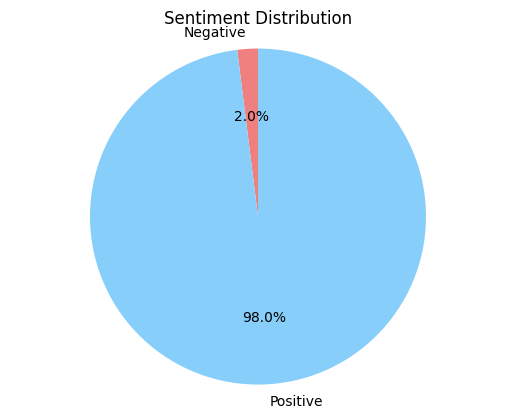

In [ ]:
labels = 'Negative', 'Positive'
sizes = [airbnb_df[airbnb_df['Sentiment_0'] < 0].shape[0], airbnb_df[airbnb_df['Sentiment_0'] > 0].shape[0]]
colors = ['lightcoral', 'lightskyblue']

fig, ax = plt.subplots()
ax.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=colors)
ax.axis('equal')
plt.title('Sentiment Distribution')
plt.show()

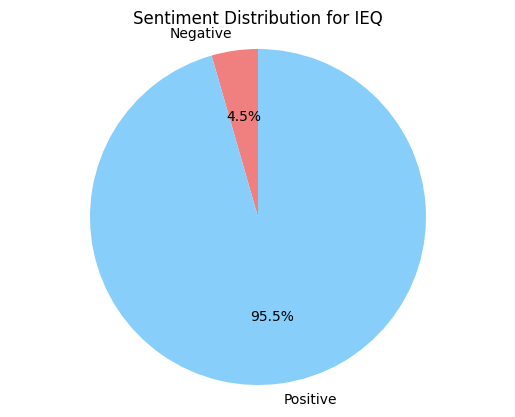

In [ ]:
labels = 'Negative', 'Positive'
sizes = [ieq_df[ieq_df['Sentiment_0'] < 0].shape[0], ieq_df[ieq_df['Sentiment_0'] > 0].shape[0]]
colors = ['lightcoral', 'lightskyblue']

fig, ax = plt.subplots()
ax.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=colors)
ax.axis('equal')
plt.title('Sentiment Distribution for IEQ')
plt.show()

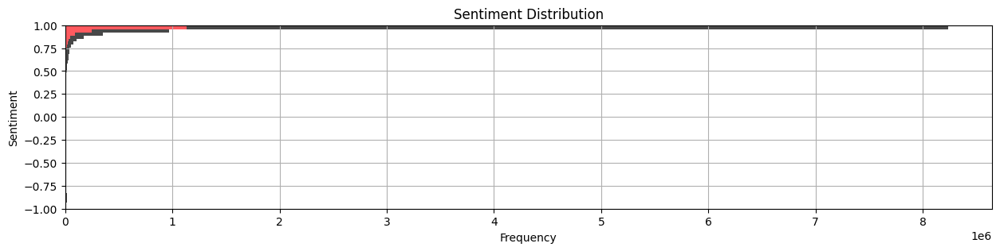

In [ ]:
plt.figure(figsize=(15, 3))
plt.hist(airbnb_df['Sentiment_0'].values, bins=3000, color='#484848', orientation='horizontal', alpha=1)
plt.hist(ieq_df['Sentiment_0'].values, bins=3000, color='#FF5A5F', orientation='horizontal', alpha=1)
plt.ylim(-1, 1)

plt.title('Sentiment Distribution')
plt.xlabel('Frequency')
plt.ylabel('Sentiment')

plt.grid(True)
plt.show()

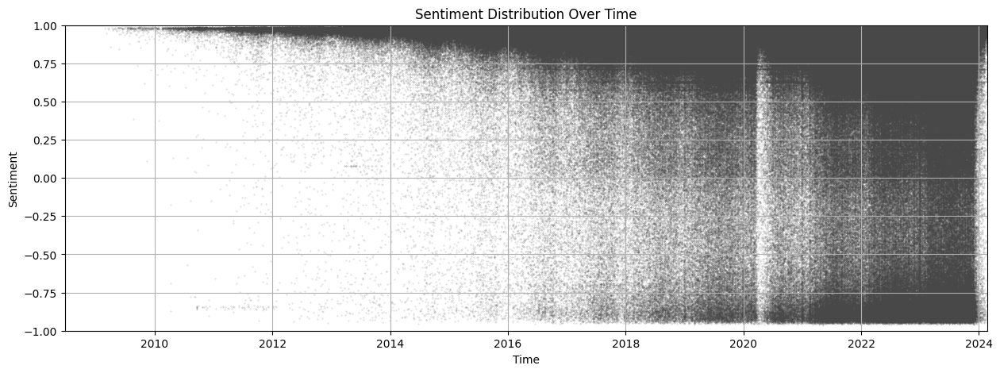

In [ ]:
# 시간에 따른 전체 리뷰 분포 시각화
try:
    airbnb_df['date'] = pd.to_datetime(airbnb_df['date'])
except Exception as e:
    print("Error converting 'date' column to datetime:", e)

invalid_dates = airbnb_df[airbnb_df['date'].isna()]
if not invalid_dates.empty:
    print("Invalid date entries found:", invalid_dates)
    airbnb_df = airbnb_df.dropna(subset=['date'])

plt.figure(figsize=(15, 5))
plt.scatter(airbnb_df['date'], airbnb_df['Sentiment_0'].values, s=0.1, alpha=0.3, color='#484848')
plt.xlim(airbnb_df['date'].min(), airbnb_df['date'].max())
plt.ylim(-1, 1)

plt.title('Sentiment Distribution Over Time')
plt.xlabel('Time')
plt.ylabel('Sentiment')

plt.grid(True)
plt.show()

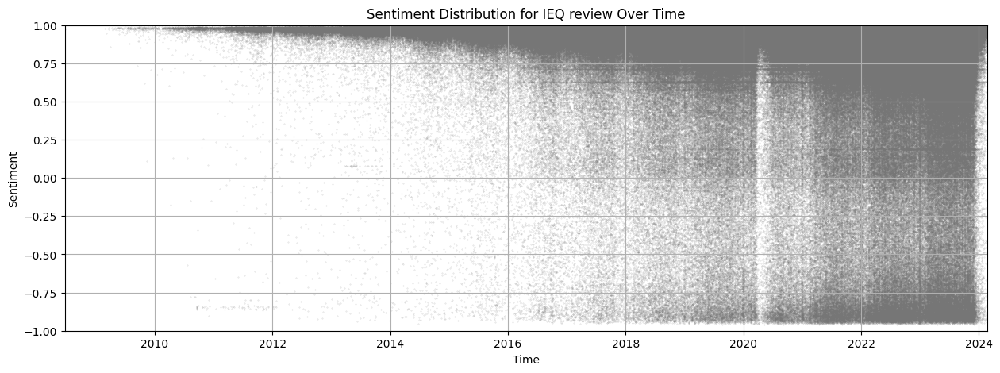

In [ ]:
# 시간에 따른 IEQ-irrelated 리뷰 분포 시각화
plt.figure(figsize=(15, 5))
plt.scatter(non_ieq_df['date'], non_ieq_df['Sentiment_0'].values, s=0.1, alpha=0.3, color='#767676')
plt.xlim(non_ieq_df['date'].min(), non_ieq_df['date'].max())
plt.ylim(-1, 1)

plt.title('Sentiment Distribution for IEQ review Over Time')
plt.xlabel('Time')
plt.ylabel('Sentiment')

plt.grid(True)
plt.show()

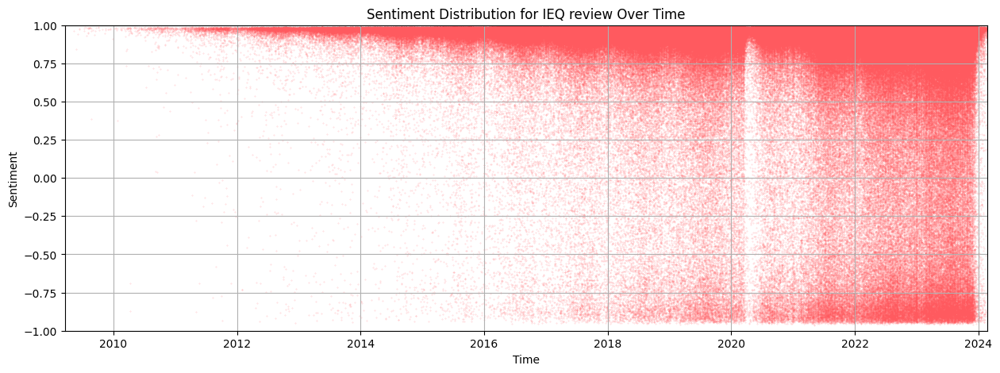

In [ ]:
# 시간에 따른 IEQ 리뷰 분포 시각화
plt.figure(figsize=(15, 5))
plt.scatter(ieq_df['date'], ieq_df['Sentiment_0'].values, s=0.1, alpha=0.3, color='#FF5A5F')
plt.xlim(ieq_df['date'].min(), ieq_df['date'].max())
plt.ylim(-1, 1)

plt.title('Sentiment Distribution for IEQ review Over Time')
plt.xlabel('Time')
plt.ylabel('Sentiment')

plt.grid(True)
plt.show()

### 5.0.3. 모델 비교

두 모델을 통해 나온 'Sentiment_2', 'Sentiment_0' 칼럼을 비교하며 감정 분석에 있어 정밀성을 더한다

- V1, V2 모델이 모두 긍정으로 처리한 리뷰는 10085117개로 0.9561%다.
- V1, V2 모델이 모두 부정으로 처리한 리뷰는 173659개로 0.0165%다.
- V1, V2 모델이 다르게 처리한 리뷰는 289310개로 0.0274%다.

전체 리뷰 중 97%를 두 모델이 비슷한 감정으로 처리함

In [ ]:
# 100을 넘는 리뷰들 살펴보기. 'Sentiment_2', 'Sentiment_0' 칼럼이 100인 것들은 리뷰 길이가 너무 길어 모델이 처리 할 수 없어 예외처리를 해뒀음
print(f"V1 모델은 {airbnb_df[airbnb_df['Sentiment_2'] == 100].shape[0]}개의 리뷰를 처리하지 못함")
print(f"V2 모델은 {airbnb_df[airbnb_df['Sentiment_0'] == 100].shape[0]}개의 리뷰를 처리하지 못함")

V1 모델은 12020개의 리뷰를 처리하지 못함
V2 모델은 11564개의 리뷰를 처리하지 못함


In [ ]:
# 두개의 모델이 처리하지 못한 공통 리뷰는 몇 개일까?
falseAnswer = airbnb_df[(airbnb_df['Sentiment_2'] == 100) & (airbnb_df['Sentiment_0'] == 100)].shape[0]
print(f"V1, V2 모델이 공통으로 처리 못한 리뷰는 {falseAnswer}개로 {falseAnswer/airbnb_df.shape[0]}%다.")

In [ ]:
# 공통으로 처리 못한 리뷰 보기
airbnb_df[(airbnb_df['Sentiment_2'] == 100) & (airbnb_df['Sentiment_0'] == 100)]['comments'].sample(3)
# -> 당연히 길이가 매우 길고 호스트에 대한 내용, 주변 환경, 편의 시설 등 다양한 토픽에 대해 이야기 함

655411                                                            GREAT! GREAT! GREAT! This review is from a middle aged couples point of view that has had several visits to Oahu and we have never stayed in an air BNB before now. Our Experience with the owner. Stacy was very responsive during the questions and booking process. After we booked she answered several questions before we arrived. While there she was very helpful when we asked about anything. Stacy has a great personality and is an outstanding host. She was there if we needed her but also went out of her way to make sure we had the privacy we wanted. Stacy went above and beyond to help make our stay the best we have ever had on the Island of Oahu. The Place. Our area was composed of a Living room, Kitchen, Bedroom, and Bathroom. The area has its own walkway, door, and only has a shared wall to the main home(under same roof but no entrance from main home). You have private parking and can come/go with the greatest of ease. In

In [ ]:
# 두개의 모델이 얼마나 비슷한 감정 분류를 했을까?
rightPos=airbnb_df[(airbnb_df['Sentiment_2'] == 1) & (airbnb_df['Sentiment_0'] > 0)].shape[0]
print(f"V1, V2 모델이 모두 긍정으로 처리한 리뷰는 {rightPos}개로 {round(rightPos/len(airbnb_df),4)}%다.")

rightNeg=airbnb_df[(airbnb_df['Sentiment_2'] == 0) & (airbnb_df['Sentiment_0'] < 0)].shape[0]
print(f"V1, V2 모델이 모두 부정으로 처리한 리뷰는 {rightNeg}개로 {round(rightNeg/len(airbnb_df),4)}%다.")

print(f"V1, V2 모델이 다르게 처리한 리뷰는 {airbnb_df.shape[0]-(rightPos+rightNeg)}개로 {round((airbnb_df.shape[0]-(rightPos+rightNeg))/len(airbnb_df),4)}%다.")

V1, V2 모델이 모두 긍정으로 처리한 리뷰는 10085117개로 0.9561%다.
V1, V2 모델이 모두 부정으로 처리한 리뷰는 173659개로 0.0165%다.
V1, V2 모델이 다르게 처리한 리뷰는 289310개로 0.0274%다.


## 5.1. IEQ와 별점
IEQ 리뷰들과 별점 사이의 관계를 분석한다

### 5.1.1. 별점 분포 보기
전체 리뷰, IEQ-irrelated 리뷰, IEQ 리뷰 세가지 데이터의 별점 열들을 비교한다
- 모든 데이터에서 별점은 4~5점으로 치우쳐 분포함
- IEQ 리뷰 데이터에서 7개의 별점 열들의 상관도가 가장 높음
- checkIn, communication 관련 열이 첨도가 높고 왜도가 큼
- IEQ와 관련된 열(cleaness, location)은 첨도가 비교적 낮고 왜도가 작음

rating(전체적인 별점)열이 모든 열의 성격을 종합적으로 담고 있다고 판단해 별점 관련 7가지 열들 중 rating열 하나만 사용하기로 했다

In [ ]:
airbnb_df.columns #별점과 관련된 칼럼이 7개 있음

Index(['Zone', 'City', 'id', 'date', 'comments', 'Thermal', 'Visual',
       'Acoustic', 'IAQ', 'Sentiment_2', 'Sentiment_0', 'host_is_superhost',
       'host_has_profile_pic', 'host_identity_verified', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'price',
       'number_of_reviews', 'first_review', 'last_review',
       'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value'],
      dtype='object')

In [ ]:
df_melted = pd.melt(airbnb_df,
                    id_vars=['date'],
                    value_vars=['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value'],
                    var_name='Review Category',
                    value_name='Score')

df_melted_non_ieq = pd.melt(non_ieq_df,
                    id_vars=['date'],
                    value_vars=['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value'],
                    var_name='Review Category',
                    value_name='Score')

df_melted_ieq = pd.melt(ieq_df,
                    id_vars=['date'],
                    value_vars=['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value'],
                    var_name='Review Category',
                    value_name='Score')

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before opera

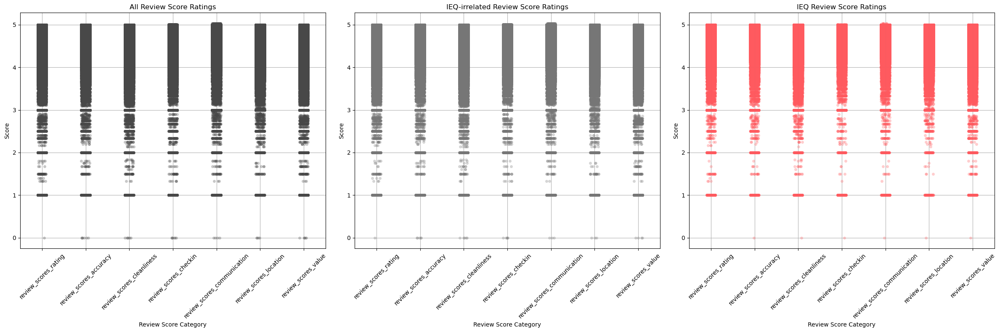

In [ ]:
fig, axs = plt.subplots(1, 3, figsize=(24, 8))

# 전체 리뷰 점수
sns.stripplot(x='Review Category', y='Score', data=df_melted, jitter=True, marker='o', alpha=0.1, color='#484848', ax=axs[0])
axs[0].set_title('All Review Score Ratings')
axs[0].set_xlabel('Review Score Category')
axs[0].set_ylabel('Score')
axs[0].tick_params(axis='x', rotation=45)
axs[0].grid(True)

# IEQ-irrelated 리뷰 점수
sns.stripplot(x='Review Category', y='Score', data=df_melted_non_ieq, jitter=True, marker='o', alpha=0.1, color='#767676', ax=axs[1])
axs[1].set_title('IEQ-irrelated Review Score Ratings')
axs[1].set_xlabel('Review Score Category')
axs[1].set_ylabel('Score')
axs[1].tick_params(axis='x', rotation=45)
axs[1].grid(True)

# IEQ 리뷰 점수
sns.stripplot(x='Review Category', y='Score', data=df_melted_ieq, jitter=True, marker='o', alpha=0.1, color='#FF5A5F', ax=axs[2])
axs[2].set_title('IEQ Review Score Ratings')
axs[2].set_xlabel('Review Score Category')
axs[2].set_ylabel('Score')
axs[2].tick_params(axis='x', rotation=45)
axs[2].grid(True)

plt.tight_layout()
plt.show()

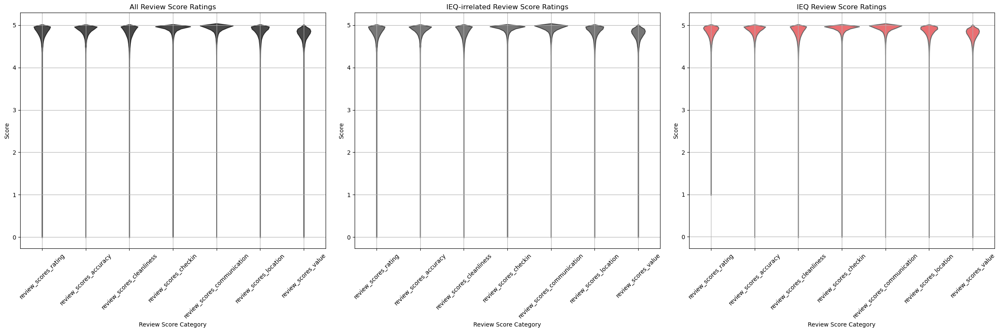

In [ ]:
fig, axs = plt.subplots(1, 3, figsize=(24, 8))

# 전체 리뷰 점수
sns.violinplot(x='Review Category', y='Score', data=df_melted, inner=None, color='#484848', ax=axs[0])
axs[0].set_title('All Review Score Ratings')
axs[0].set_xlabel('Review Score Category')
axs[0].set_ylabel('Score')
axs[0].tick_params(axis='x', rotation=45)
axs[0].grid(True)

# IEQ-irrelated 리뷰 점수
sns.violinplot(x='Review Category', y='Score', data=df_melted_non_ieq, inner=None, color='#767676', ax=axs[1])
axs[1].set_title('IEQ-irrelated Review Score Ratings')
axs[1].set_xlabel('Review Score Category')
axs[1].set_ylabel('Score')
axs[1].tick_params(axis='x', rotation=45)
axs[1].grid(True)

# IEQ 리뷰 점수
sns.violinplot(x='Review Category', y='Score', data=df_melted_ieq, inner=None, color='#FF5A5F', ax=axs[2])
axs[2].set_title('IEQ Review Score Ratings')
axs[2].set_xlabel('Review Score Category')
axs[2].set_ylabel('Score')
axs[2].tick_params(axis='x', rotation=45)
axs[2].grid(True)

plt.tight_layout()
plt.show()

In [ ]:
import scipy.stats as stats

# 전체 리뷰 데이터의 왜도와 첨도 계산
skewness_all = airbnb_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value']].skew()
kurtosis_all = airbnb_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value']].kurtosis()

# IEQ-irrelated 리뷰 데이터의 왜도와 첨도 계산
skewness_non_ieq = non_ieq_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value']].skew()
kurtosis_non_ieq = non_ieq_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value']].kurtosis()

# IEQ 리뷰 데이터의 왜도와 첨도 계산
skewness_ieq = ieq_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value']].skew()
kurtosis_ieq = ieq_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                                'review_scores_communication', 'review_scores_location', 'review_scores_value']].kurtosis()

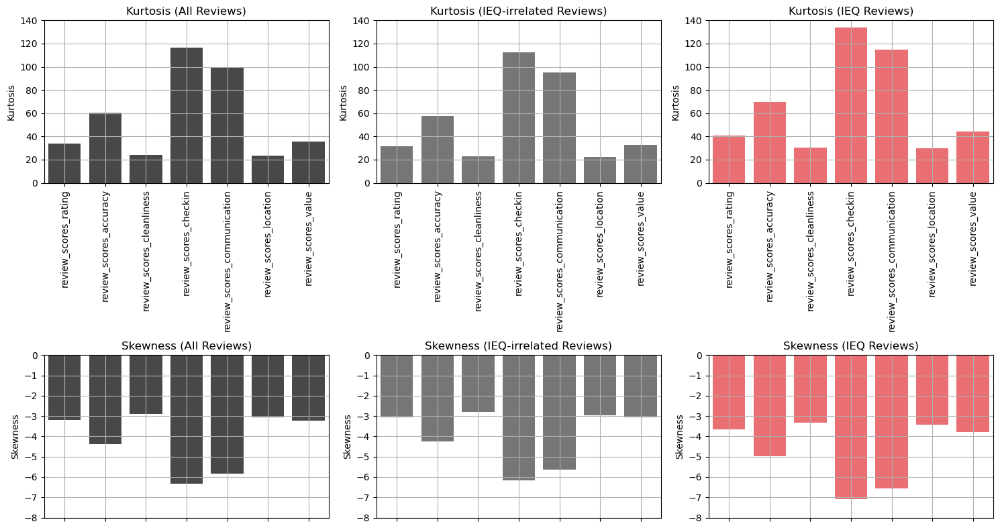

In [ ]:
fig, axs = plt.subplots(2, 3, figsize=(15, 8))

# 전체 리뷰 데이터의 첨도
sns.barplot(x=kurtosis_all.index, y=kurtosis_all.values, ax=axs[0, 0], color='#484848')
axs[0, 0].set_title('Kurtosis (All Reviews)')
axs[0, 0].set_xlabel('')
axs[0, 0].set_ylabel('Kurtosis')
axs[0, 0].tick_params(axis='x', rotation=90)
axs[0, 0].grid(True)
axs[0, 0].set_ylim(0, 140)

# IEQ-irrelated 리뷰 데이터의 첨도
sns.barplot(x=kurtosis_non_ieq.index, y=kurtosis_non_ieq.values, ax=axs[0, 1], color='#767676')
axs[0, 1].set_title('Kurtosis (IEQ-irrelated Reviews)')
axs[0, 1].set_xlabel('')
axs[0, 1].set_ylabel('Kurtosis')
axs[0, 1].tick_params(axis='x', rotation=90)
axs[0, 1].grid(True)
axs[0, 1].set_ylim(0, 140)

# IEQ 리뷰 데이터의 첨도
sns.barplot(x=kurtosis_ieq.index, y=kurtosis_ieq.values, ax=axs[0, 2], color='#FF5A5F')
axs[0, 2].set_title('Kurtosis (IEQ Reviews)')
axs[0, 2].set_xlabel('')
axs[0, 2].set_ylabel('Kurtosis')
axs[0, 2].tick_params(axis='x', rotation=90)
axs[0, 2].grid(True)
axs[0, 2].set_ylim(0, 140)

# 전체 리뷰 데이터의 왜도
sns.barplot(x=skewness_all.index, y=skewness_all.values, ax=axs[1, 0], color='#484848')
axs[1, 0].set_title('Skewness (All Reviews)')
axs[1, 0].set_xlabel('')
axs[1, 0].set_ylabel('Skewness')
axs[1, 0].tick_params(axis='x', rotation=90)
axs[1, 0].grid(True)
axs[1, 0].set_xticklabels([])
axs[1, 0].set_ylim(-8, 0)

# IEQ-irrelated 리뷰 데이터의 왜도
sns.barplot(x=skewness_non_ieq.index, y=skewness_non_ieq.values, ax=axs[1, 1], color='#767676')
axs[1, 1].set_title('Skewness (IEQ-irrelated Reviews)')
axs[1, 1].set_xlabel('')
axs[1, 1].set_ylabel('Skewness')
axs[1, 1].tick_params(axis='x', rotation=90)
axs[1, 1].grid(True)
axs[1, 1].set_xticklabels([])
axs[1, 1].set_ylim(-8, 0)

# IEQ 리뷰 데이터의 왜도
sns.barplot(x=skewness_ieq.index, y=skewness_ieq.values, ax=axs[1, 2], color='#FF5A5F')
axs[1, 2].set_title('Skewness (IEQ Reviews)')
axs[1, 2].set_xlabel('')
axs[1, 2].set_ylabel('Skewness')
axs[1, 2].tick_params(axis='x', rotation=90)
axs[1, 2].grid(True)
axs[1, 2].set_xticklabels([])
axs[1, 2].set_ylim(-8, 0)

plt.tight_layout()
plt.show()

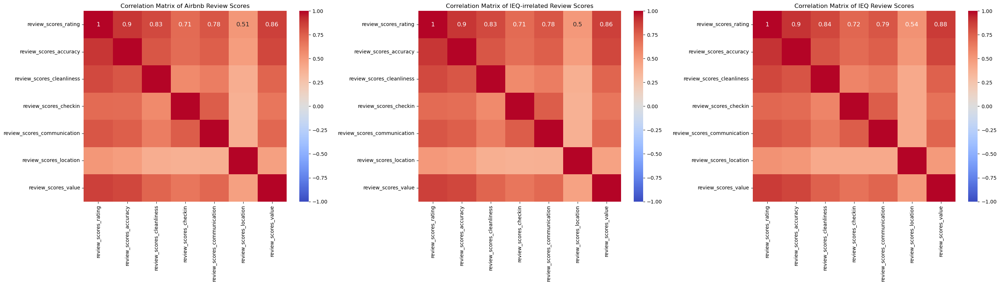

In [ ]:
airbnb_corr = airbnb_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                         'review_scores_communication', 'review_scores_location', 'review_scores_value']].corr()

non_ieq_corr = non_ieq_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                         'review_scores_communication', 'review_scores_location', 'review_scores_value']].corr()

ieq_corr = ieq_df[['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                   'review_scores_communication', 'review_scores_location', 'review_scores_value']].corr()

fig, axes = plt.subplots(ncols=3, figsize=(28, 8))

sns.heatmap(airbnb_corr, annot=True, annot_kws={"size": 12}, cmap='coolwarm', vmin=-1, vmax=1, ax=axes[0])
axes[0].set_title('Correlation Matrix of Airbnb Review Scores')

sns.heatmap(non_ieq_corr, annot=True, annot_kws={"size": 12}, cmap='coolwarm', vmin=-1, vmax=1, ax=axes[1])
axes[1].set_title('Correlation Matrix of IEQ-irrelated Review Scores')

sns.heatmap(ieq_corr, annot=True, annot_kws={"size": 12}, cmap='coolwarm', vmin=-1, vmax=1, ax=axes[2])
axes[2].set_title('Correlation Matrix of IEQ Review Scores')

plt.tight_layout()
plt.show()
# IEQ 리뷰들의 별점 컬럼 관계를 보면, rating(전반적인 별점) 열과의 상관성이 타 데이터에 비해 조금 더 높음
# -이유1)표본이 상대적으로 적어서
# -이유2)특정 토픽(IEQ)에 관해서 묶었기 때문에 비교적 내용이 유사한 리뷰들이 묶었을 가능성이 있음

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before opera

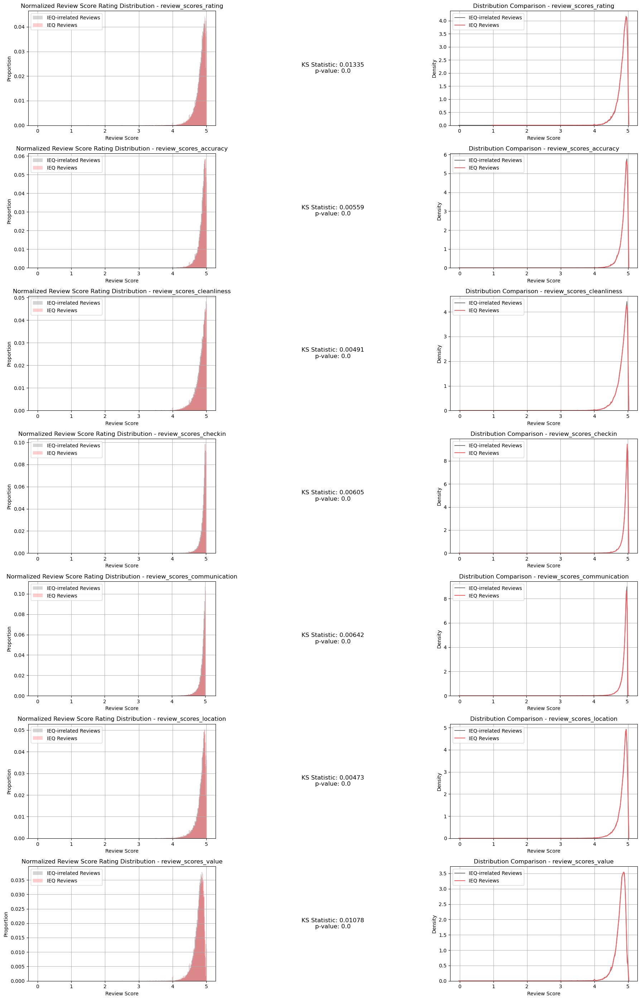

In [ ]:
from scipy.stats import ks_2samp

rating_cols = [
    'review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness',
    'review_scores_checkin', 'review_scores_communication', 'review_scores_location',
    'review_scores_value'
]

fig, axs = plt.subplots(7, 3, figsize=(18, 28))

for i, col in enumerate(rating_cols):
    # Airbnb 리뷰 스코어와 IEQ 리뷰 스코어 추출
    non_ieq_reviews = non_ieq_df[col].dropna()
    ieq_reviews = ieq_df[col].dropna()

    # 히스토그램 표준화
    non_ieq_reviews_normalized = non_ieq_reviews.value_counts(normalize=True).sort_index()
    ieq_reviews_normalized = ieq_reviews.value_counts(normalize=True).sort_index()

    # 히스토그램 그리기
    axs[i, 0].bar(non_ieq_reviews_normalized.index - 0.01, non_ieq_reviews_normalized.values, width=0.02, alpha=0.3, label='IEQ-irrelated Reviews', color='#767676')
    axs[i, 0].bar(ieq_reviews_normalized.index + 0.01, ieq_reviews_normalized.values, width=0.02, alpha=0.3, label='IEQ Reviews', color='#FF5A5F')
    axs[i, 0].set_title(f'Normalized Review Score Rating Distribution - {col}')
    axs[i, 0].set_xlabel('Review Score')
    axs[i, 0].set_ylabel('Proportion')
    axs[i, 0].legend()
    axs[i, 0].grid(True)

    # 통계적 검정: Kolmogorov-Smirnov test
    ks_stat, ks_p_value = ks_2samp(non_ieq_reviews, ieq_reviews)
    ks_stat = round(ks_stat, 5)  # 통계량 소수점 5자리까지 표시
    ks_p_value = round(ks_p_value, 5)  # p-value 소수점 5자리까지 표시
    axs[i, 1].text(0.5, 0.5, f"KS Statistic: {ks_stat}\np-value: {ks_p_value}", ha='center', va='center', fontsize=12)
    axs[i, 1].axis('off')

    # Kolmogorov-Smirnov 검정 결과 시각화
    sns.kdeplot(non_ieq_reviews, ax=axs[i, 2], label='IEQ-irrelated Reviews', color='#767676')
    sns.kdeplot(ieq_reviews, ax=axs[i, 2], label='IEQ Reviews', color='#FF5A5F')
    axs[i, 2].set_title(f'Distribution Comparison - {col}')
    axs[i, 2].set_xlabel('Review Score')
    axs[i, 2].set_ylabel('Density')
    axs[i, 2].legend()
    axs[i, 2].grid(True)

plt.tight_layout()
plt.show()

세가지 데이터 프레임 사이의 같은 열들의 ANOVA
                       Feature      F-Value        p-Value
0         review_scores_rating  1529.312748   0.000000e+00
1       review_scores_accuracy   439.776347  1.026929e-191
2    review_scores_cleanliness   186.810071   7.415413e-82
3        review_scores_checkin    32.991224   4.700197e-15
4  review_scores_communication   283.292753  9.314784e-124
5       review_scores_location    15.856848   1.298565e-07
6          review_scores_value  1008.405706   0.000000e+00


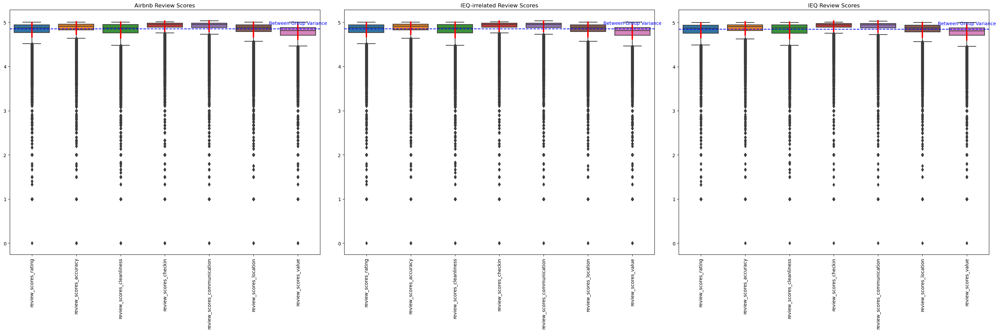

In [ ]:
from scipy.stats import f_oneway

anova_results = []

for col in rating_cols:
    f_val, p_val = f_oneway(airbnb_df[col], non_ieq_df[col], ieq_df[col])
    anova_results.append({'Feature': col, 'F-Value': f_val, 'p-Value': p_val})

anova_results_df = pd.DataFrame(anova_results)
print('세가지 데이터 프레임 사이의 같은 열들의 ANOVA')
print(anova_results_df)

def plot_anova_variance(ax, df_name, df):
    sns.boxplot(data=df[columns], ax=ax)
    ax.set_title(f'{df_name} Review Scores')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

    for i, col in enumerate(columns):
        mean = df[col].mean()
        std = df[col].std()
        ax.plot([i, i], [mean - std, mean + std], color='red', lw=3)

    overall_mean = df[columns].mean().mean()
    ax.axhline(overall_mean, color='blue', linestyle='--')
    ax.text(len(columns)-1, overall_mean + 0.1, 'Between-Group Variance', color='blue', ha='center')

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 10))

plot_anova_variance(axes[0], 'Airbnb', airbnb_df)
plot_anova_variance(axes[1], 'IEQ-irrelated', non_ieq_df)
plot_anova_variance(axes[2], 'IEQ', ieq_df)

plt.tight_layout()
plt.show()
# 모든 변수에 대해 F-값이 매우 크고, p-값이 매우 작다. 이는 세 그룹(예: Airbnb, IEQ-irrelated, IEQ)의 각 별점에 대해 평균이 통계적으로 유의미하게 다르다는 것을 의미한다
# 'review_scores_ratin'은 가장 높은 F-값과 가장 낮은 p-값을 가지고 있어 평점 점수 측면에서 그룹 간 강력한 효과와 통계적으로 유의한 차이가 있음을 나타낸다
# Between-Group Variance 점선과 중앙값이 유사한 열들로 'review_scores_rating', 'review_scores_cleanliness', 'review_scores_location'이 있다
### -> 위 내용들을 근거로 별점을 대표하는 열로 'review_scores_rating' 선정함

### 5.1.2. 긍정적인 IEQ 리뷰가 별점도 높을까?

IEQ 리뷰들이 별점에 미치는 정도를 감정 분석 결과를 이용해 다음 질문들에 답한다
1. 감정과 별점은 무슨 관계를 보일까?
2. 전체 리뷰 중 IEQ 리뷰만의 특징이 있을까?

In [ ]:
# 건물별 리뷰들의 평균 감정과 별점 데이터 만들기
airbnb_df_rating = airbnb_df.groupby(['id'])['review_scores_rating'].mean().reset_index()
airbnb_df_sentiment_mean = airbnb_df.groupby(['id'])['Sentiment_0'].mean().reset_index()
airbnb_df_merged = pd.merge(airbnb_df_rating, airbnb_df_sentiment_mean, on='id', how='left')

non_ieq_df_rating = non_ieq_df.groupby(['id'])['review_scores_rating'].mean().reset_index()
non_ieq_df_sentiment_mean = non_ieq_df.groupby(['id'])['Sentiment_0'].mean().reset_index()
non_ieq_df_merged = pd.merge(non_ieq_df_rating, non_ieq_df_sentiment_mean, on='id', how='left')

ieq_df_rating = ieq_df.groupby(['id'])['review_scores_rating'].mean().reset_index()
ieq_df_sentiment_mean = ieq_df.groupby(['id'])['Sentiment_0'].mean().reset_index()
ieq_df_merged = pd.merge(ieq_df_rating, ieq_df_sentiment_mean, on='id', how='left')

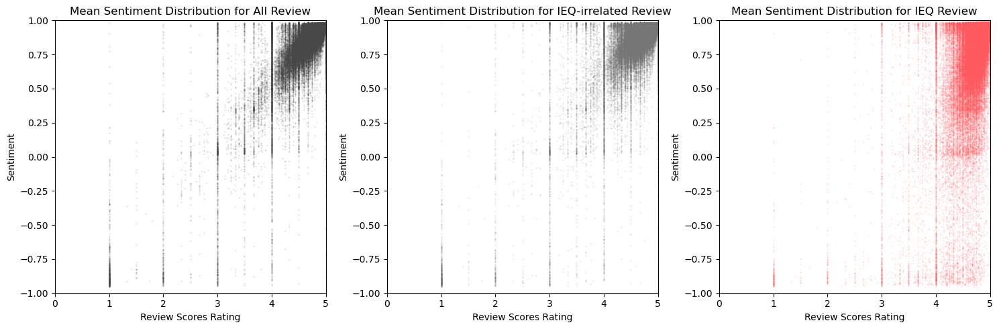

In [ ]:
# 개별 건물들의 여러 리뷰들의 평균 감정 분석값과 별점 사이의 관계 시각화
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.scatter(airbnb_df_merged['review_scores_rating'], airbnb_df_merged['Sentiment_0'].values, s=0.1, alpha=0.3, color='#484848')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for All Review')
plt.xlabel('Review Scores Rating')
plt.ylabel('Sentiment')

plt.subplot(1, 3, 2)
plt.scatter(non_ieq_df_merged['review_scores_rating'], non_ieq_df_merged['Sentiment_0'].values, s=0.1, alpha=0.3, color='#767676')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for IEQ-irrelated Review')
plt.xlabel('Review Scores Rating')
plt.ylabel('Sentiment')

plt.subplot(1, 3, 3)
plt.scatter(ieq_df_merged['review_scores_rating'], ieq_df_merged['Sentiment_0'].values, s=0.1, alpha=0.3, color='#FF5A5F')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for IEQ Review')
plt.xlabel('Review Scores Rating')
plt.ylabel('Sentiment')

plt.tight_layout()
plt.show()
# 리뷰가 긍정적이면 별점이 높다
# 별점에 대한 IEQ 리뷰의 감정변화가 IEQ-irrelated 보다 더 민감함. 반대로 감정의 변화폭에 별점이 영향을 적게 받는다고도 해석 됨
# (IEQ 관련 리뷰는 쫌만 긍정적이어도(0만 넘으면) 별점을 높게 줌...?!! -> 같은 노력일때, IEQ 관리를 통해 별점을 높게 받을 확률이 더 쉬워짐)
# 데이터 총량의 차이, 단순 리뷰 수, 감정분석 모델의 신뢰성 및 원인 불명확 등의 이유로 무작정 결론 지을 순 없음!!

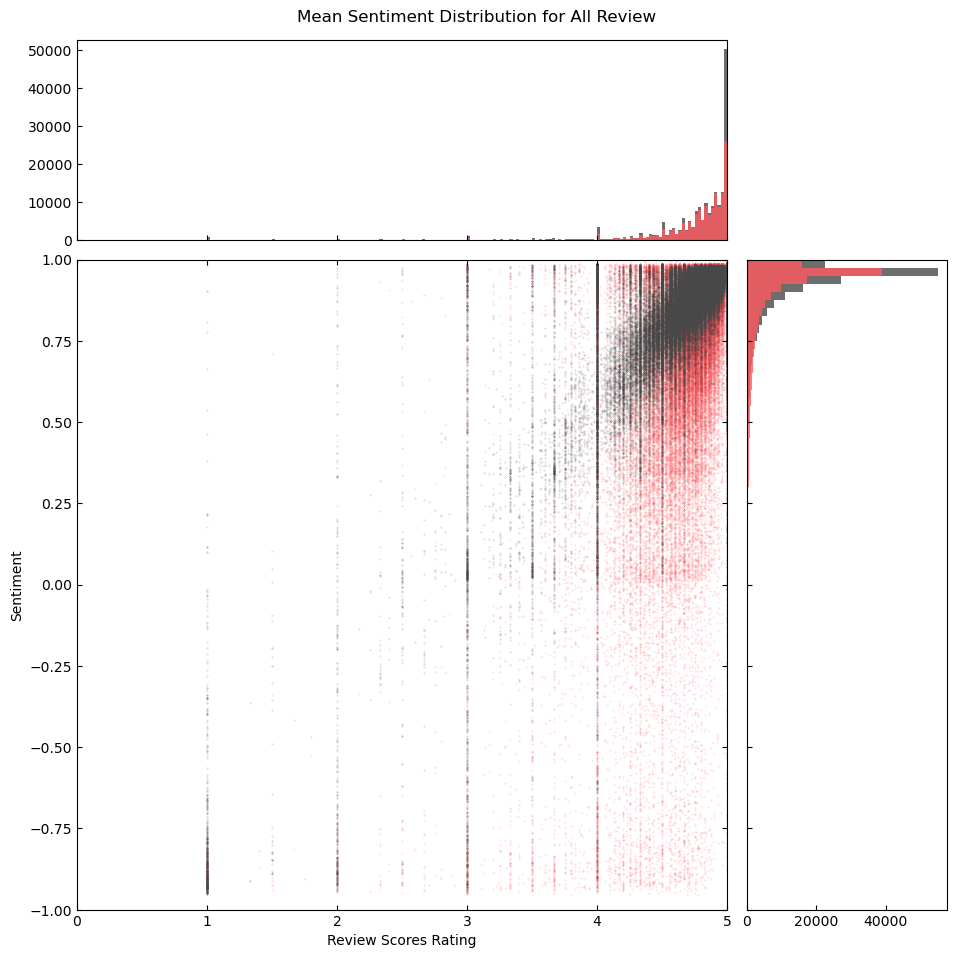

In [ ]:
x = airbnb_df_merged['review_scores_rating']
y = airbnb_df_merged['Sentiment_0']

x2 = ieq_df_merged['review_scores_rating']
y2 = ieq_df_merged['Sentiment_0']

# Axes 크기 설정
left, width = 0.1, 0.65
bottom, height = 0.1, 0.65
sub_height = 0.2
sub_width = 0.2
spacing = 0.02

rect_scatter = [left, bottom, width, height]  # 산포도가 그려질 Axes
rect_histx = [left, bottom + height + spacing, width, sub_height]  # x축 히스토그램이 그려질 Axes
rect_histy = [left + width + spacing, bottom, sub_width, height]  # y축 히스토그램이 그려질 Axes

fig = plt.figure(figsize=(10, 10))
fig.set_facecolor('white')

# 3개 Axes 생성
ax_scatter = plt.axes(rect_scatter)
ax_scatter.tick_params(direction='in', top=True, right=True)  # 눈금은 Axes 안쪽으로 설정
ax_histx = plt.axes(rect_histx)
ax_histx.tick_params(direction='in', labelbottom=False)
ax_histy = plt.axes(rect_histy)
ax_histy.tick_params(direction='in', labelleft=False)

# 산포도 생성
ax_scatter.scatter(x2, y2, s=0.1, alpha=0.3, color='#FF5A5F')
ax_scatter.scatter(x, y, s=0.1, alpha=0.3, color='#484848')

# 산포도 x, y축 limit 설정
binwidth = 0.025
xlim = (0, 5)
ylim = (-1, 1)
ax_scatter.set_xlim(xlim)
ax_scatter.set_ylim(ylim)

# 각 Axes에 히스토그램 그리기
bins_x = np.arange(xlim[0], xlim[1] + binwidth, binwidth)
bins_y = np.arange(ylim[0], ylim[1] + binwidth, binwidth)
ax_histx.hist(x, bins=bins_x, color='#484848', alpha=0.8)  # x축 히스토그램
ax_histx.hist(x2, bins=bins_x, color='#FF5A5F', alpha=0.8)  # x2축 히스토그램

ax_histy.hist(y, bins=bins_y, orientation='horizontal', color='#484848', alpha=0.8, edgecolor='none')  # y축 히스토그램
ax_histy.hist(y2, bins=bins_y, orientation='horizontal', color='#FF5A5F', alpha=0.8, edgecolor='none')  # y2축 히스토그램

# 히스토그램 x & y limit 설정
ax_histx.set_xlim(ax_scatter.get_xlim())
ax_histy.set_ylim(ax_scatter.get_ylim())

# 제목 및 라벨 설정
plt.suptitle('Mean Sentiment Distribution for All Review', x=0.5, y=1)
ax_scatter.set_xlabel('Review Scores Rating')
ax_scatter.set_ylabel('Sentiment')

plt.show()

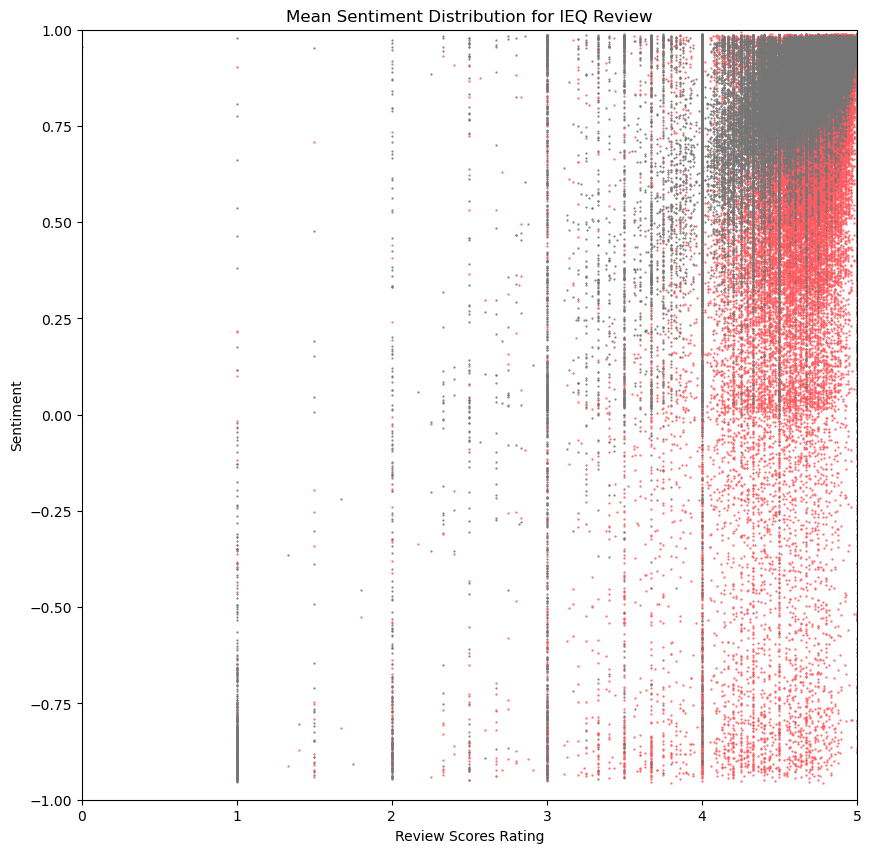

In [ ]:
plt.figure(figsize=(10, 10))
plt.scatter(ieq_df_merged['review_scores_rating'], ieq_df_merged['Sentiment_0'].values, s=0.3, alpha=1, color='#FF5A5F')
plt.scatter(non_ieq_df_merged['review_scores_rating'], non_ieq_df_merged['Sentiment_0'].values, s=0.3, alpha=1, color='#767676')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for IEQ Review')
plt.xlabel('Review Scores Rating')
plt.ylabel('Sentiment')
plt.show()
# <<IEQ 시각의 중요성>>
# 건물 환경 개선과 소비자의 만족도를 높이기 위해서는 부정적인 리뷰에 집중하고 특정 관점으로 잘 뽑아내야한다
# 부정적인 리뷰는 IEQ 관련 내용을 담고 있는 리뷰가 IEQ-irrelated 리뷰보다 많다
### 따라서 IEQ는 부정적인 리뷰들을 효과적으로 뽑을 수 있는 기준, 관점이 될 수 있다

### 5.1.3. 긍정적인 IEQ 리뷰가 별점도 높을까? - IEQ 문장에 집중해서

In [ ]:
# 리뷰를 문장 단위로 분할하는 함수
def split_into_sentences(text):
    sentences = re.split(r'(?<!\w\.\w.)(?<![A-Z][a-z]\.)(?<=\.|\?)\s', text)
    return sentences

# 키워드가 문장에 있는지 확인하고 색칠하는 함수
def highlight_keywords(sentence, keywords, color_code='\033[93m'):
    for keyword in keywords:
        pattern = re.compile(r'\b' + re.escape(keyword) + r'\b', re.IGNORECASE)
        sentence = pattern.sub(f'{color_code}\\g<0>\033[0m', sentence)
    return sentence

# 주어진 리뷰에서 키워드를 포함하는 문장만 추출하고 색칠하는 함수
def extract_and_highlight_sentences(review, category_keywords, color_code='\033[41m'):
    sentences = split_into_sentences(review)
    relevant_sentences = []
    for sentence in sentences:
        for category, keywords in category_keywords.items():
            if contains_keywords(sentence, keywords):
                highlighted_sentence = highlight_keywords(sentence, keywords, color_code)
                relevant_sentences.append(highlighted_sentence)
                break
    return relevant_sentences

# 키워드가 문장에 있는지 확인하는 함수
def contains_keywords(sentence, keywords):
    for keyword in keywords:
        if re.search(r'\b' + re.escape(keyword) + r'\b', sentence, re.IGNORECASE):
            return True
    return False

In [ ]:
ieq_df['comments'][505]

"Nicolas' place was extremely clean. It's small, but enough space for 2 people. Finding a spot to park was no problem, the courtyard was beautiful, and Nicolas was quick with responding! Gaby, the housekeeper, was also very attentive. The only trouble I had with the place was the induction stove, but a quick message to Nicolas was able to solve the problem. The walls are thin, so you may hear your neighbors, but it was manageable. I would stay here again if needed!"

In [ ]:
# 예시 리뷰
reviews = [ieq_df['comments'][505]]

for review in reviews:
    relevant_sentences = extract_and_highlight_sentences(review, ieq_category_keywords)
    for sentence in relevant_sentences:
        print(sentence)

The walls are thin, so you may hear your neighbors, but it was manageable.


In [ ]:
sample_df = ieq_df.sample(100000)
sample_df = sample_df.reset_index(drop=True)
sample_df.head(1)

,Zone,City,id,date,comments,Thermal,Visual,Acoustic,IAQ,Sentiment_2,Sentiment_0,host_is_superhost,host_has_profile_pic,host_identity_verified,latitude,longitude,property_type,room_type,accommodates,price,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,4,"Portland, Oregon",30224062,2022-05-30,"Kelly’s place is pure perfection! Clean, bright, and cozy. The bed is so comfortable! It’s in a great location with easy access to everything Portland offers.",0,1,0,0,1,0.983769,0,1,1,45.584699,-122.710582,Entire guest suite,Entire home/apt,4.0,85.0,71.0,2019-05-06,2023-12-12,4.96,5.0,4.97,4.93,4.99,4.94,4.96


In [ ]:
sample_df['comments'][505]

'LeeAnne and her family’s home is amazing! Everything looks and is just the way you see it online but in reality, it’s even better!<br/>The location was perfect for us; we wanted to be close to things to do and beaches but, also have a quiet place to rest and regroup. <br/>We traveled  with our toddler and LeeAnne was able to provide a pack-n-play with linens for sleep, a high chair, books, toys, and she even had utensils for small children stocked in the kitchen. Having those items made traveling so much easier!! <br/>The kitchen, as the rest of the villa, is fully stocked with everything you may need. <br/>You won’t be disappointed with you time at Monekypod Villa, you probably won’t even want to leave…..we didn’t.'

In [ ]:
reviews = [sample_df['comments'][505]]

for review in reviews:
    relevant_sentences = extract_and_highlight_sentences(review, ieq_category_keywords)
    for sentence in relevant_sentences:
        print(sentence)

LeeAnne and her family’s home is amazing! Everything looks and is just the way you see it online but in reality, it’s even better!<br/>The location was perfect for us; we wanted to be close to things to do and beaches but, also have a quiet place to rest and regroup.


In [ ]:
def extract_sentences_with_keywords(review, category_keywords):
    sentences = split_into_sentences(review)
    relevant_sentences = []
    for sentence in sentences:
        for category, keywords in category_keywords.items():
            if contains_keywords(sentence, keywords):
                relevant_sentences.append(sentence)
                break

    return relevant_sentences

def predict_sentiment_only_ieq_0(data):
    data['Sentiment_ieq_0'] = 0
    for i in tqdm(range(len(data))):
        text = data['comments'][i].strip()
        sentences = extract_sentences_with_keywords(text, ieq_category_keywords)
        concatenated_sentences = ' '.join(sentences)
        encoded_input = tokenizer(concatenated_sentences, return_tensors='pt', padding=True, truncation=True)

        if encoded_input['input_ids'][0].size()[0] > 512:
            data.loc[i, 'Sentiment_ieq_0'] = 100
        else:
            output = model(**encoded_input)
            scores = output[0][0].cpu().detach().numpy()
            scores = softmax(scores)
            negative_prob, neutral_prob, positive_prob = scores

            data.loc[i, 'Sentiment_ieq_0'] = positive_prob - negative_prob
    return

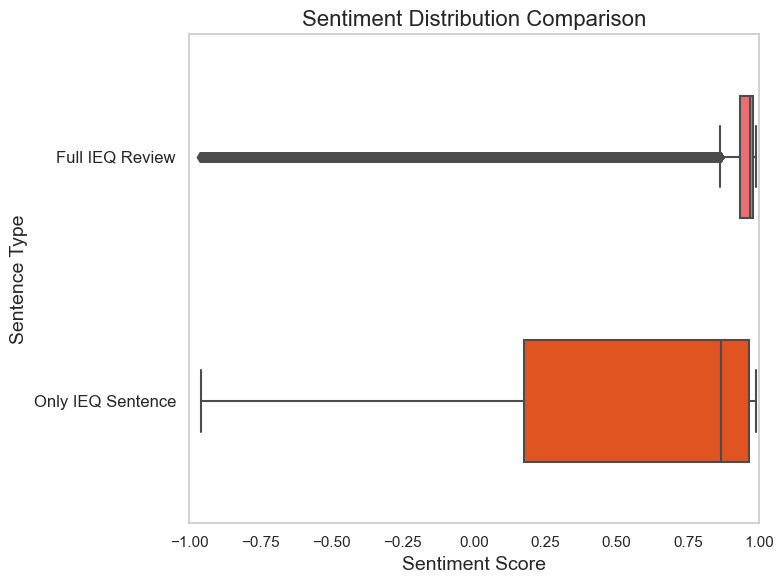

In [ ]:
data = ieq_df_ss[['Sentiment_0', 'Sentiment_ieq_0']]

plt.figure(figsize=(8, 6))
sns.boxplot(data=data, orient='h', palette=['#FF5A5F', '#FF4500'], width=0.5)
plt.title('Sentiment Distribution Comparison', fontsize=16)
plt.xlabel('Sentiment Score', fontsize=14)
plt.ylabel('Sentence Type', fontsize=14)
plt.yticks(ticks=[0, 1], labels=['Full IEQ Review', 'Only IEQ Sentence'], fontsize=12)
plt.xlim(-1, 1)
plt.grid(axis='x')
plt.tight_layout()
plt.show()

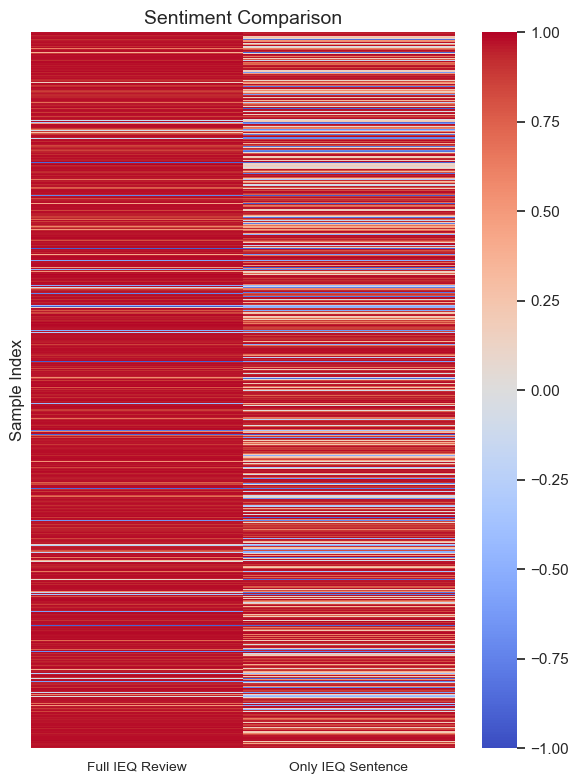

In [ ]:
sns.set(style="whitegrid")
data = ieq_df_ss[['Sentiment_0', 'Sentiment_ieq_0']][:]

plt.figure(figsize=(6, 8))
sns.heatmap(data, annot=False, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Sentiment Comparison', fontsize=14)
plt.xlabel('', fontsize=12)
plt.ylabel('Sample Index')
plt.xticks(ticks=[0.5, 1.5], labels=['Full IEQ Review', 'Only IEQ Sentence'], fontsize=10)
plt.yticks([])
plt.tight_layout()
plt.show() # 전체 리뷰에 비해 IEQ 문장이 더 부정적인 리뷰를 담고 있음을 알 수 있다.

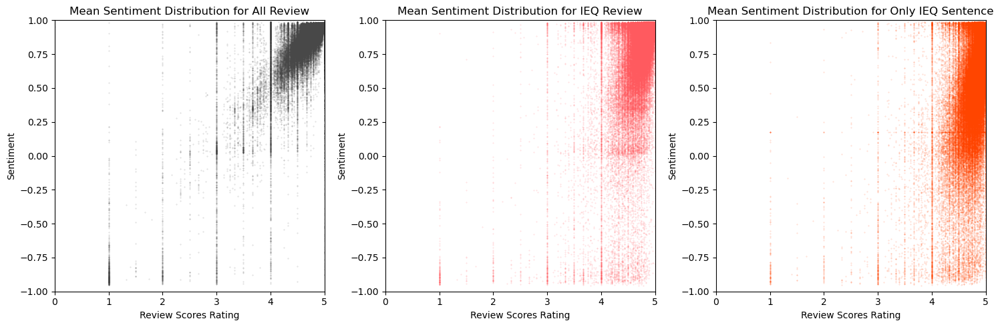

In [ ]:
ieq_df_ss_rating = ieq_df_ss.groupby(['id'])['review_scores_rating'].mean().reset_index()
ieq_df_ss_sentiment_mean = ieq_df_ss.groupby(['id'])['Sentiment_ieq_0'].mean().reset_index()
ieq_df_ss_merged = pd.merge(ieq_df_ss_rating, ieq_df_ss_sentiment_mean, on='id', how='left')

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.scatter(airbnb_df_merged['review_scores_rating'], airbnb_df_merged['Sentiment_0'].values, s=0.1, alpha=0.3, color='#484848')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for All Review')
plt.xlabel('Review Scores Rating')
plt.ylabel('Sentiment')

plt.subplot(1, 3, 2)
plt.scatter(ieq_df_merged['review_scores_rating'], ieq_df_merged['Sentiment_0'].values, s=0.1, alpha=0.3, color='#FF5A5F')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for IEQ Review')
plt.xlabel('Review Scores Rating')
plt.ylabel('Sentiment')

plt.subplot(1, 3, 3)
plt.scatter(ieq_df_ss_merged['review_scores_rating'], ieq_df_ss_merged['Sentiment_ieq_0'].values, s=0.1, alpha=0.3, color='#FF4500')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for Only IEQ Sentence')
plt.xlabel('Review Scores Rating')
plt.ylabel('Sentiment')

plt.tight_layout()
plt.show()
# IEQ 리뷰를 전체 감정 분석한 결과보다 IEQ 키워드를 담고 있는 문장만 감정 분석한 결과가 더 부정적인 리뷰가 많았다

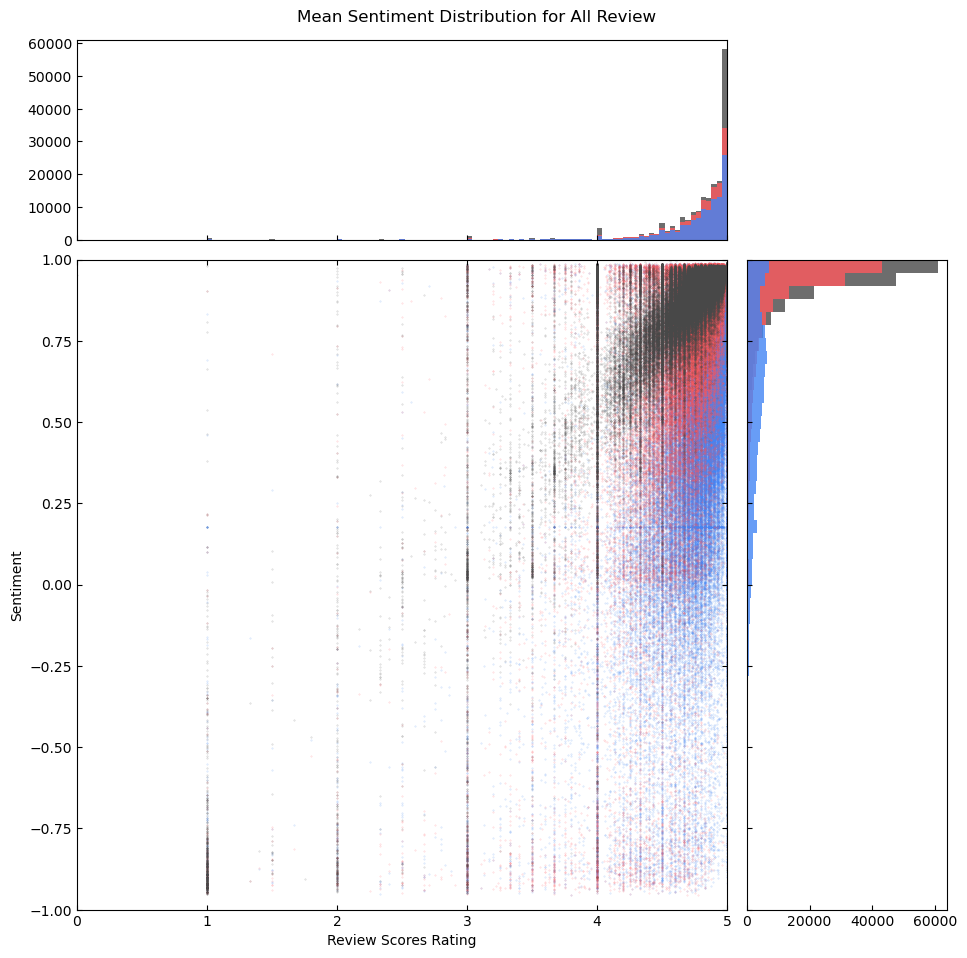

In [ ]:
x = airbnb_df_merged['review_scores_rating']
y = airbnb_df_merged['Sentiment_0']

x2 = ieq_df_merged['review_scores_rating']
y2 = ieq_df_merged['Sentiment_0']

x3 = ieq_df_ss_merged['review_scores_rating']
y3 = ieq_df_ss_merged['Sentiment_ieq_0']

# Axes 크기 설정
left, width = 0.1, 0.65
bottom, height = 0.1, 0.65
sub_height = 0.2
sub_width = 0.2
spacing = 0.02

rect_scatter = [left, bottom, width, height]  # 산포도가 그려질 Axes
rect_histx = [left, bottom + height + spacing, width, sub_height]  # x축 히스토그램이 그려질 Axes
rect_histy = [left + width + spacing, bottom, sub_width, height]  # y축 히스토그램이 그려질 Axes

fig = plt.figure(figsize=(10, 10))
fig.set_facecolor('white')

# 3개 Axes 생성
ax_scatter = plt.axes(rect_scatter)
ax_scatter.tick_params(direction='in', top=True, right=True)  # 눈금은 Axes 안쪽으로 설정
ax_histx = plt.axes(rect_histx)
ax_histx.tick_params(direction='in', labelbottom=False)
ax_histy = plt.axes(rect_histy)
ax_histy.tick_params(direction='in', labelleft=False)

# 산포도 생성
ax_scatter.scatter(x3, y3, s=0.1, alpha=0.3, color='#4285F4')
ax_scatter.scatter(x2, y2, s=0.1, alpha=0.3, color='#FF5A5F')
ax_scatter.scatter(x, y, s=0.1, alpha=0.3, color='#484848')

# 산포도 x, y축 limit 설정
binwidth = 0.04
xlim = (0, 5)
ylim = (-1, 1)
ax_scatter.set_xlim(xlim)
ax_scatter.set_ylim(ylim)

# 각 Axes에 히스토그램 그리기
bins_x = np.arange(xlim[0], xlim[1] + binwidth, binwidth)
bins_y = np.arange(ylim[0], ylim[1] + binwidth, binwidth)
ax_histx.hist(x, bins=bins_x, color='#484848', alpha=0.8)  # x축 히스토그램
ax_histx.hist(x2, bins=bins_x, color='#FF5A5F', alpha=0.8)  # x2축 히스토그램
ax_histx.hist(x3, bins=bins_x, color='#4285F4', alpha=0.8)  # x3축 히스토그램

ax_histy.hist(y, bins=bins_y, orientation='horizontal', color='#484848', alpha=0.8, edgecolor='none')  # y축 히스토그램
ax_histy.hist(y2, bins=bins_y, orientation='horizontal', color='#FF5A5F', alpha=0.8, edgecolor='none')  # y2축 히스토그램
ax_histy.hist(y3, bins=bins_y, orientation='horizontal', color='#4285F4', alpha=0.8, edgecolor='none')  # y3축 히스토그램

# 히스토그램 x & y limit 설정
ax_histx.set_xlim(ax_scatter.get_xlim())
ax_histy.set_ylim(ax_scatter.get_ylim())

# 제목 및 라벨 설정
plt.suptitle('Mean Sentiment Distribution for All Review', x=0.5, y=1)
ax_scatter.set_xlabel('Review Scores Rating')
ax_scatter.set_ylabel('Sentiment')

plt.show()

In [ ]:
a = ieq_df_ss[ieq_df_ss['Sentiment_0']<0].shape[0]*100/ieq_df_ss.shape[0]
b = ieq_df_ss[ieq_df_ss['Sentiment_ieq_0']<0].shape[0]*100/ieq_df_ss.shape[0]
print(f"IEQ 리뷰 1,344,825개 중 {round(a,3)}%가 부정적 리뷰고 IEQ 문장만 따로 감정분석을 했을때, {round(b,3)}%가 부정적 리뷰였다.")
# 즉, 리뷰 자체는 긍정적일 수도 있지만 IEQ 문제를 담고 있는 리뷰가 많았고 이를 해결하면 소비자 만족도를 더 높일 수 있을 것이다
# 리뷰 데이터를 분석할 때 특정 키워드를 중심으로 감정 분석을 수행하면, 사용자들이 어떤 부분에서 더 만족하거나 불만을 느끼는지를 보다 명확하게 파악할 수 있다

IEQ 리뷰 1,344,825개 중 4.622%가 부정적 리뷰고 IEQ 문장만 따로 감정분석을 했을때, 15.748%가 부정적 리뷰였다.


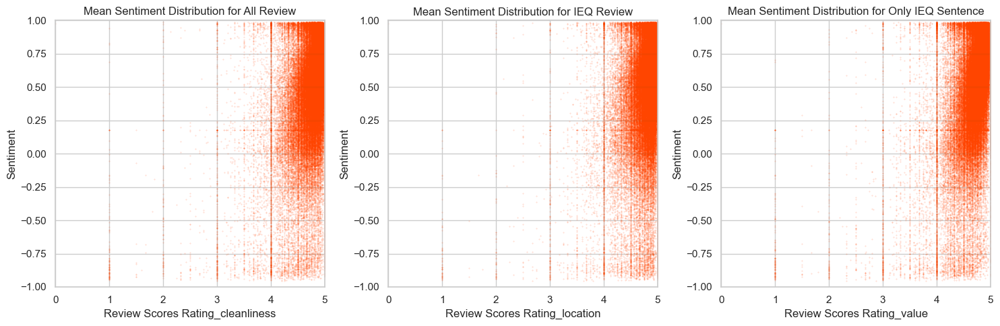

In [ ]:
ieq_df_ss_rating_1 = ieq_df_ss.groupby(['id'])['review_scores_cleanliness'].mean().reset_index()
ieq_df_ss_merged_1 = pd.merge(ieq_df_ss_merged, ieq_df_ss_rating_1, on='id', how='left')

ieq_df_ss_rating_2 = ieq_df_ss.groupby(['id'])['review_scores_location'].mean().reset_index()
ieq_df_ss_merged_1 = pd.merge(ieq_df_ss_merged_1, ieq_df_ss_rating_2, on='id', how='left')

ieq_df_ss_rating_3 = ieq_df_ss.groupby(['id'])['review_scores_value'].mean().reset_index()
ieq_df_ss_merged_1 = pd.merge(ieq_df_ss_merged_1, ieq_df_ss_rating_3, on='id', how='left')

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.scatter(ieq_df_ss_rating_1['review_scores_cleanliness'], ieq_df_ss_merged_1['Sentiment_ieq_0'].values, s=0.1, alpha=0.3, color='#FF4500')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for All Review')
plt.xlabel('Review Scores Rating_cleanliness')
plt.ylabel('Sentiment')

plt.subplot(1, 3, 2)
plt.scatter(ieq_df_ss_merged_1['review_scores_location'], ieq_df_ss_merged_1['Sentiment_ieq_0'].values, s=0.1, alpha=0.3, color='#FF4500')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for IEQ Review')
plt.xlabel('Review Scores Rating_location')
plt.ylabel('Sentiment')

plt.subplot(1, 3, 3)
plt.scatter(ieq_df_ss_merged_1['review_scores_value'], ieq_df_ss_merged_1['Sentiment_ieq_0'].values, s=0.1, alpha=0.3, color='#FF4500')
plt.xlim(0, 5)
plt.ylim(-1, 1)
plt.title('Mean Sentiment Distribution for Only IEQ Sentence')
plt.xlabel('Review Scores Rating_value')
plt.ylabel('Sentiment')

plt.tight_layout()
plt.show() # 별점 열에 상관없이 비슷한 분포를 보임

### 5.1.4. 별점별 IEQ리뷰는 어떤 차이가 있을까?
0~5점 사이의 별점마다 IEQ 관련 내용을 파악하고 비교한다
- 별점별 IEQ 리뷰 내용
- 별점별 IEQ 단어 빈도수


In [ ]:
print("별점별 리뷰 수")
print(f"\n0 이상 1 미만: {ieq_df[ieq_df['review_scores_rating'] < 1].shape[0]}")
print(f"1 이상 2 미만: {ieq_df[ieq_df['review_scores_rating'] < 2].shape[0]}")
print(f"2 이상 3 미만: {ieq_df[(ieq_df['review_scores_rating'] >= 2) & (ieq_df['review_scores_rating'] < 3)].shape[0]}")
print(f"3 이상 4 미만: {ieq_df[(ieq_df['review_scores_rating'] >= 3) & (ieq_df['review_scores_rating'] < 4)].shape[0]}")
print(f"4 이상 5 미만: {ieq_df[(ieq_df['review_scores_rating'] >= 4) & (ieq_df['review_scores_rating'] <= 5)].shape[0]}")

별점별 리뷰 수

0 이상 1 미만: 0
1 이상 2 미만: 186
2 이상 3 미만: 270
3 이상 4 미만: 3651
4 이상 5 미만: 1771155


In [ ]:
# 별점이 1 이상 2 미만인 IEQ 리뷰
ieq_star_12 = ieq_df[ieq_df['review_scores_rating'] < 2]
ieq_star_12['comments'].sample(3)

1081731    My favorite thing about living here was when I got to check out. I had an absolutely terrible experience here. <br/>First make sure you pack earplugs because other tenants in the apartment and the building do not follow the quiet hours listed. Then upstairs tenants would frequent throw parties/gatherings starting at 10 pm.<br/>Second, if you are planning to have a long stay and are going to be cooking for yourself make sure to bring baking items. The kitchen is very sparsely stocked with only the absolute basics provided.<br/>Third, do not come this is apartment if you are looking for a smoke free environment. One of the other tenants smokes inside the apartment, and despite multiple communication with the host and Airbnb nothing was done about the situation (and I have the email correspondences to prove it). I have a medical condition in which it is important that I'm not around second hand smoke, and even mentioning this to the host didn't prompt them to take any actual ac

In [ ]:
# 별점이 2 이상 3 미만인 IEQ 리뷰
ieq_star_23 = ieq_df[(ieq_df['review_scores_rating'] >= 2) & (ieq_df['review_scores_rating'] < 3)]
ieq_star_23['comments'].sample(3)

985396     Won’t stay here again.<br/>No street parking so I had to park in the narrow driveway. Passengers had to climb out on the driver’s side. Unable to open their doors of a standard-sized car. Backing out is difficult without guidance due to the obstructed views on both sides. Street traffic moves quickly.<br/>Not well kept. Dust everywhere. I could write with my finger in the dust even on the wall mirrors. The floors needed sweeping. Bed sheets and pillow cases were taken off but were not replaced with new ones. Unfolded blankets and pillows were thrown on a chair. Chose not to use. Unsure if anything was clean. Luckily, we had our own.<br/>Bath towels were used and in a pile on the floor. Again, we used our own towels and soap. Restroom waste basket was full. No amenities except toilet paper and shampoo.<br/>Inside the fridge and kitchen was dirty. <br/>The pictures posted on AirBnb do not match the house. Side door can be pushed open from outside even when locked.<br/>List goe

In [ ]:
# 별점이 3 이상 4 미만인 IEQ 리뷰
ieq_star_34 = ieq_df[(ieq_df['review_scores_rating'] >= 3) & (ieq_df['review_scores_rating'] < 4)]
ieq_star_34['comments'].sample(3)

9545267                                                                                                                                                               This was the perfect location for my first trip to Boston!! It is in a very nice area and the place was very quiet and clean. I would recommend anyone visiting Boston to stay here! The host was very easy to communicate with as well and were very accommodating to all my needs. 10/10!!
5845813                                                                                                                                                                                                                                                One block from the hospital- noisy evenings. Lots of termite damage. Mice in the walls. Dead electrical wall outlets (from the mice). A water leak in the ceiling. The house may not be structurally sound.
1499586    I had cockroaches in the kitchen crawling and dead roaches around the house. Disgusting

In [ ]:
# 별점이 4 이상인 IEQ 리뷰
ieq_star_45 = ieq_df[(ieq_df['review_scores_rating'] >= 4) & (ieq_df['review_scores_rating'] <= 5)]
ieq_star_45['comments'].sample(3)

5952377    The location was exceptional as there were plenty of places to shop, eat, and hang out. The home itself was beautiful, cozy and the check-in process was a breeze! I definitely recommend having a stay. As for the hosts, they were very welcoming and went above and beyond to make sure our stay was comfortable. They responded quickly to any inquiries we may have had and were always willing to help. Thank you Matt, Chris, and John!
3937154                                                                                             Loved this place! It’s by the highway, so a little loud, and my mattress had a slight dip on one side. That said Blanca and her co-hosts were so awesome! The place was immaculate, the other guests were lovely, and I very much enjoyed my stay. My only sadness is that I was too busy to enjoy the beautiful backyard! Will definitely be back :)
5888710                                                                                                             

In [ ]:
ieq_star_1234 = ieq_df[ieq_df['review_scores_rating'] < 4]

In [ ]:
print_ieq_category_keywords_frequency(ieq_star_1234, ieq_category_keywords)

Top 10 IEQ Keywords for Thermal Category:
ac: 507
cold: 243
heat: 167
warm: 94
air conditioning: 89
temperature: 83
sticky: 68
air conditioner: 45
freezing: 36
humid: 19

Top 10 IEQ Keywords for IAQ Category:
smell: 481
mold: 214
dust: 175
smoke: 157
dusty: 135
musty: 64
smelly: 61
breeze: 55
dry: 50
ventilation: 31

Top 10 IEQ Keywords for Visual Category:
dark: 122
bright: 69
lighting: 58
lamp: 33
shady: 23
dim: 11
natural light: 10
no window: 9
bright light: 5
small window: 5

Top 10 IEQ Keywords for Acoustic Category:
quiet: 815
loud: 462
noise: 443
hear: 336
noisy: 303
heard: 148
sound: 107
squeaky: 21
silent: 12
beeping: 11



In [ ]:
# 찾고 싶은 별점 데이터와 단어 설정
data = ieq_star_1234
target_word = 'ac'

# 강조된 리뷰 3개 출력
highlighted_reviews = highlight_word_in_reviews(data, target_word, '\033[41m')
for review in highlighted_reviews:
    print(review)

no ac , noise from downstairs club all night
Try Mitch’s Seafood one block away! The ac/radiator leaks, the bathroom/shower faucet was broken but I got it to work after messing with it. The bathroom window doesn’t shut completely which added to the noise/ chilly temp but it was not too bad with heat on. The kitchenette sink didn’t drain well but it was convenient to have a stovetop and mini fridge! All in all friendly employees but hard to reach at times. Recommend for travelers on a budget! $10 Lyft to the airport!
We had an amazing time. House is in great location and views are amazing.  The rooms were great. The first floor did need a little extra cleaning. You definitely need ac  for hot days. Nights were uncomfortable.


In [ ]:
# 각 IEQ 카테고리별 키워드 합산 계산
ieq_category_counts = sum_ieq_category_counts([ieq_star_12, ieq_star_23, ieq_star_34, ieq_star_45], ieq_category_keywords)

# 키워드 합산 시각화
plt.figure(figsize=(10, 6))
plt.bar(ieq_category_counts.keys(), ieq_category_counts.values(), color=[category_colors[category] for category in ieq_category_counts.keys()])
plt.title('Total Frequency of IEQ Keywords by Category')
plt.xlabel('Category')
plt.ylabel('Total Frequency')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# 각 데이터프레임과 IEQ 카테고리 키워드를 입력받아 각 카테고리별 키워드 빈도수를 계산하는 함수
def sum_ieq_category_counts(dataframes, category_keywords):
    ieq_category_counts = {category: Counter() for category in category_keywords}
    for df in dataframes:
        for category, keywords in category_keywords.items():
            category_counter = count_ieq_keywords(df, keywords)
            ieq_category_counts[category] += category_counter
    return ieq_category_counts

# 각 IEQ 카테고리의 키워드 리스트
ieq_category_keywords = {
    'Thermal': thermal_keywords,
    'IAQ': iaq_keywords,
    'Visual': visual_keywords,
    'Acoustic': acoustic_keywords,
}

# 각 데이터프레임별 키워드 빈도수 계산
ieq_star_12_counts = sum_ieq_category_counts([ieq_star_12], ieq_category_keywords)
ieq_star_23_counts = sum_ieq_category_counts([ieq_star_23], ieq_category_keywords)
ieq_star_34_counts = sum_ieq_category_counts([ieq_star_34], ieq_category_keywords)
ieq_star_45_counts = sum_ieq_category_counts([ieq_star_45], ieq_category_keywords)

# 그래프 그리기
fig, axes = plt.subplots(1, 4, figsize=(28, 6))

for ax, counts, title in zip(axes, [ieq_star_12_counts, ieq_star_23_counts, ieq_star_34_counts, ieq_star_45_counts], ["ieq_star_12", "ieq_star_23", "ieq_star_34", "ieq_star_45"]):
    ax.bar(counts.keys(), counts.values(), color=[category_colors[category] for category in counts.keys()])
    ax.set_title(f'Total Frequency of IEQ Keywords by Category ({title})')
    ax.set_xlabel('Category')
    ax.set_ylabel('Total Frequency')
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

## 5.2. IEQ와 가격 보기
IEQ 리뷰들과 가격 사이의 관계를 분석한다

### 5.2.1. 가격 분포 보기

In [ ]:
ieq_df = ieq_df.reset_index(drop=True)

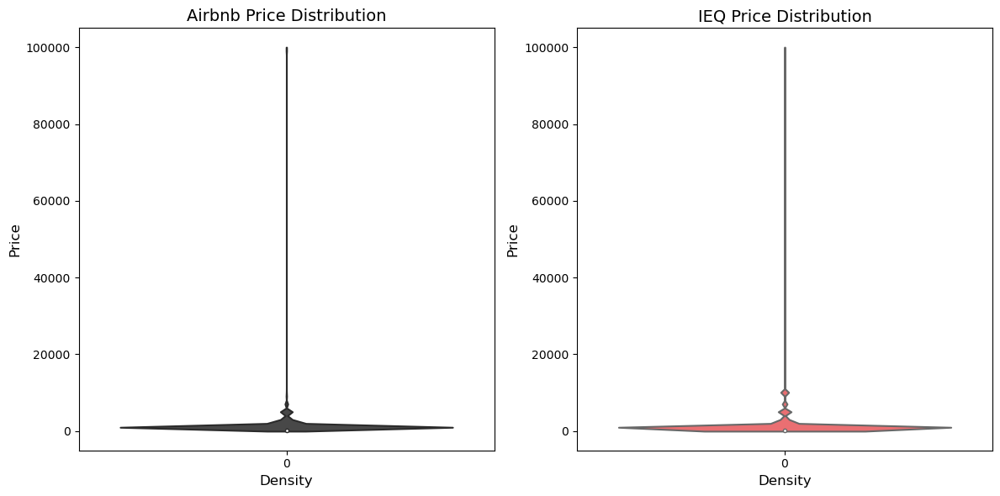

In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.violinplot(airbnb_df['price'], color='#484848')
plt.title('Airbnb Price Distribution', fontsize=14)
plt.xlabel('Density', fontsize=12)
plt.ylabel('Price', fontsize=12)

plt.subplot(1, 2, 2)
sns.violinplot(ieq_df['price'], color='#FF5A5F')
plt.title('IEQ Price Distribution', fontsize=14)
plt.xlabel('Density', fontsize=12)
plt.ylabel('Price', fontsize=12)

plt.tight_layout()
plt.show() # 숙소 가격 분포도 매우 치우쳐져 있음

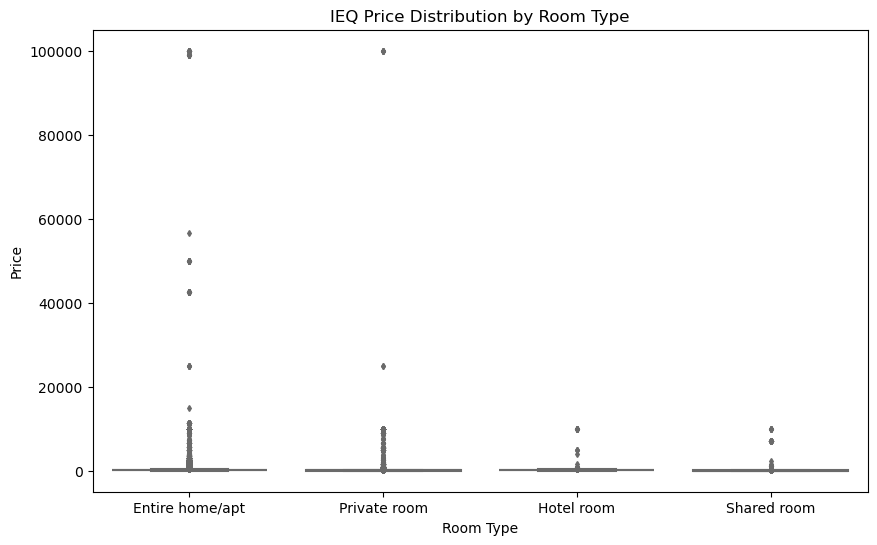

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

sns.boxplot(
    data=ieq_df,
    x="room_type",
    y="price",
    palette="Set3",
    fliersize=3.0,
)

ax.set_title("IEQ Price Distribution by Room Type")
ax.set_xlabel("Room Type")
ax.set_ylabel("Price")

plt.show()

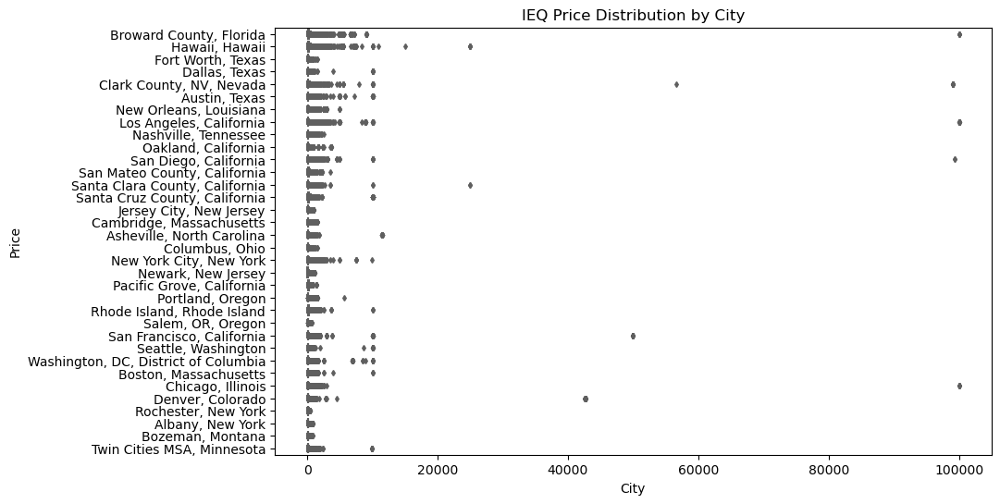

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(
    data=ieq_df,
    x="price",
    y="City",
    palette="Set3",
    fliersize=3.0,
)

plt.title("IEQ Price Distribution by City")
plt.xlabel("City")
plt.ylabel("Price")

plt.show()

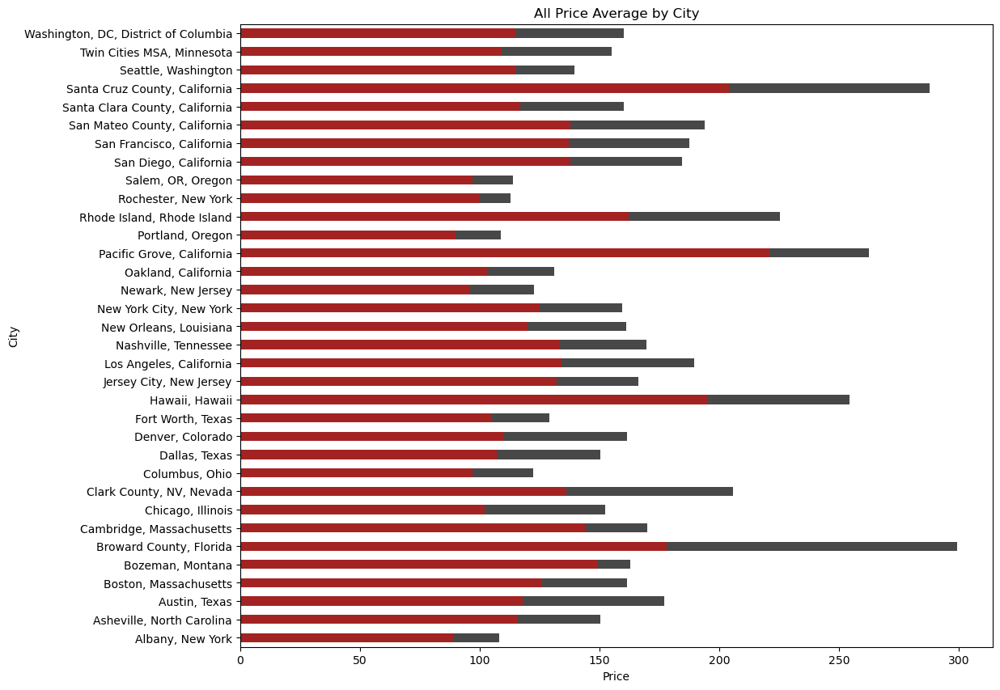

In [ ]:
fig, ax = plt.subplots(figsize=(12, 10))
airbnb_df.groupby('City')['price'].mean().plot(kind='barh', color='#484848')
airbnb_df.groupby('City')['price'].median().plot(kind='barh', color='red', alpha=0.5)
plt.title('All Price Average by City')
plt.xlabel('Price')
plt.ylabel('City')
plt.show()

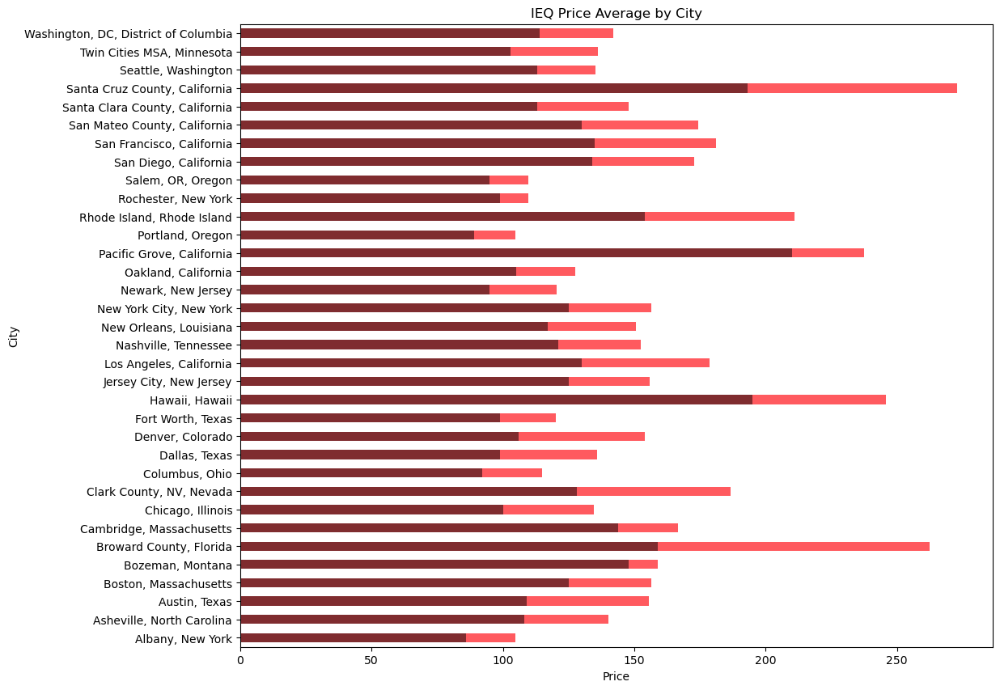

In [ ]:
fig, ax = plt.subplots(figsize=(12, 10))
ieq_df.groupby('City')['price'].mean().plot(kind='barh', color='#FF5A5F')
ieq_df.groupby('City')['price'].median().plot(kind='barh', color='black', alpha=0.5)
plt.title('IEQ Price Average by City')
plt.xlabel('Price')
plt.ylabel('City')
plt.show()

In [ ]:
!pip install folium

In [ ]:
import folium
from folium.plugins import MeasureControl, Fullscreen, MiniMap, Draw, MousePosition

city_coords = airbnb_df.groupby('City')[['latitude', 'longitude']].mean().reset_index()
city_prices = airbnb_df.groupby('City')['price'].agg(['mean', 'median']).reset_index()
city_zones = airbnb_df[['City', 'Zone']].drop_duplicates()
city_reviews = airbnb_df['City'].value_counts().reset_index()
city_reviews.columns = ['City', 'reviews']

city_data = pd.merge(city_coords, city_prices, on='City')
city_data = pd.merge(city_data, city_zones, on='City')
city_data = pd.merge(city_data, city_reviews, on='City')
city_data['rank'] = city_data['median'].rank(ascending=False).astype(int)

zone_colors = {
    1: '#FF4500',
    2: '#FFA500',
    3: '#FFFF00',
    4: '#00FF00',
    5: '#87CEEB',
    6: '#4682B4'
}

m = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

max_reviews = city_data['reviews'].max()
min_reviews = city_data['reviews'].min()

def calculate_marker_size(reviews, min_reviews, max_reviews):
    return 5 + 10 * (reviews - min_reviews) / (max_reviews - min_reviews)

for _, row in city_data.iterrows():
    city = row['City']
    zone = row['Zone']
    lat = row['latitude']
    lon = row['longitude']
    avg_price = row['mean']
    median_price = row['median']
    reviews = row['reviews']
    rank = row['rank']

    popup_html = f"""
    <div style="width: 150px;">
        <strong>{city} </strong><br>
        Zone: ({zone}) <br>
        Average Price: ${avg_price:.2f}<br>
        Median Price: ${median_price:.2f}<br>
        Rank: {rank}<br>
        Reviews: {reviews}
    </div>
    """

    marker_size = calculate_marker_size(reviews, min_reviews, max_reviews)

    color = zone_colors.get(zone, '#000000')

    folium.CircleMarker(
        location=[lat, lon],
        radius=marker_size,
        color=color,
        fill=True,
        fill_opacity=1,
        popup=folium.Popup(popup_html, max_width=300),
        tooltip=city,
        opacity=1
    ).add_to(m)

folium.LayerControl().add_to(m)
m.add_child(MeasureControl())
Fullscreen().add_to(m)
MiniMap().add_to(m)
Draw().add_to(m)
MousePosition().add_to(m)

m

### 5.2.2. 가격에 따라 IEQ 리뷰는 어떤 차이가 있을까?
가격과 IEQ 리뷰 사이의 관계를 분석하며 다음 질문들에 답한다
1. 가격이 비싼 건물의 IEQ 리뷰는 긍정적일까?
2. 어떤 IEQ 요인이 가격에 영향을 미칠까?

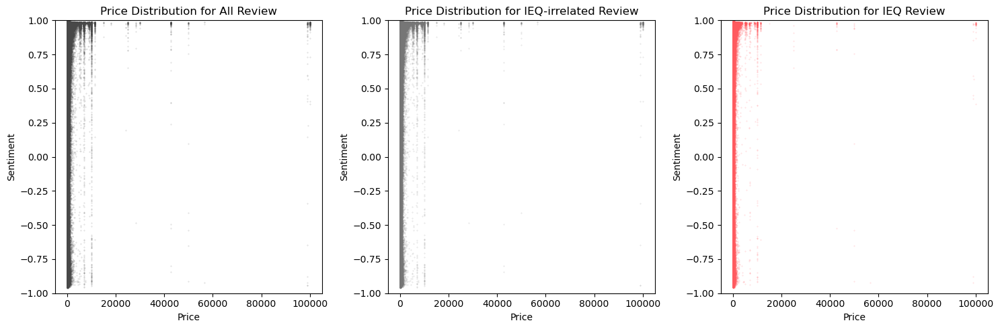

In [ ]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.scatter(airbnb_df['price'].values, airbnb_df['Sentiment_0'].values, s=0.1, alpha=0.3, color='#484848')
plt.ylim(-1, 1)
plt.title('Price Distribution for All Review')
plt.xlabel('Price')
plt.ylabel('Sentiment')

plt.subplot(1, 3, 2)
plt.scatter(non_ieq_df['price'].values, non_ieq_df['Sentiment_0'].values, s=0.1, alpha=0.3, color='#767676')
plt.ylim(-1, 1)
plt.title('Price Distribution for IEQ-irrelated Review')
plt.xlabel('Price')
plt.ylabel('Sentiment')

plt.subplot(1, 3, 3)
plt.scatter(ieq_df['price'].values, ieq_df['Sentiment_0'].values, s=0.1, alpha=0.3, color='#FF5A5F')
# plt.xlim(0, 10000)
plt.ylim(-1, 1)
plt.title('Price Distribution for IEQ Review')
plt.xlabel('Price')
plt.ylabel('Sentiment')

plt.tight_layout()
plt.show() # 전체적으로 가격에 상관없이 고른 감정 분포를 볼 수 있다

In [ ]:
airbnb_df['price'].quantile([0.10, 0.5, 0.90]) # 비싼 정도를 임의로 정하기 위해 상위 90% 가격 알아보기

0.1     66.0
0.5    130.0
0.9    321.0
Name: price, dtype: float64

In [ ]:
expensive_airbnb_df = airbnb_df[airbnb_df['price']>=321]
expensive_ieq_df = ieq_df[ieq_df['price']>=321]

In [ ]:
print(f"비싼 가격의 숙소 중 부정적인 리뷰의 비율은 {round(expensive_airbnb_df[expensive_airbnb_df['Sentiment_0']<0 ].shape[0] / expensive_airbnb_df['Sentiment_0'].shape[0],4)}")
print(f"IEQ 리뷰를 담고 있는 비싼 가격의 숙소 중 부정적인 리뷰의 비율은 {round(expensive_ieq_df[expensive_ieq_df['Sentiment_0']<0].shape[0] / expensive_ieq_df['Sentiment_0'].shape[0],4)}")
# 데이터 크기의 차이가 나지만 단순 비율로 비교했을때, IEQ 리뷰들을 담고 있는 비싼 숙소에서 더 많은 부정적인 리뷰들이 나왔다

비싼 가격의 숙소 중 부정적인 리뷰의 비율은 0.0176
IEQ 리뷰를 담고 있는 비싼 가격의 숙소 중 부정적인 리뷰의 비율은 0.0432


In [ ]:
print_ieq_category_keywords_frequency(expensive_airbnb_df, ieq_category_keywords)

Top 10 IEQ Keywords for Thermal Category:
warm: 14389
ac: 13018
cold: 6330
heat: 5095
air conditioning: 4644
temperature: 2820
chilly: 1365
air conditioner: 1043
humid: 812
cool off: 533

Top 10 IEQ Keywords for IAQ Category:
breeze: 10374
smell: 2636
rick: 1748
dust: 1137
dry: 1116
mold: 958
smoke: 958
dusty: 761
fresh air: 754
musty: 547

Top 10 IEQ Keywords for Visual Category:
bright: 5910
lighting: 2703
natural light: 2281
dark: 2146
lamp: 559
shady: 361
black out: 210
dim: 178
no window: 137
glow: 80

Top 10 IEQ Keywords for Acoustic Category:
quiet: 73870
noise: 12608
hear: 7435
sound: 7227
loud: 6334
noisy: 4064
heard: 2252
squeaky: 787
echo: 393
silent: 201



In [ ]:
print_ieq_category_keywords_frequency(expensive_ieq_df, ieq_category_keywords)

Top 10 IEQ Keywords for Thermal Category:
ac: 12031
warm: 5496
cold: 4365
heat: 4177
air conditioning: 2510
temperature: 2360
chilly: 902
humid: 742
air conditioner: 601
sticky: 436

Top 10 IEQ Keywords for IAQ Category:
breeze: 9626
smell: 2399
rick: 1623
dust: 1011
dry: 918
smoke: 866
mold: 850
dusty: 674
musty: 488
stuffy: 375

Top 10 IEQ Keywords for Visual Category:
bright: 5468
lighting: 2332
dark: 1877
natural light: 693
lamp: 509
shady: 319
dim: 123
black out: 104
no window: 73
bright light: 50

Top 10 IEQ Keywords for Acoustic Category:
quiet: 68878
noise: 11761
hear: 6944
sound: 6552
loud: 5901
noisy: 3840
heard: 2070
squeaky: 724
echo: 354
beeping: 190



In [ ]:
# 찾고 싶은 별점 데이터와 단어 설정
data = expensive_airbnb_df
target_word = 'quiet'

# 강조된 리뷰 3개 출력
highlighted_reviews = highlight_word_in_reviews(data, target_word, '\033[41m')
for review in highlighted_reviews:
    print(review)

Had a great stay, beautiful home with great views and a quiet private street. Natalia was very helpful at check in and during our stay. would rent again.
I stayed here with a work team, covering a convention in downtown Austin. Amber and Dennis were extremely accommodating, providing us with increased internet speed upon request, and were very responsive and thorough with answers to all our questions. Amber is very friendly and hospitable and made us feel welcome right away! We really enjoyed the proximity to downtown with the quiet of a suburban neighborhood. Thanks for a wonderful time!
We stayed for 10 days in Julie's beautiful house: it's in a beautiful and quiet street in an excellent location - a short walk to restaurants and shops on Chestnut and at the same time it's only one block from the Marina front. The house is lovely, high quality finishes and comfortable beds, laid out over 3 floors. Julie is so nice, she helped me with advice before we arrived and she'd left food in th

# 6️⃣ POE는 어렵지만 텍스트 마이닝을 통해 얻을 수 있는 정보는 뭐가 있을까?
기존 POE 방법(설문조사, 인터뷰)으로 얻기 어려운 정보들을 리뷰를 통해 찾아낸다

## 6.1. 최근 몇 주 또는 몇 달 동안 자주 언급된 IEQ 문제는 뭐가 있을까? (실시간 피드백)
POE는 종종 일정 주기마다 수행되므로 실시간으로 발생하는 문제를 즉각적으로 반영하기 어렵다

리뷰 작성 날짜를 기준으로 특정 키워드의 빈도를 시간 경과에 따라 분석한다

## 6.2. 특정 이벤트(예: 지역 축제, 공휴일 등)로 인해 발생하는 IEQ 문제를 파악하여 대처할 수 있을까? (단기 이벤트의 영향)
크리스마스 기간의 리뷰를 분석한다

In [ ]:
print_ieq_category_keywords_frequency(christmas_df, ieq_category_keywords)

Top 10 IEQ Keywords for Thermal Category:
warm: 58
cold: 23
heat: 9
temperature: 6
freezing: 6
air conditioning: 3
ac: 3
aircon: 1

Top 10 IEQ Keywords for IAQ Category:
breeze: 8
smell: 3
dry: 2
dust: 1
ventilation: 1
fresh air: 1
dingy: 1
stuffy: 1
feces: 1
mold: 1

Top 10 IEQ Keywords for Visual Category:
bright: 6
dark: 2
natural light: 2
lighting: 1
lamp: 1
no daylight: 1
no window: 1

Top 10 IEQ Keywords for Acoustic Category:
quiet: 73
noise: 14
noisy: 14
hear: 11
loud: 4
sound: 4
silent: 3
heard: 2
earplug: 2
soundproof: 1



In [ ]:
# 찾고 싶은 데이터와 단어 설정
data = christmas_df
target_word = 'christmas'

# 강조된 리뷰 3개 출력
highlighted_reviews = highlight_word_in_reviews(data, target_word, '\033[41m')
for review in highlighted_reviews:
    print(review)

For those long nights in the city, Max provided us with the necessary space to rest. The bed was very comfortable, the bathroom was very clean, and the instructions for our stay were clear as day. Really grateful for our stay through christmas eve!
Juan is a very openminded person. he made our stay in nyc very enjoyable. Told us little tips and tricks and even gave us christmas presents and write a christmas card. i would recommend juan to all my friends and everybody else. if you want a place with a warm welcome, juan is your host


{'Thermal': 112, 'Visual': 14, 'Acoustic': 139, 'IAQ': 20}


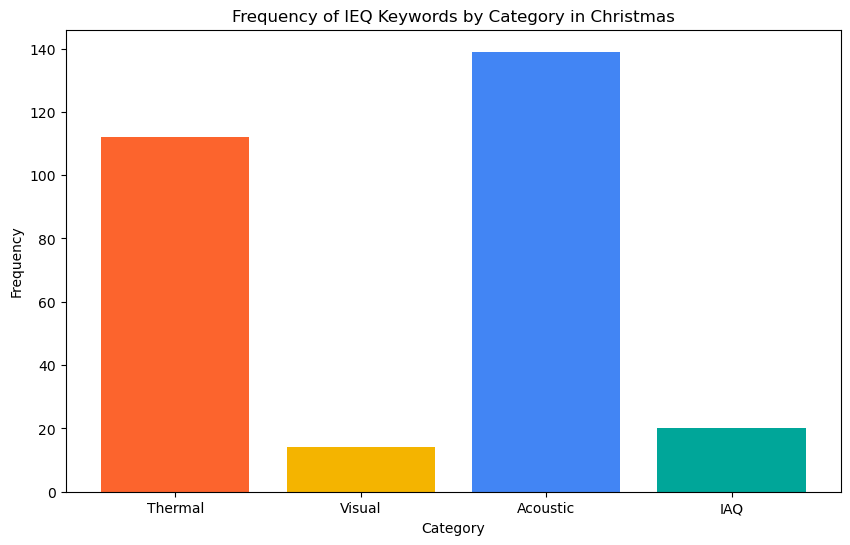

In [ ]:
ieq_category_counts = sum_ieq_category_counts([christmas_df], ieq_category_keywords)
print(ieq_category_counts)

plt.figure(figsize=(10, 6))
plt.bar(ieq_category_counts.keys(), ieq_category_counts.values(), color=[category_colors[category] for category in ieq_category_counts.keys()])
plt.title('Frequency of IEQ Keywords by Category in Christmas')
plt.xlabel('Category')
plt.ylabel('Frequency')
plt.xticks(rotation=0)
plt.show()

In [ ]:
thermal = christmas_df[(christmas_df['Thermal'] == 1) & (christmas_df['IAQ'] == 0) & (christmas_df['Visual'] == 0) & (christmas_df['Acoustic'] == 0)]
iaq = christmas_df[(christmas_df['IAQ'] == 1) & (christmas_df['Thermal'] == 0) & (christmas_df['Visual'] == 0) & (christmas_df['Acoustic'] == 0)]
visual = christmas_df[(christmas_df['Visual'] == 1) & (christmas_df['IAQ'] == 0) & (christmas_df['Thermal'] == 0) & (christmas_df['Acoustic'] == 0)]
acoustic = christmas_df[(christmas_df['Acoustic'] == 1) & (christmas_df['IAQ'] == 0) & (christmas_df['Visual'] == 0) & (christmas_df['Thermal'] == 0)]

In [ ]:
print(f'Thermal 관련 리뷰수 / 전체 IEQ 리뷰수: {(round(thermal.shape[0]/private_newYork_christmas.shape[0], 4))*100}%')
print(f'IAQ 관련 리뷰수 / 전체 IEQ 리뷰수: {(round(iaq.shape[0]/private_newYork_christmas.shape[0], 4))*100}%')
print(f'Visual 관련 리뷰수 / 전체 IEQ 리뷰수: {(round(visual.shape[0]/private_newYork_christmas.shape[0], 4))*100}%')
print(f'Acoustic 관련 리뷰수 / 전체 IEQ 리뷰수: {(round(acoustic.shape[0]/private_newYork_christmas.shape[0], 4))*100}%')
duplication = (1-(round(thermal.shape[0]/private_newYork_christmas.shape[0], 4) + round(iaq.shape[0]/private_newYork_christmas.shape[0], 4) + round(visual.shape[0]/private_newYork_christmas.shape[0], 4) + round(acoustic.shape[0]/private_newYork_christmas.shape[0], 4)))
print(f'중복 리뷰수 / 전체 IEQ 리뷰수: {round(duplication*100, 2)}%')

Thermal 관련 리뷰수 / 전체 IEQ 리뷰수: 3.3300000000000005%
IAQ 관련 리뷰수 / 전체 IEQ 리뷰수: 1.4200000000000002%
Visual 관련 리뷰수 / 전체 IEQ 리뷰수: 0.33%
Acoustic 관련 리뷰수 / 전체 IEQ 리뷰수: 7.829999999999999%
중복 리뷰수 / 전체 IEQ 리뷰수: 87.09%


In [ ]:
!pip install wordcloud

In [ ]:
from wordcloud import WordCloud, STOPWORDS

def plot_christmas_wordcloud(text, stopwords=STOPWORDS):
    christmas_colors = ["#FF0000", "#00FF00", "#FFD700", "#FFFFFF", "#0000FF"]

    def christmas_color_func(word, font_size, position, orientation, random_state=None, **kwargs):
        return np.random.choice(christmas_colors)

    wordcloud = WordCloud(
        stopwords=stopwords,
        background_color="white",
        color_func=christmas_color_func,
        font_path=None,
        contour_color='red',
        contour_width=1
    ).generate(text)

    plt.figure(figsize=(10, 10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

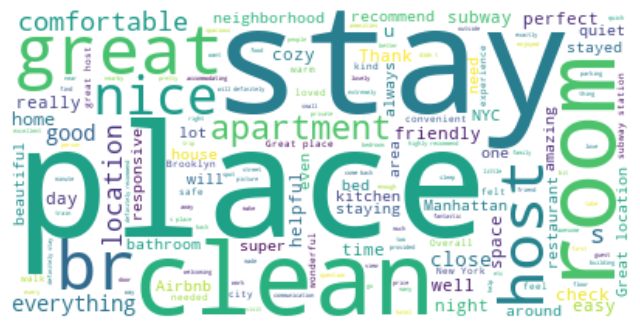

In [ ]:
text = ''.join(christmas_df['comments'].tolist())
plot_wordcloud(text)

In [ ]:
import folium
import requests

private_newYork_christmas_coords = ss[['latitude', 'longitude', 'id',
                                                              'Acoustic', 'Thermal', 'Sentiment_ieq_0', 'Sentiment_0',
                                                              'price', 'review_scores_rating']].drop_duplicates()

nyc_geojson_url = 'https://raw.githubusercontent.com/dwillis/nyc-maps/master/boroughs.geojson'
nyc_geojson = requests.get(nyc_geojson_url).json()

m = folium.Map(
    location=[private_newYork_christmas_coords['latitude'].mean(), private_newYork_christmas_coords['longitude'].mean()],
    zoom_start=10.5,
    tiles='CartoDB positron'
)

folium.GeoJson(
    nyc_geojson,
    name='geojson',
    style_function=lambda feature: {
        'color': '#00FF00',
        'weight': 2,
        'fillOpacity': 0.1
    }
).add_to(m)
for _, row in private_newYork_christmas_coords.iterrows():
    lat = row['latitude']
    lon = row['longitude']
    sentiment = row['Sentiment_0']
    ieq_sentiment = row['Sentiment_ieq_0']
    price = row['price']
    score = row['review_scores_rating']
    id = int(row['id'])

    if row['Acoustic'] == 1 and row['Thermal'] == 1:
        color = '#000000'
    elif row['Acoustic'] == 1:
        color = '#4285F4'
    elif row['Thermal'] == 1:
        color = '#FC642D'
    else:
        color = 'gray'

    popup_text = f"""
    ID: {id}<br>
    Price: ${price}<br>
    Score: ★{score}<br>
    Sentiment: {round(sentiment,4)}<br>
    IEQ Sentiment: {round(ieq_sentiment,4)}
    """

    marker = folium.CircleMarker(
        location=[lat, lon],
        radius=4,
        color=color,
        fill=True,
        fill_opacity=0.7
    ).add_child(folium.Popup(popup_text, max_width=500))

    m.add_child(marker)

folium.LayerControl().add_to(m)

m

In [ ]:
import folium
import requests

private_newYork_christmas_coords = ss.drop_duplicates()

nyc_geojson_url = 'https://raw.githubusercontent.com/dwillis/nyc-maps/master/boroughs.geojson'
nyc_geojson = requests.get(nyc_geojson_url).json()

m = folium.Map(
    location=[private_newYork_christmas_coords['latitude'].mean(), private_newYork_christmas_coords['longitude'].mean()],
    zoom_start=10.5,
    tiles='CartoDB positron'
)

folium.GeoJson(
    nyc_geojson,
    name='geojson',
    style_function=lambda feature: {
        'color': '#00FF00',
        'weight': 2,
        'fillOpacity': 0.1
    }
).add_to(m)
a = 0
b = 0
c = 0
d = 0
for _, row in private_newYork_christmas_coords.iterrows():
    lat = row['latitude']
    lon = row['longitude']
    sentiment = row['Sentiment_0']
    ieq_sentiment = row['Sentiment_ieq_0']
    price = row['price']
    score = row['review_scores_rating']
    id = int(row['id'])
    comments = row['comments'].strip()

    if row['Sentiment_ieq_0'] < 0.1:
        d+=1
        if row['Acoustic'] == 1 and row['Thermal'] == 1:
            color = '#000000'
            a += 1
        elif row['Acoustic'] == 1:
            color = '#4285F4'
            b+=1
        elif row['Thermal'] == 1:
            color = '#FC642D'
            c+=1
        else:
            color = 'gray'

        popup_text = f"""
        Date: {row['date'].year}-{row['date'].month}-{row['date'].day}<br>
        ID: {id}<br>
        Price: ${price}<br>
        Score: ★{score}<br>
        Sentiment: {round(sentiment,4)}<br>
        IEQ Sentiment: {round(ieq_sentiment,4)}
        <br>
        Comments: <br>
        {comments}
        """

        marker = folium.CircleMarker(
            location=[lat, lon],
            radius=4,
            color=color,
            fill=True,
            fill_opacity=0.7
        ).add_child(folium.Popup(popup_text, max_width=600))

        m.add_child(marker)

folium.LayerControl().add_to(m)


m

In [ ]:
christmas_df[christmas_df['id'] == 53051569]['comments'].values

array(['Very well located. Humble room in the basement. Great for a short stay in NYC. One negative point: poor isolation, so the room is cold at night in the winter (Gilbert provided extra blanket).'],
      dtype=object)

In [ ]:
import folium
import requests

private_newYork_christmas_coords = ss.drop_duplicates()

nyc_geojson_url = 'https://raw.githubusercontent.com/dwillis/nyc-maps/master/boroughs.geojson'
nyc_geojson = requests.get(nyc_geojson_url).json()

m = folium.Map(
    location=[private_newYork_christmas_coords['latitude'].mean(), private_newYork_christmas_coords['longitude'].mean()],
    zoom_start=10.5,
    tiles='OpenStreetMap'
)

folium.GeoJson(
    nyc_geojson,
    name='geojson',
    style_function=lambda feature: {
        'color': '#00FF00',
        'weight': 2,
        'fillOpacity': 0.1
    }
).add_to(m)

a = 0
for _, row in private_newYork_christmas_coords.iterrows():
    lat = row['latitude']
    lon = row['longitude']
    sentiment = row['Sentiment_0']
    ieq_sentiment = row['Sentiment_ieq_0']
    price = row['price']
    score = row['review_scores_rating']
    id = int(row['id'])
    comments = row['comments'].strip()

    if row['Sentiment_ieq_0'] < 0.1:
        if row['Acoustic'] == 1 and row['Thermal'] == 1:
            color = '#000000'
            a += 1
        elif row['Acoustic'] == 1:
            color = '#4285F4'
        elif row['Thermal'] == 1:
            color = '#FC642D'
        else:
            pass

        popup_text = f"""
        ID: {id}<br>
        Price: ${price}<br>
        Score: ★{score}<br>
        Sentiment: {round(sentiment,4)}<br>
        IEQ Sentiment: {round(ieq_sentiment,4)}
        <br>
        Comments: <br>
        {comments}
        """

        marker = folium.CircleMarker(
            location=[lat, lon],
            radius=3,
            color=color,
            fill=True,
            fill_opacity=0.7
        ).add_child(folium.Popup(popup_text, max_width=600))

        m.add_child(marker)

folium.LayerControl().add_to(m)


m

## 6.3. 사용자 추천 개선사항은 뭐가 있을까?
'recommend' 또는 'suggest'와 같은 단어가 포함된 리뷰를 분석하여 사용자들이 직접 제안하는 개선사항을 반영할 수 있다

In [ ]:
# 찾고 싶은 별점 데이터와 단어 설정
data = private_newYork_christmas
target_word = 'recommend'

# 강조된 리뷰 3개 출력
highlighted_reviews = highlight_word_in_reviews(data, target_word, '\033[41m')
for review in highlighted_reviews:
    print(review)

The apartment is good maintained overall but the room we stayed in was not well insulated. The heating system in the room did not work (One heater  was working but it was almost of no use due to the bad insulation). The other door in the room is directly connected to outside and cold air was coming from all 2 windows and a big door. We couldn’t sleep well enough because air we breathe was too cold. Even floor was like an ice. My partner and I did not feel like we were sleeping inside of house. It more felt like a bunker. If anyone is planning to stay in this room (especially) alone, I do not recommend to stay in this room in such a cold weather.
We stayed overnight in Chijioke’s lovely place. Generally it is clean and cozy. The bed is very comfortable. However, It would be great to include a small chair for additional guest. We could not find the hair dryer. The most complaint I have is the annoying noise possibly from the pipes that provide the heat. It is not easy to get sleep with t

In [ ]:
# 찾고 싶은 별점 데이터와 단어 설정
data = private_newYork_christmas
target_word = 'suggest'

# 강조된 리뷰 3개 출력
highlighted_reviews = highlight_word_in_reviews(data, target_word, '\033[41m')
for review in highlighted_reviews:
    print(review)

Nice tidy and quiet place! Always suggest it
<br/>It's quite noisy outside during the night,besides this little tiny thing, everything was great!
